### Choose reference image and contact points

Reference image name: 2ed752a96e55398928beb1ac60ef8914_0rgb


<IPython.core.display.Javascript object>


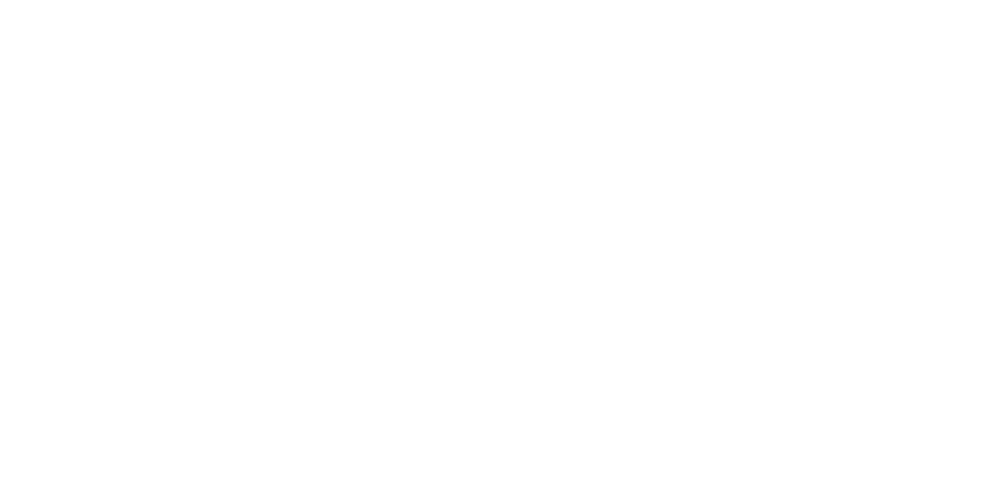

In [1]:
import glob
import os
import numpy as np
import matplotlib.pyplot as plt
import scipy.io as sio
import cv2

np.random.seed(1)

root_path = 'pwarpc_generate_data'
split = 'train'
cls = 'bottle'
cam_id = 0

img_list = glob.glob(os.path.join(root_path,split,cls,f'*_{cam_id}rgb.png'))
ref_img_path = np.random.choice(img_list,1)[0]
ref_img_name = os.path.basename(ref_img_path).split('.')[0]
ref_mask_path = ref_img_path.replace('rgb','mask')

print('Reference image name:', ref_img_name)

ref_img = cv2.imread(ref_img_path, 1)[:, :, ::- 1]

%matplotlib notebook
fig = plt.figure(figsize=(8, 4))
plt.imshow(ref_img)
plt.axis('off')
plt.show()


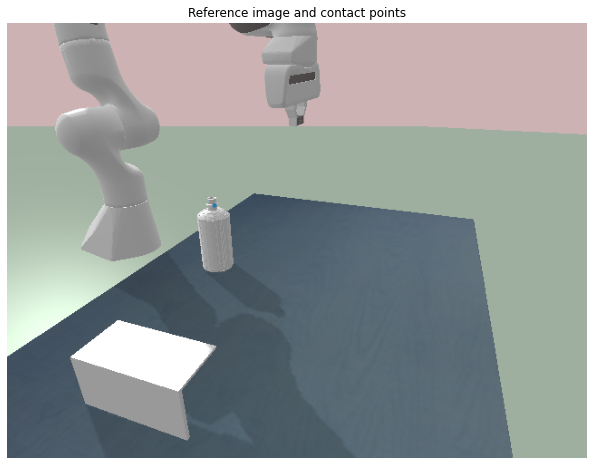

{'img_name': '2ed752a96e55398928beb1ac60ef8914_0rgb', 'contact_pts': array([[227.5, 200. ]])}
Saved!


In [2]:
ref_contact_pts = np.array([[227.5,200]])

%matplotlib inline
fig = plt.figure(figsize=(16, 8))
plt.imshow(ref_img)
plt.scatter(ref_contact_pts[:,0],ref_contact_pts[:,1],s = 10)
plt.axis('off')
plt.title('Reference image and contact points')
plt.show()

ref_info = dict()
ref_info['img_name'] = ref_img_name
ref_info['contact_pts'] = ref_contact_pts
print(ref_info)

save_dir = os.path.join(root_path,cls+'_pts')
if not os.path.isdir(save_dir):
    os.mkdir(save_dir)
save_path = os.path.join(save_dir,'ref_info.mat')
sio.savemat(save_path, ref_info)
print('Saved!')

 ### Some functions prepared for matching


In [3]:
model = 'PWarpCSFNet_WS'
pretrained = 'pfpascal'

In [4]:
from utils_flow.pixel_wise_mapping import remap_using_flow_fields
import cv2
from model_selection import select_model
from utils_flow.util_optical_flow import flow_to_image
from utils_flow.visualization_utils import overlay_semantic_mask,make_sparse_matching_plot
from test_models import crop_image_according_to_mask, boolean_string,pad_to_same_shape
import numpy as np
from validation.test_parser import define_model_parser, define_pdcnet_parser
from validation.utils import matches_from_flow
import argparse
import torch

crop_image_from_mask = crop_image_according_to_mask

def test_model_on_image_pair(args, query_image, reference_image,contact_pixels = None, visualize = True):
    with torch.no_grad():
        network, estimate_uncertainty = select_model(
            args.model, args.pre_trained_model, args, args.optim_iter, local_optim_iter,
            path_to_pre_trained_models=args.path_to_pre_trained_models)

        # save original ref image shape
        ref_image_shape = reference_image.shape[:2]

        # pad both images to the same size, to be processed by network
        query_image_, reference_image_ = pad_to_same_shape(query_image, reference_image)
        # convert numpy to torch tensor and put it in right format
        query_image_ = torch.from_numpy(query_image_).permute(2, 0, 1).unsqueeze(0)
        reference_image_ = torch.from_numpy(reference_image_).permute(2, 0, 1).unsqueeze(0)

        # ATTENTION, here source and target images are Torch tensors of size 1x3xHxW, without further pre-processing
        # specific pre-processing (/255 and rescaling) are done within the function.

        # pass both images to the network, it will pre-process the images and ouput the estimated flow
        # in dimension 1x2xHxW
        if estimate_uncertainty:
            if args.flipping_condition:
                raise NotImplementedError('No flipping condition with PDC-Net for now')

            estimated_flow, uncertainty_components = network.estimate_flow_and_confidence_map(query_image_,
                                                                                              reference_image_,
                                                                                              mode='channel_first')
            confidence_map = uncertainty_components['p_r'].squeeze().detach().cpu().numpy()
            confidence_map = confidence_map[:ref_image_shape[0], :ref_image_shape[1]]
        else:
            if args.flipping_condition and 'GLUNet' in args.model:
                estimated_flow = network.estimate_flow_with_flipping_condition(query_image_, reference_image_,
                                                                               mode='channel_first')
            else:
                estimated_flow = network.estimate_flow(query_image_, reference_image_, mode='channel_first')
        estimated_flow_numpy = estimated_flow.squeeze().permute(1, 2, 0).cpu().numpy()
        estimated_flow_numpy = estimated_flow_numpy[:ref_image_shape[0], :ref_image_shape[1]]
        # removes the padding

        warped_query_image = remap_using_flow_fields(query_image, estimated_flow_numpy[:, :, 0],
                                                     estimated_flow_numpy[:, :, 1]).astype(np.uint8)

        if estimate_uncertainty:
            color = [255, 102, 51]
            fig, axis = plt.subplots(1, 5, figsize=(30, 30))

            confident_mask = (confidence_map > 0.50).astype(np.uint8)
            confident_warped = overlay_semantic_mask(warped_query_image, ann=255 - confident_mask*255, color=color)
            axis[2].imshow(confident_warped)
            axis[2].set_title('Confident warped query image according to \n estimated flow by {}_{}'
                              .format(args.model, args.pre_trained_model))
            axis[4].imshow(confidence_map, vmin=0.0, vmax=1.0)
            axis[4].set_title('Confident regions')
        else:
            contact_pts_matching, query_pts = match_contact_points(query_image, reference_image,estimated_flow,contact_pixels)
            fig, axis = plt.subplots(1, 5, figsize=(30, 30))
            axis[2].imshow(warped_query_image)
            axis[2].set_title(
                'Warped query image according to estimated flow by {}_{}'.format(args.model, args.pre_trained_model))
        axis[0].imshow(query_image)
        axis[0].set_title('Query image')
        axis[1].imshow(reference_image)
        axis[1].set_title('Reference image')

        axis[3].imshow(flow_to_image(estimated_flow_numpy))
        axis[3].set_title('Estimated flow {}_{}'.format(args.model, args.pre_trained_model))

        axis[-1].imshow(contact_pts_matching)
        axis[-1].set_title('Contact points matching')
        
        if visualize:
            plt.show()
            
        plt.close(fig)
        return estimated_flow,query_pts

def match_contact_points(query_image,reference_image,estimated_flow,contact_pixels):
    mask = np.zeros(estimated_flow.shape[-2:], dtype=int)[np.newaxis, ...]
    mask_indices = contact_pixels.astype(int)[:, [1, 0]]  # (x,y) -> (row, col)
    mask[:, mask_indices[:, 0], mask_indices[:, 1]] = 1
    mask = torch.tensor(mask, device=estimated_flow.device) == 1
    # print(estimated_flow.shape)
    # print(mask.shape)
    mkpts_q, mkpts_r = matches_from_flow(estimated_flow, mask)
    # print(mkpts_q)
    # print(mkpts_r)

    confidence_values = np.ones(mkpts_q.shape[0])
    import matplotlib.cm as cm
    color = cm.jet(confidence_values)
    out = make_sparse_matching_plot(
        query_image, reference_image, mkpts_q, mkpts_r, color, margin=10)

    # plt.figure(figsize=(16, 8))
    # plt.imshow(out)
    # plt.show()
    return out,mkpts_q

parser = argparse.ArgumentParser(description='Test models on a pair of images')
parser.add_argument('--model', type=str, default = model,
                        help='Model to use')
parser.add_argument('--flipping_condition', default=False, type=boolean_string,
                    help='Apply flipping condition for semantic data and GLU-Net-based networks? ')
parser.add_argument('--optim_iter', type=int, default=3,
                    help='number of optim iter for global GOCor, when applicable')
parser.add_argument('--local_optim_iter', dest='local_optim_iter', type=int, default=None,
                    help='number of optim iter for local GOCor, when applicable')
parser.add_argument('--path_to_pre_trained_models', type=str, default='pre_trained_models/',
                    help='path to the folder containing the pre trained model weights, or '
                         'path to the model checkpoint.')
# add subparser for model types
subparsers = parser.add_subparsers(dest='network_type')
define_pdcnet_parser(subparsers)

parser.add_argument('--pre_trained_model', type=str, help='Name of the pre-trained-model', 
                     default = pretrained)

args = parser.parse_args("")
local_optim_iter = args.optim_iter if not args.local_optim_iter else int(args.local_optim_iter)
print(args)


torch.cuda.empty_cache()
torch.set_grad_enabled(False) # make sure to not compute gradients for computational performance
torch.backends.cudnn.enabled = True
device = torch.device("cuda" if torch.cuda.is_available() else "cpu") # either gpu or cpu



Did not load moviepy
Namespace(flipping_condition=False, local_optim_iter=None, model='PWarpCSFNet_WS', network_type=None, optim_iter=3, path_to_pre_trained_models='pre_trained_models/', pre_trained_model='pfpascal')


### Match with test images

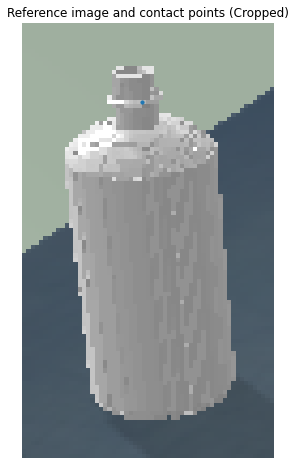

In [5]:
ref_img_mask = cv2.imread(ref_mask_path,cv2.IMREAD_GRAYSCALE)
ref_img_cropped, ref_cropbox = crop_image_from_mask(ref_img,ref_img_mask)
ref_pts_cropped = np.copy(ref_contact_pts)
ref_pts_cropped[:, 0] -= ref_cropbox[2]
ref_pts_cropped[:, 1] -= ref_cropbox[0]

%matplotlib inline
fig = plt.figure(figsize=(16, 8))
plt.imshow(ref_img_cropped)
plt.scatter(ref_pts_cropped[:,0],ref_pts_cropped[:,1],s = 10)
plt.axis('off')
plt.title('Reference image and contact points (Cropped)')
plt.show()


Query image:  0006
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[219.23083 177.36491]]


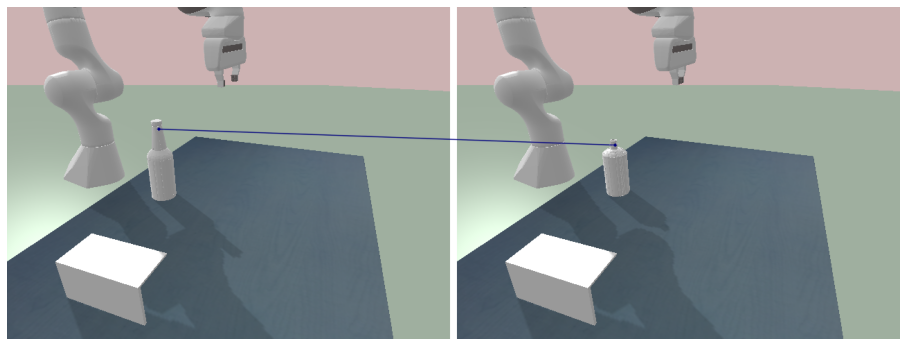

Saved!
Query image:  0002
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[225.3 170. ]]


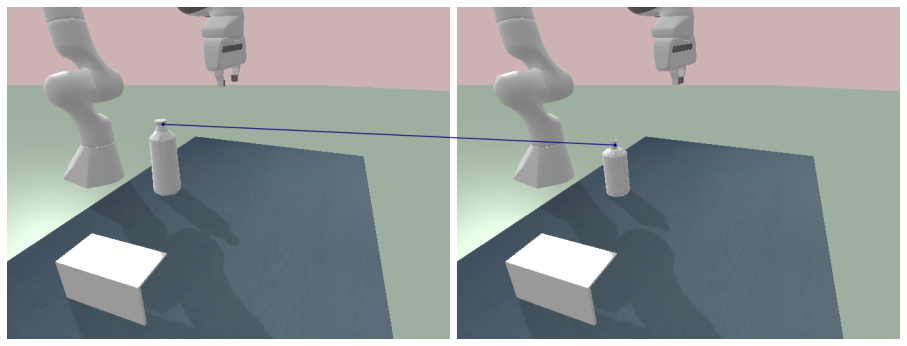

Saved!
Query image:  0001
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[223.2158  180.65678]]


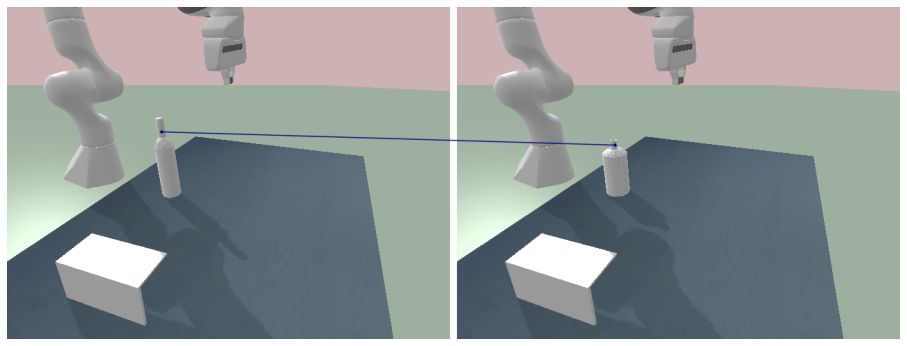

Saved!
Query image:  0015
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[228.0625  173.90485]]


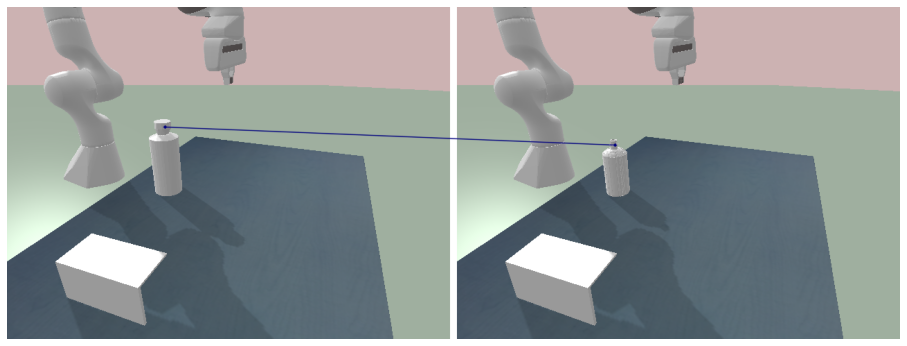

Saved!
Query image:  0025
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[236.8    182.3631]]


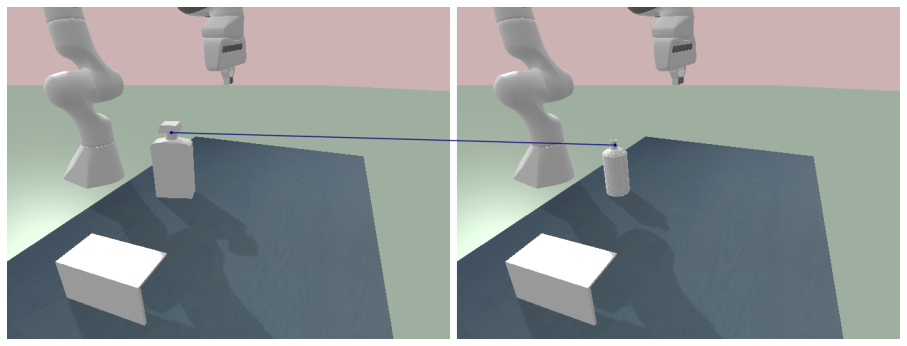

Saved!
Query image:  0021
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[247.2   200.625]]


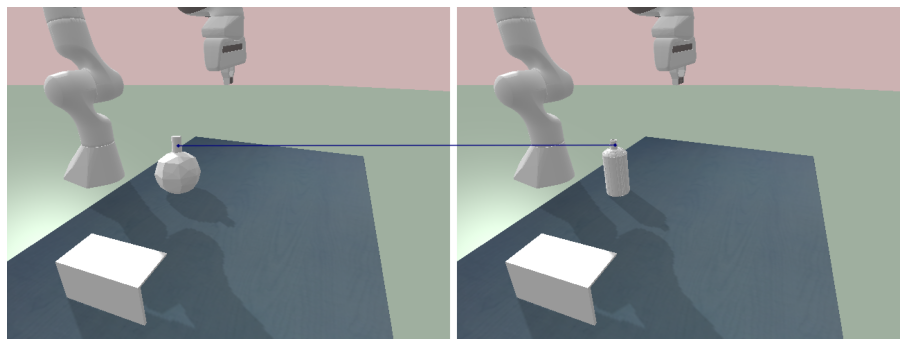

Saved!
Query image:  0000
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[226.2  180.75]]


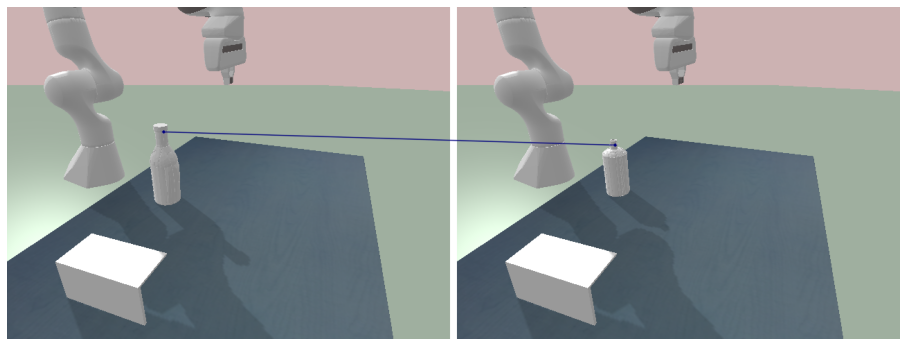

Saved!
Query image:  0018
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[233.18625 171.54767]]


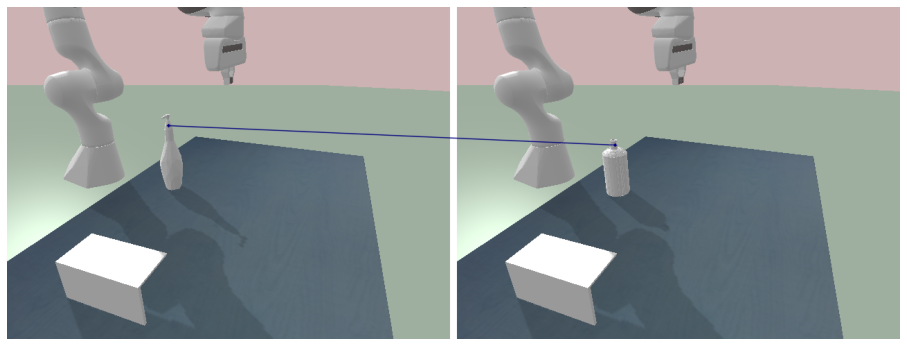

Saved!
Query image:  0010
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[272.575 167.825]]


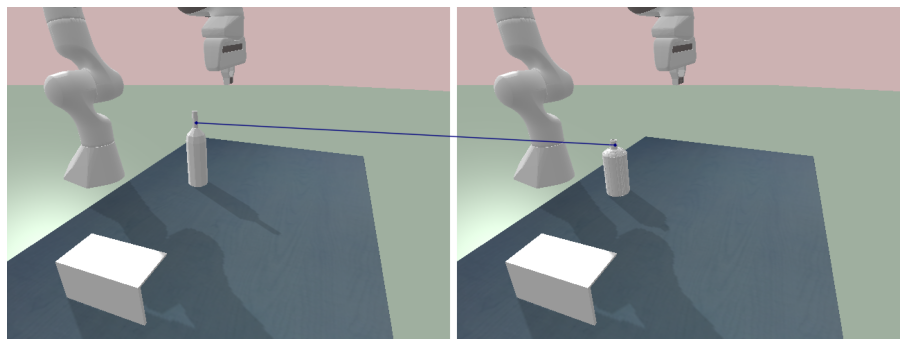

Saved!
Query image:  0009
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[225.   173.75]]


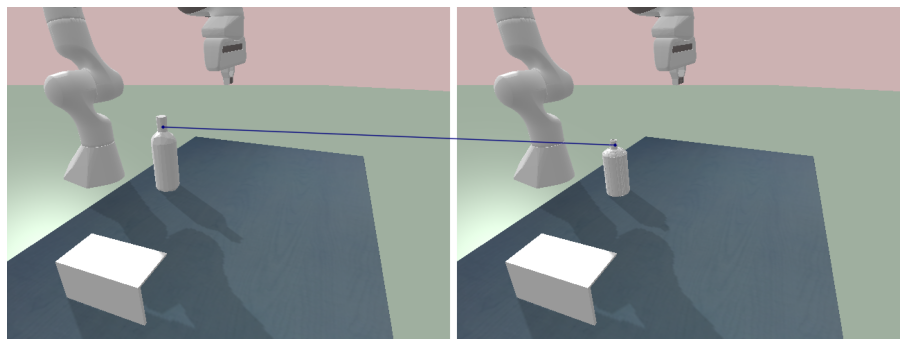

Saved!
Query image:  0003
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[241. 179.]]


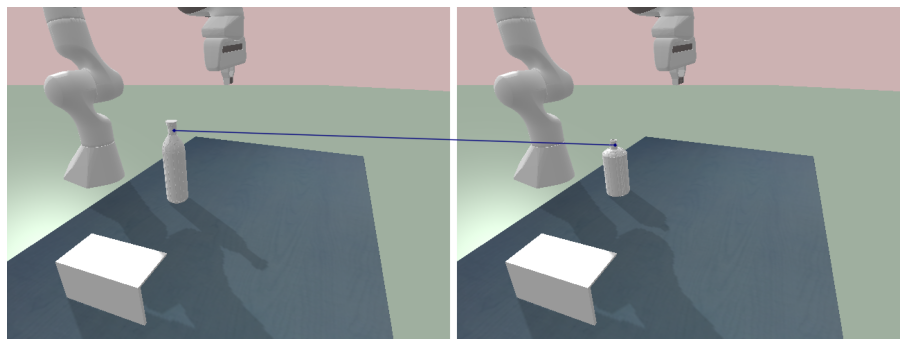

Saved!
Query image:  0024
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[213.20009 190.9875 ]]


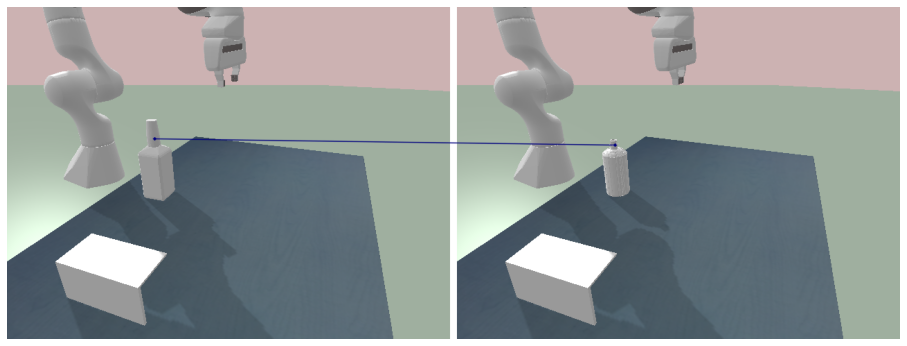

Saved!
Query image:  0013
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[238.27032 178.02818]]


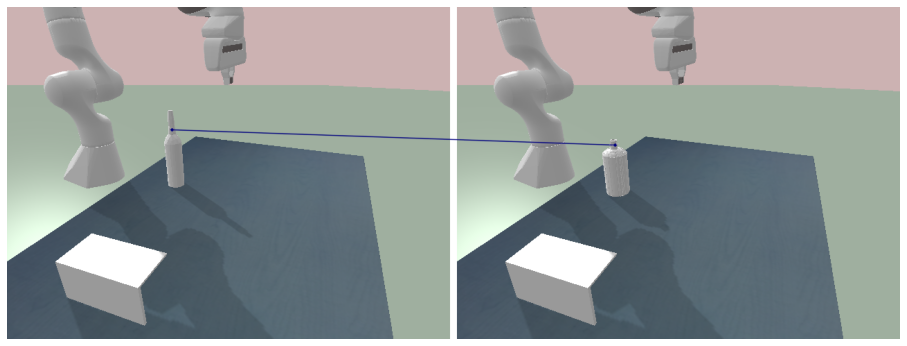

Saved!
Query image:  0005
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[202.05 185.4 ]]


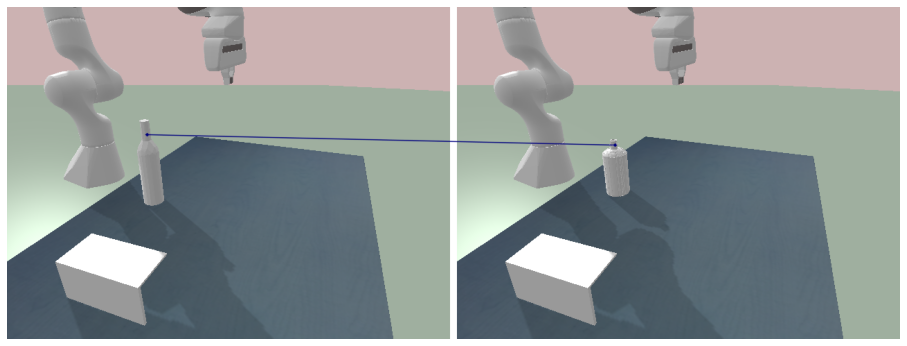

Saved!
Query image:  0012
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[254.   183.25]]


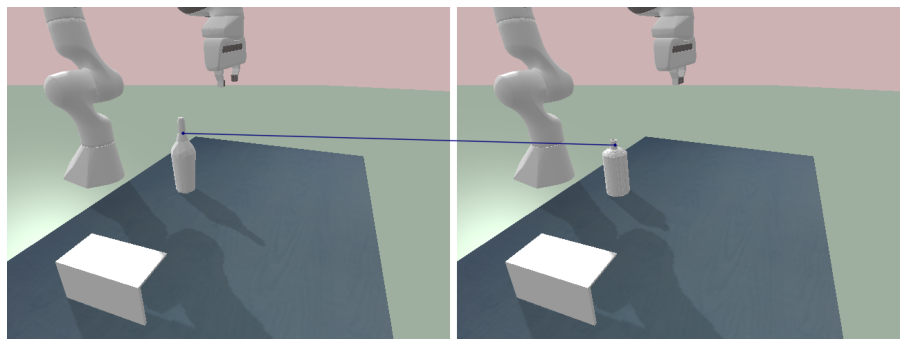

Saved!
Query image:  0019
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[222.85048 173.375  ]]


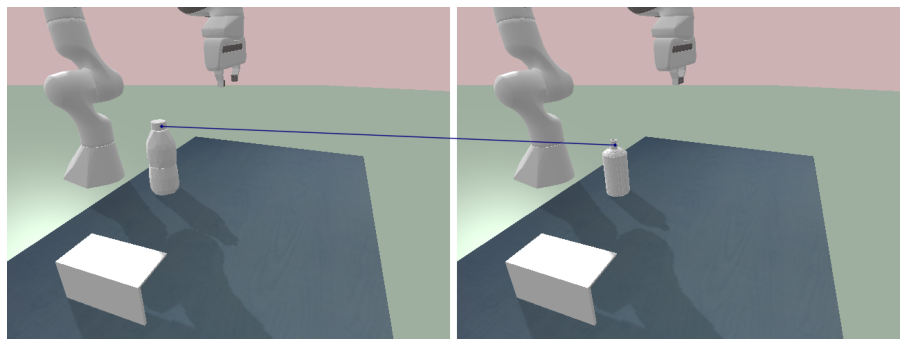

Saved!
Query image:  0016
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[241.      178.82204]]


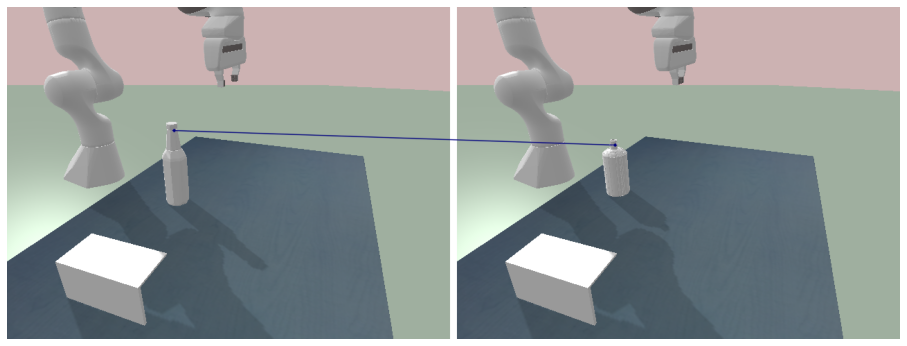

Saved!
Query image:  0011
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[225.3 175. ]]


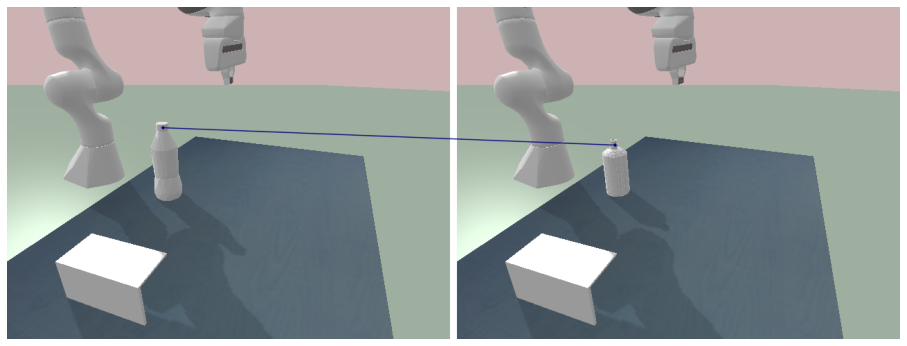

Saved!
Query image:  0007
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[246.92339 176.2    ]]


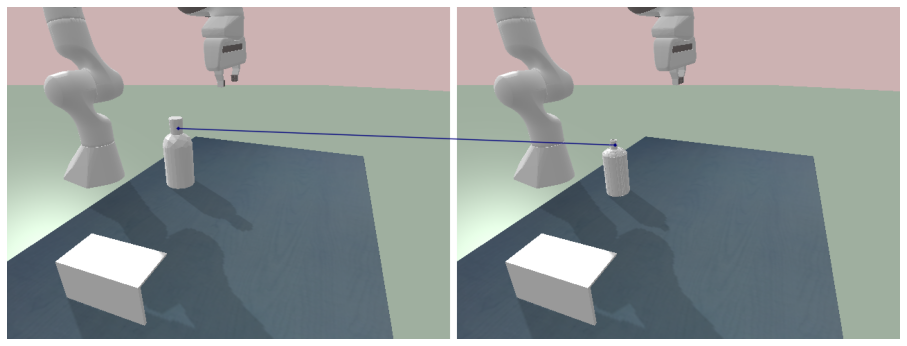

Saved!
Query image:  0020
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[244.      194.17796]]


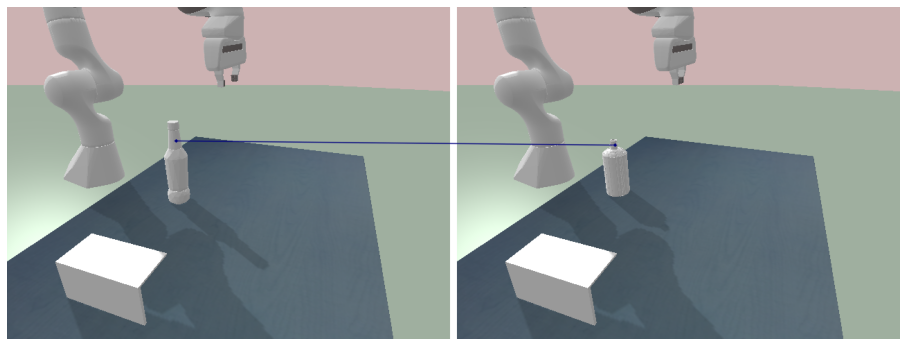

Saved!
Query image:  0022
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[229.  182.6]]


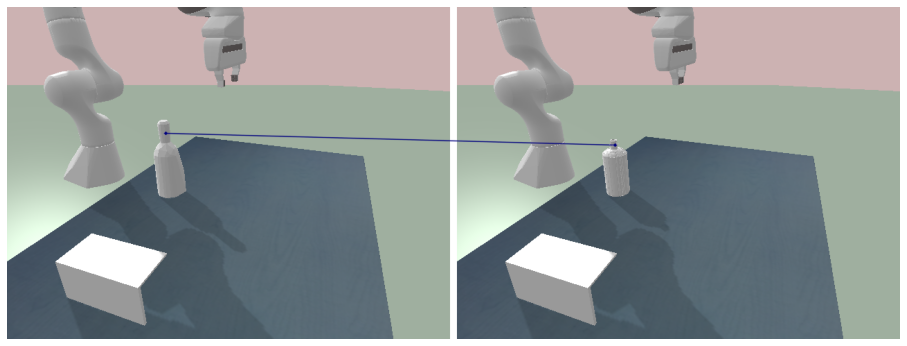

Saved!
Query image:  0017
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[228.  196.3]]


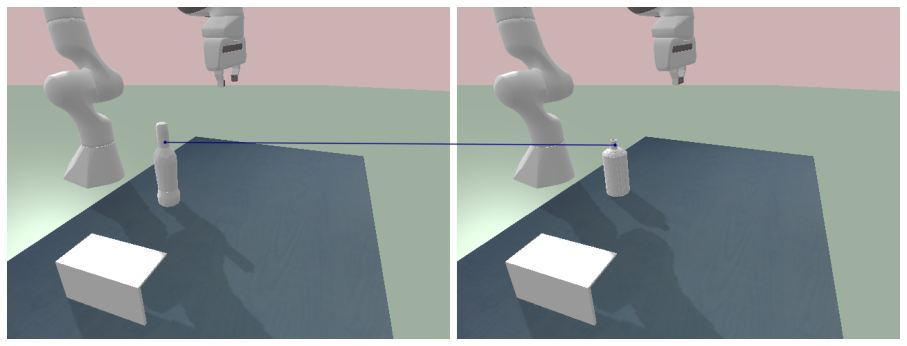

Saved!
Query image:  0014
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[229.1 236. ]]


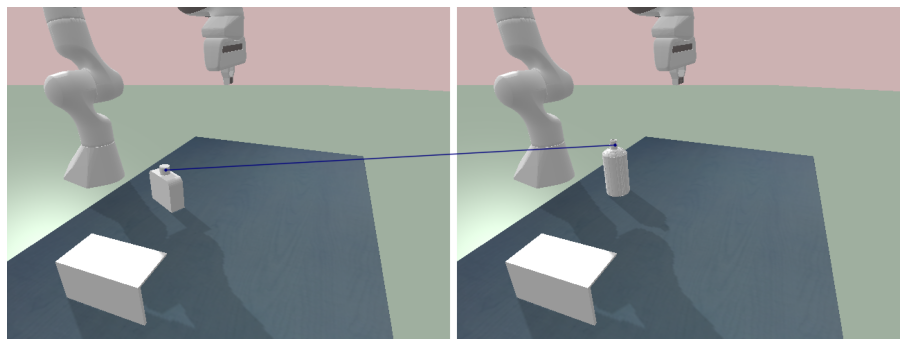

Saved!
Query image:  0023
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[235.  176.5]]


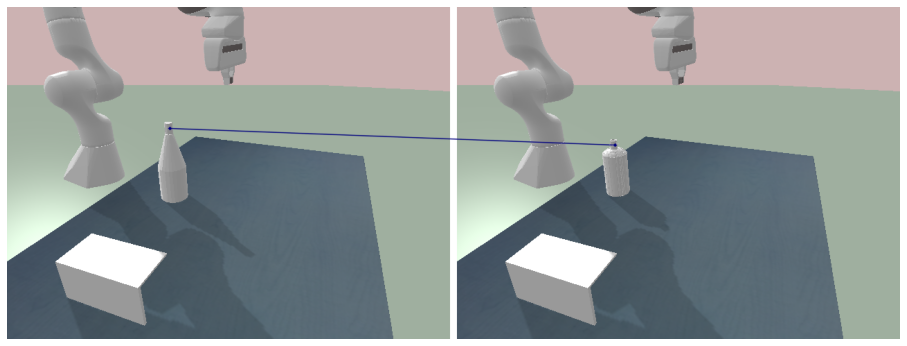

Saved!
Query image:  0004
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[246.958   180.70833]]


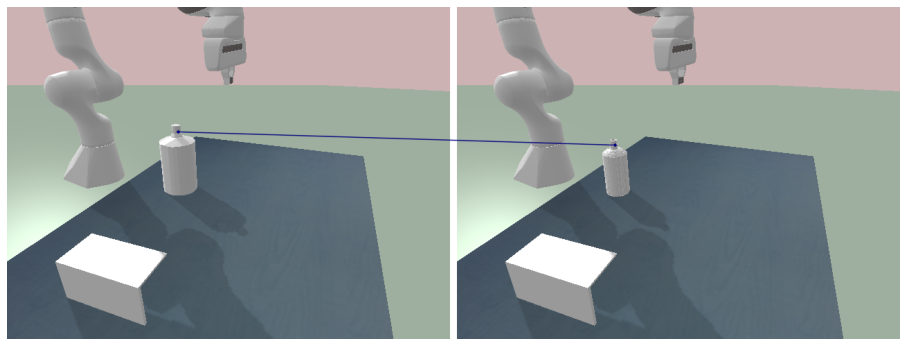

Saved!
Query image:  0026
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[211. 180.]]


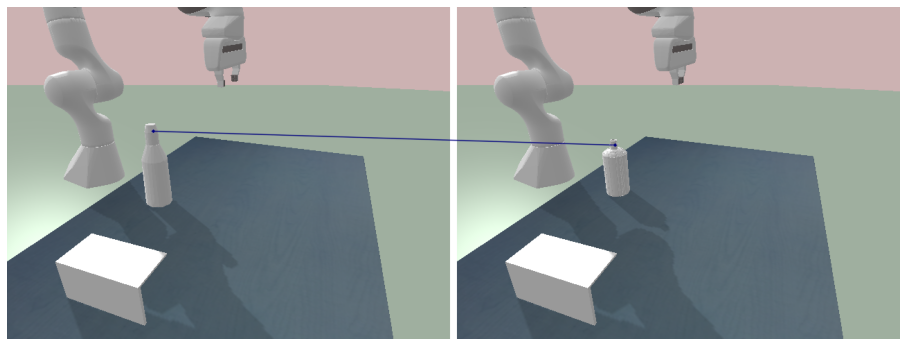

Saved!
Query image:  0008
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[248.  186.8]]


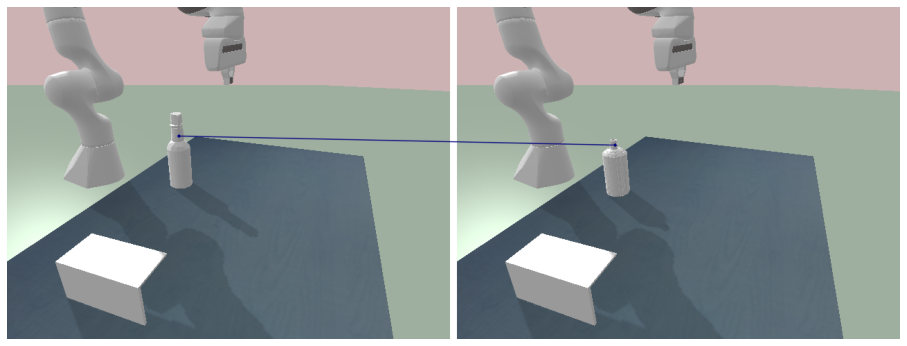

Saved!
Query image:  0027
Model: PWarpCSFNet_WS
Pre-trained-model: pfpascal
Query contact points [[224.65508 203.68373]]


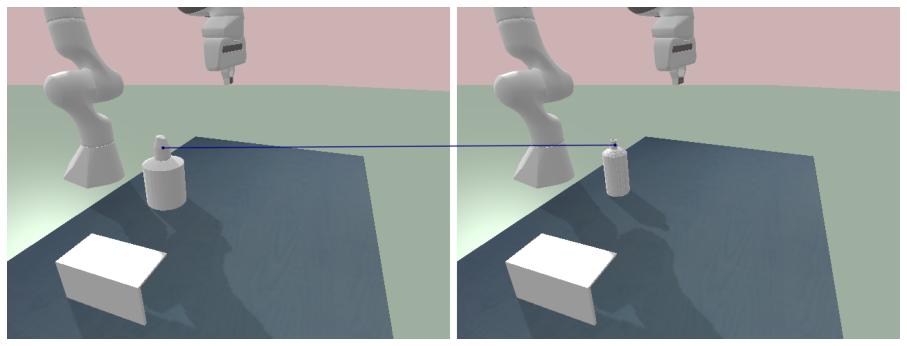

Saved!
Query image:  0006
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[218.76917 171.     ]]


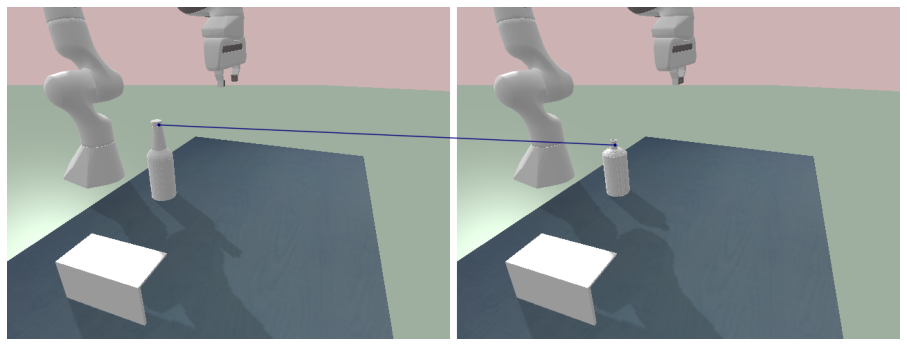

Saved!
Query image:  0002
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[224.75  172.125]]


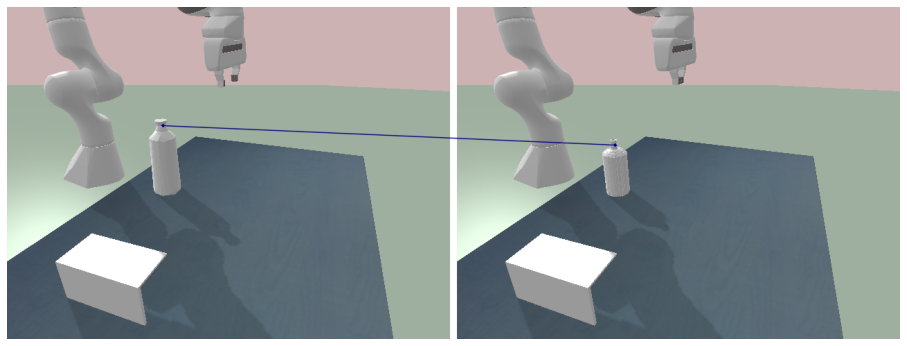

Saved!
Query image:  0001
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[221.20993 171.94322]]


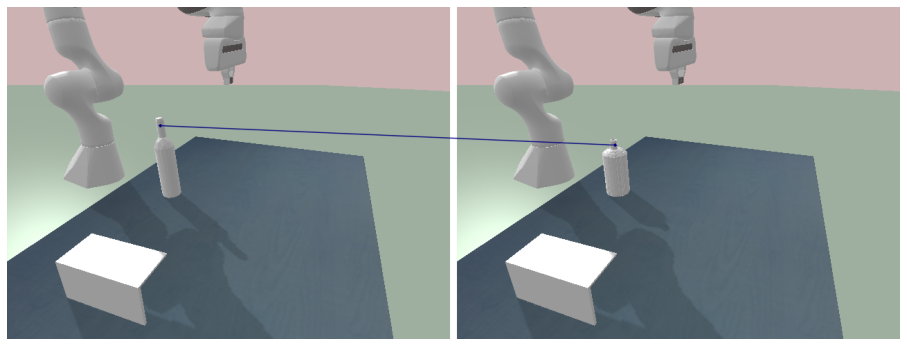

Saved!
Query image:  0015
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[229.5 177.5]]


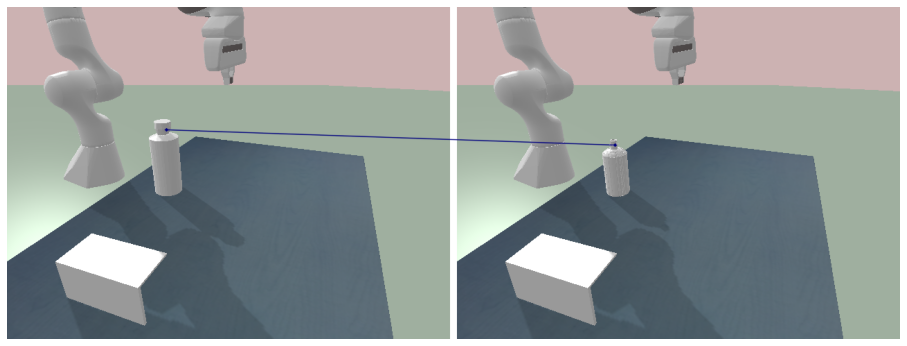

Saved!
Query image:  0025
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[228.8     186.67857]]


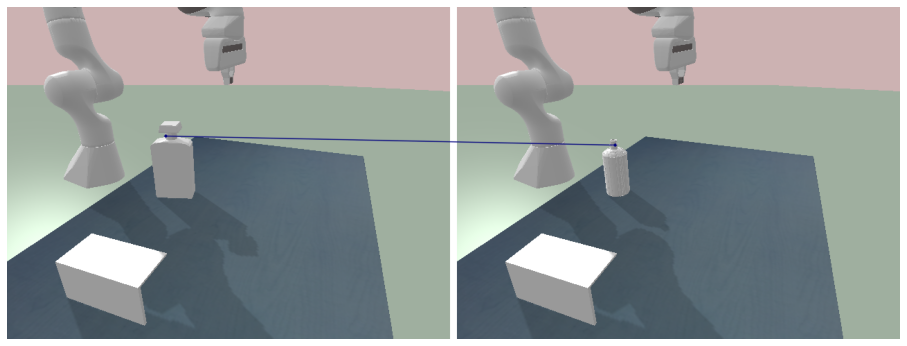

Saved!
Query image:  0021
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[243.2551 205.3   ]]


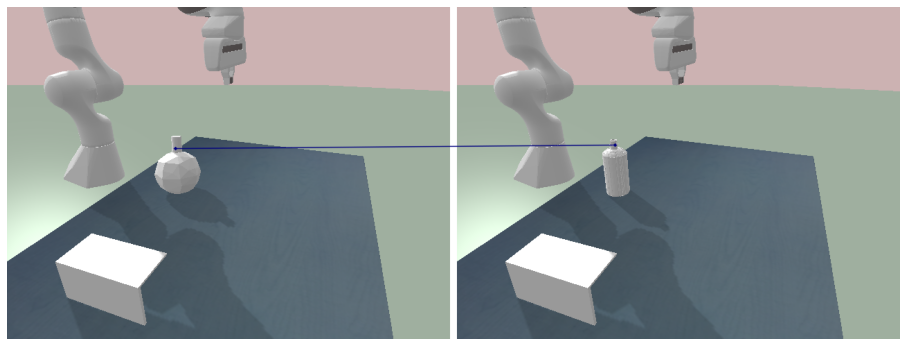

Saved!
Query image:  0000
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[226.14566 179.5    ]]


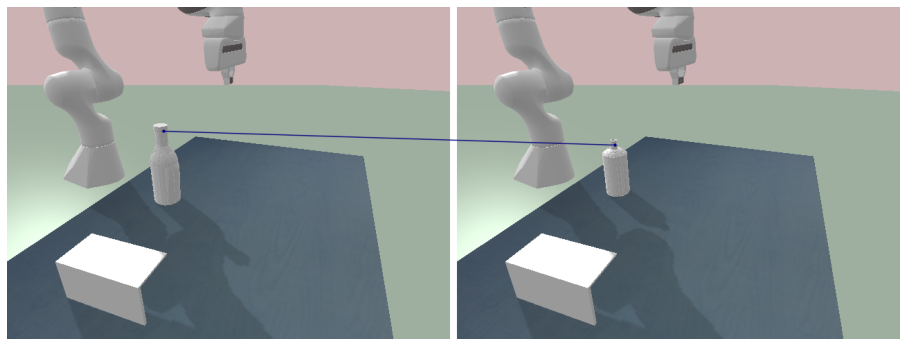

Saved!
Query image:  0018
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[232.1 164. ]]


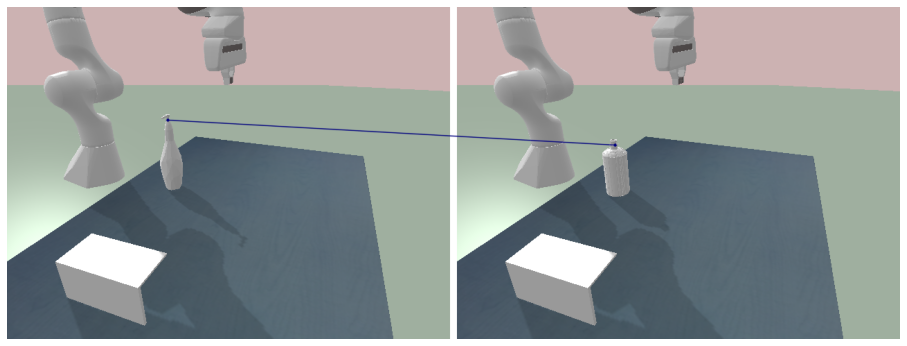

Saved!
Query image:  0010
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[272.05    171.17479]]


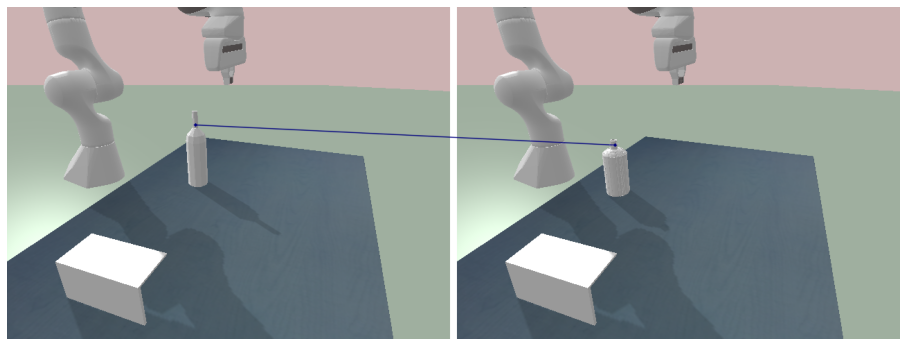

Saved!
Query image:  0009
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[225.      171.55533]]


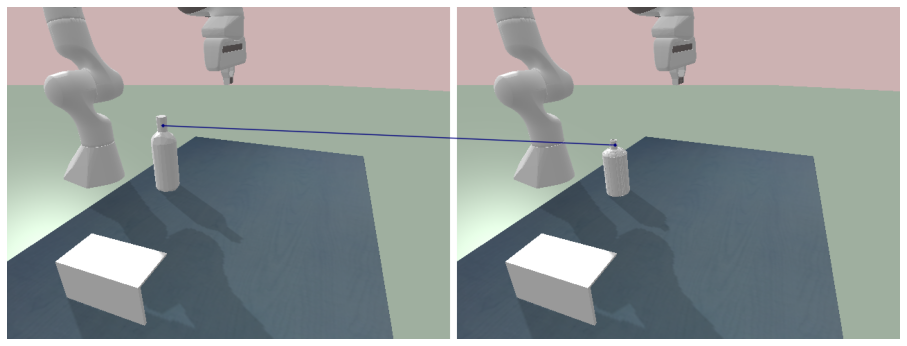

Saved!
Query image:  0003
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[240.65356 179.     ]]


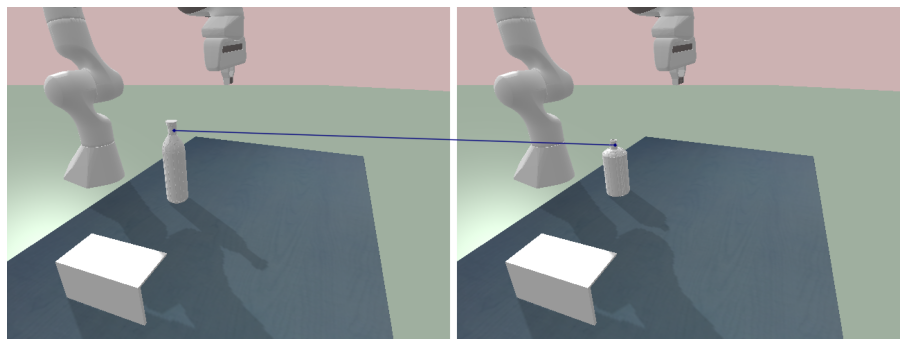

Saved!
Query image:  0024
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[216.95   199.7279]]


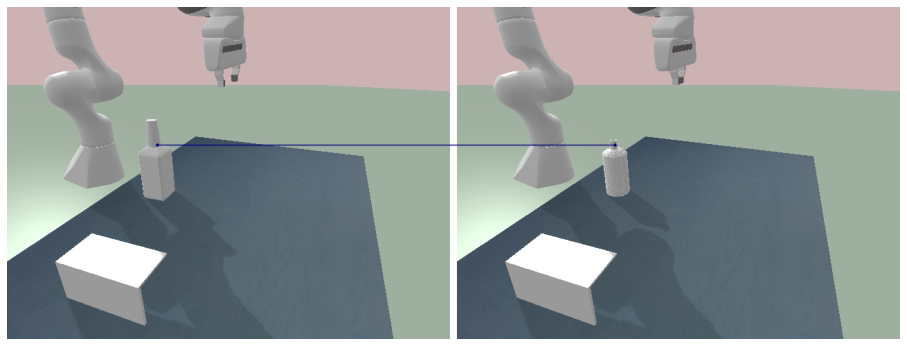

Saved!
Query image:  0013
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[238.1     178.02818]]


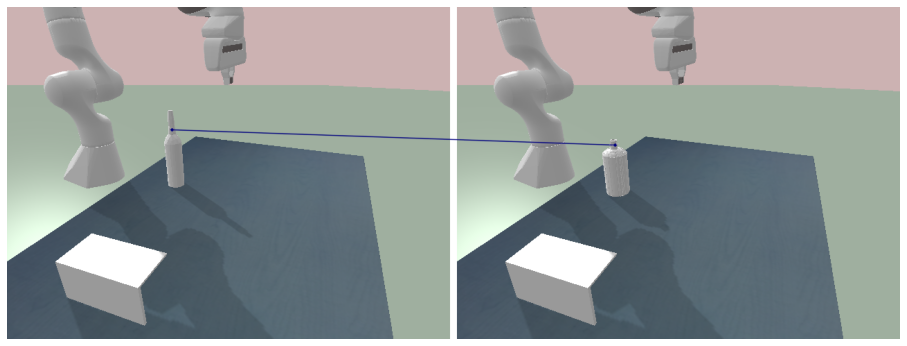

Saved!
Query image:  0005
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[199.30486 172.     ]]


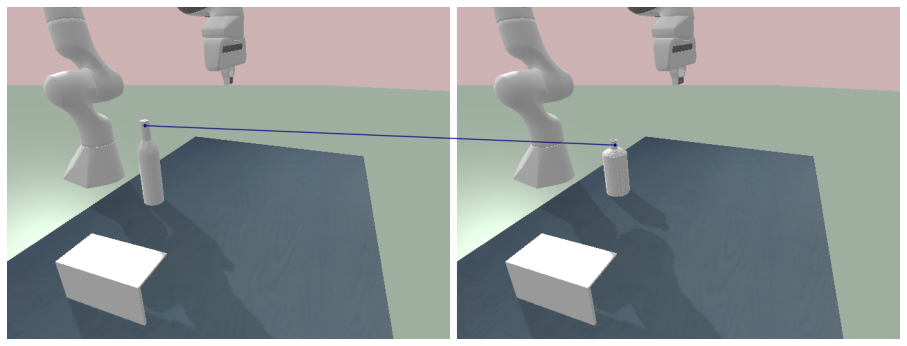

Saved!
Query image:  0012
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[251.575 176.75 ]]


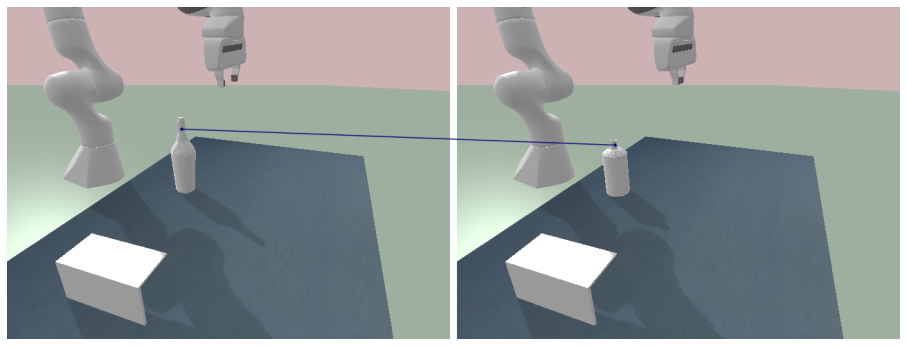

Saved!
Query image:  0019
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[221.35 171.  ]]


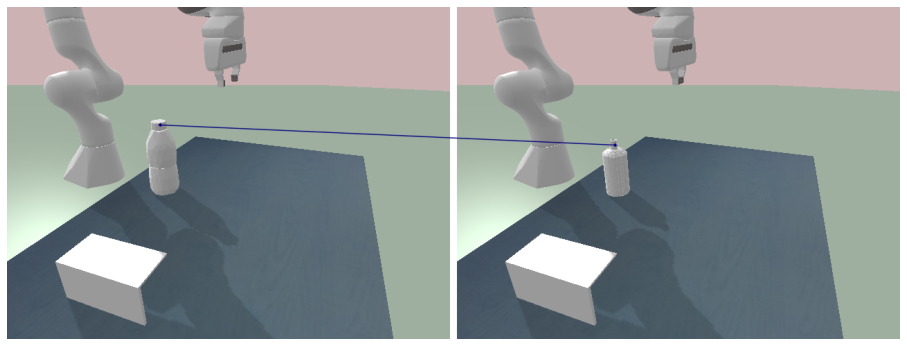

Saved!
Query image:  0016
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[241.27142 179.     ]]


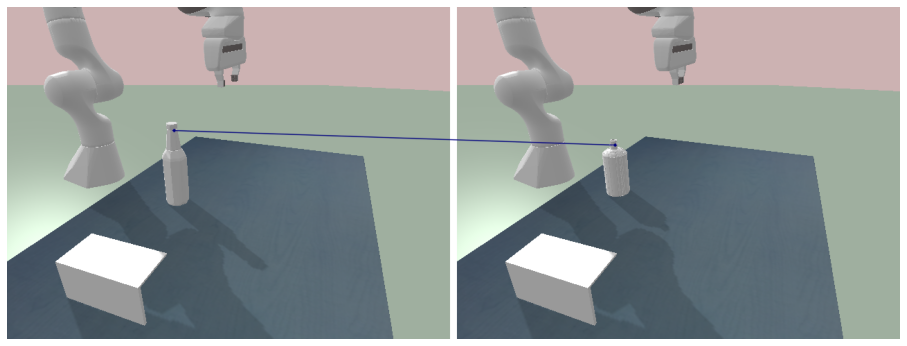

Saved!
Query image:  0011
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[225. 175.]]


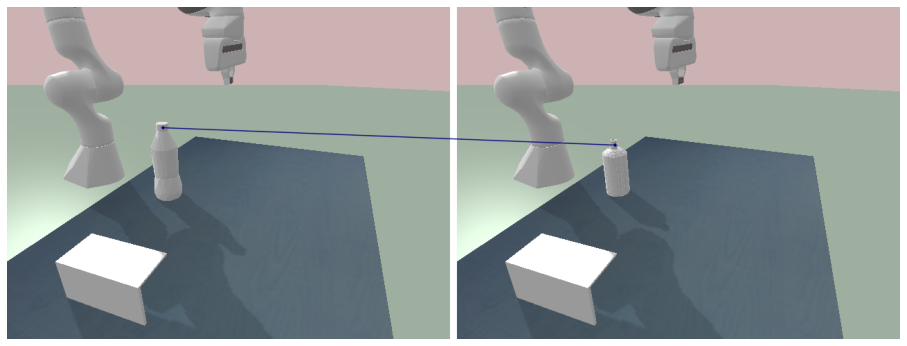

Saved!
Query image:  0007
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[244.85887 175.88461]]


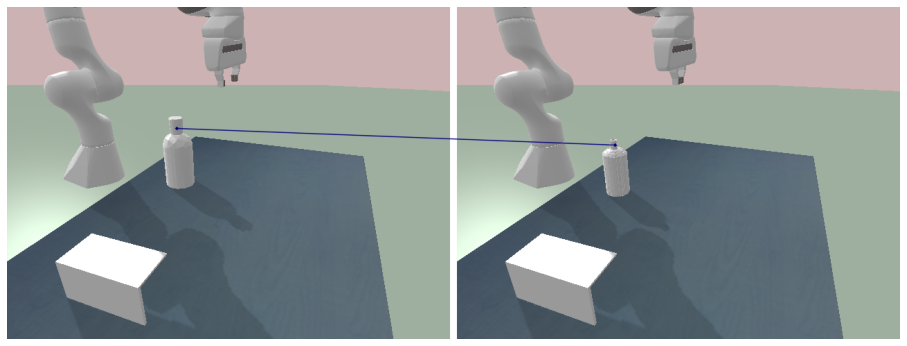

Saved!
Query image:  0020
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[244.04643 177.     ]]


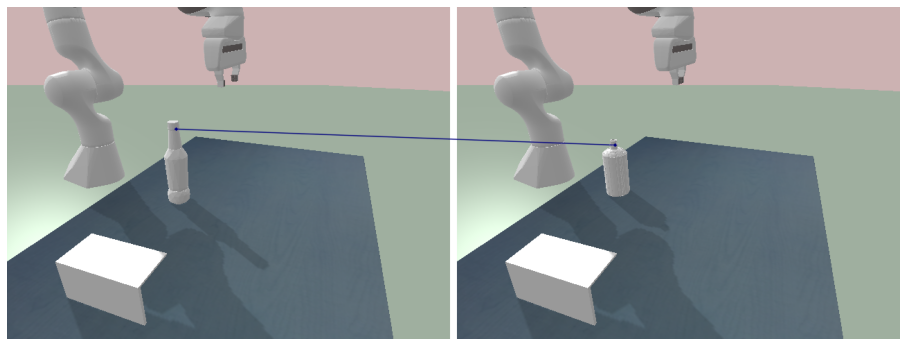

Saved!
Query image:  0022
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[230. 178.]]


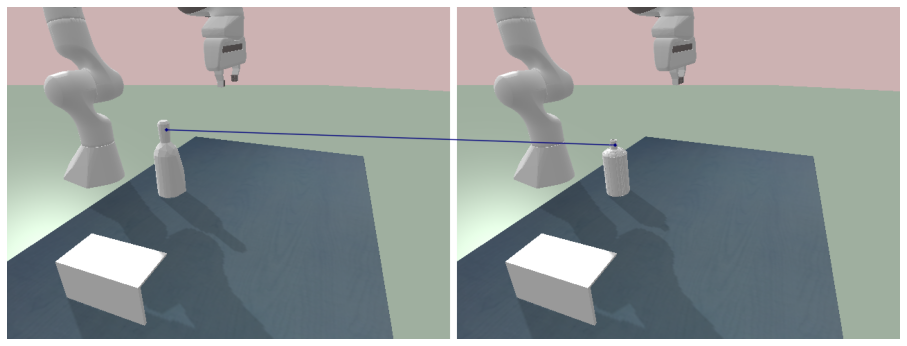

Saved!
Query image:  0017
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[225.36162 177.25   ]]


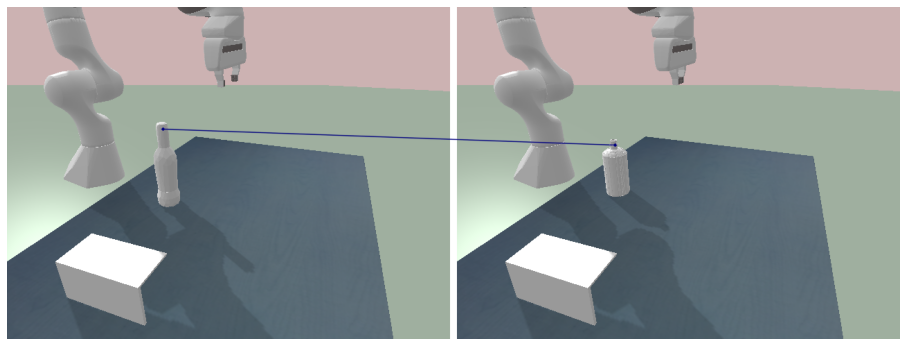

Saved!
Query image:  0014
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[229.1 236. ]]


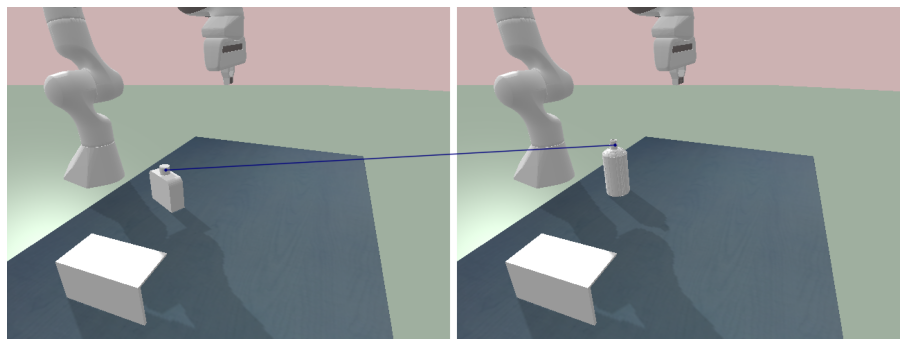

Saved!
Query image:  0023
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[234.275 175.   ]]


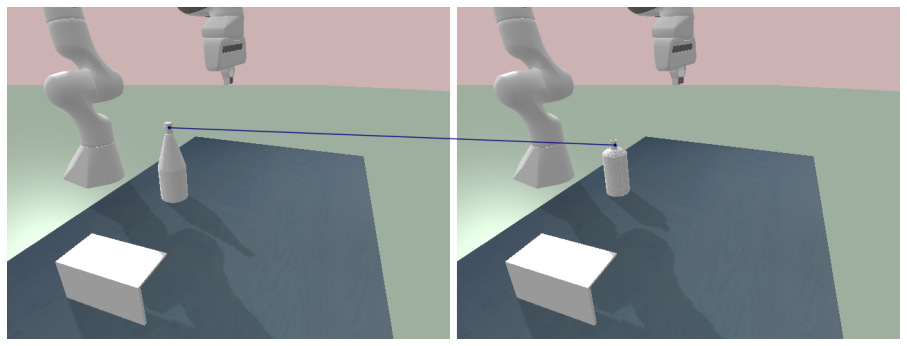

Saved!
Query image:  0004
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[243.833 178.   ]]


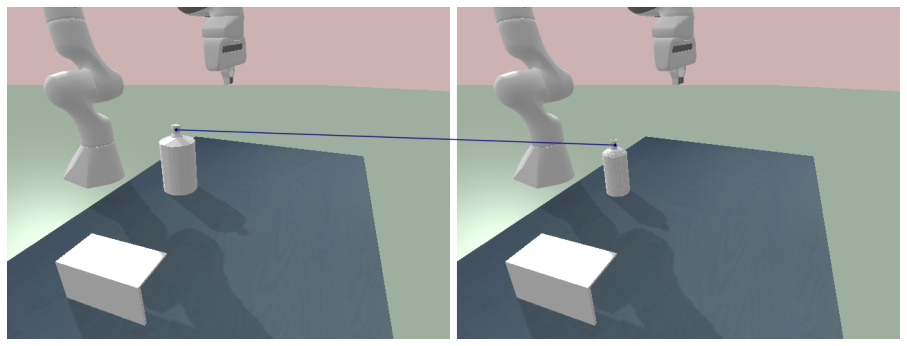

Saved!
Query image:  0026
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[207.75714 177.90625]]


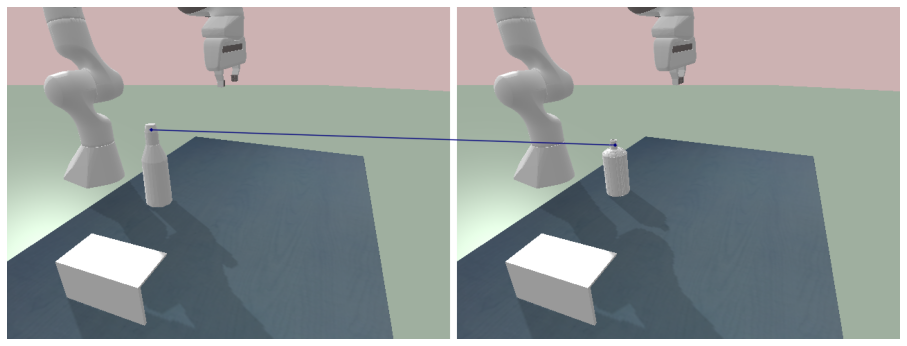

Saved!
Query image:  0008
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[246.64253 170.92267]]


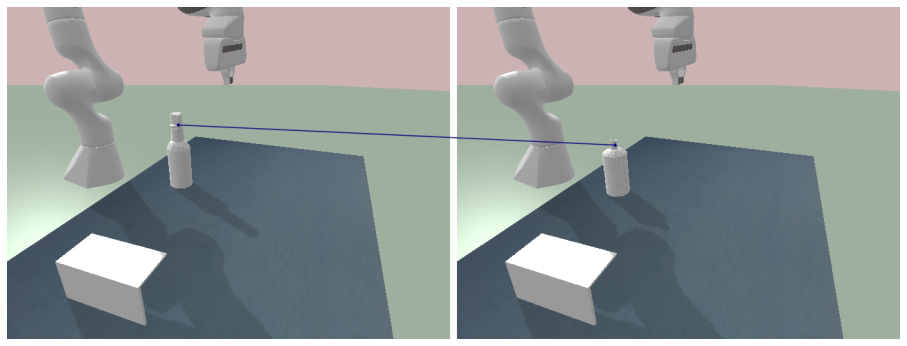

Saved!
Query image:  0027
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_cropped
Query contact points [[224.24492 194.     ]]


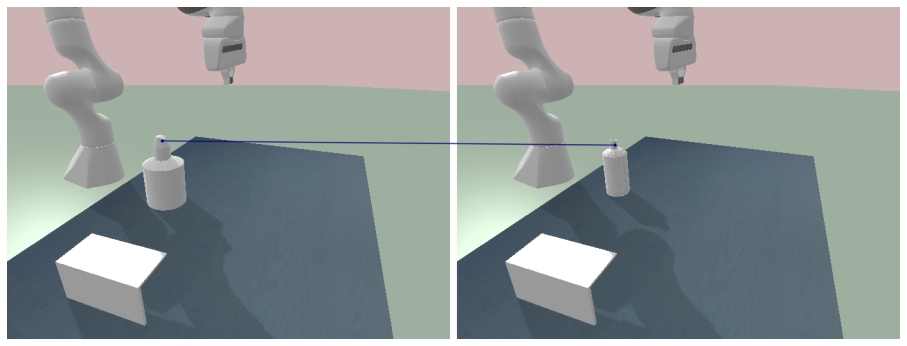

Saved!
Query image:  0006
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[219.46169 173.5504 ]]


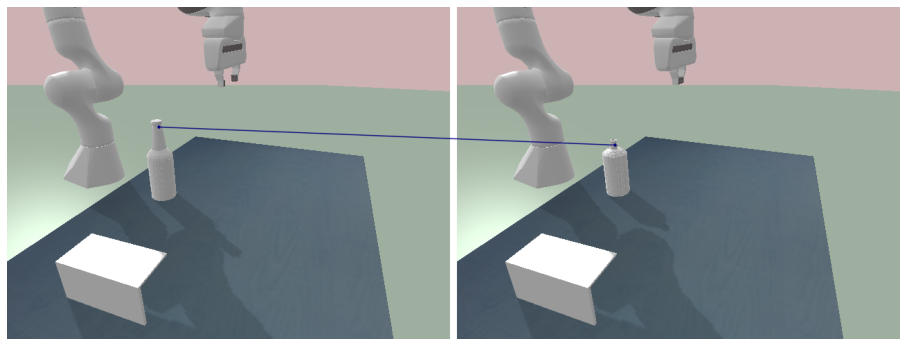

Saved!
Query image:  0002
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[225.12157 170.     ]]


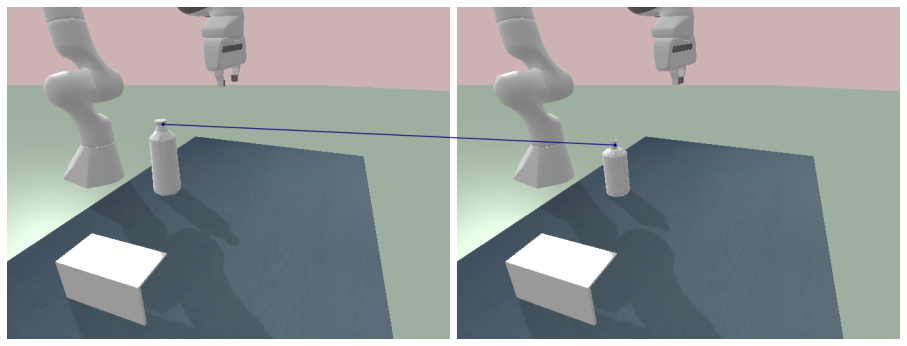

Saved!
Query image:  0001
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[223.1 176.3]]


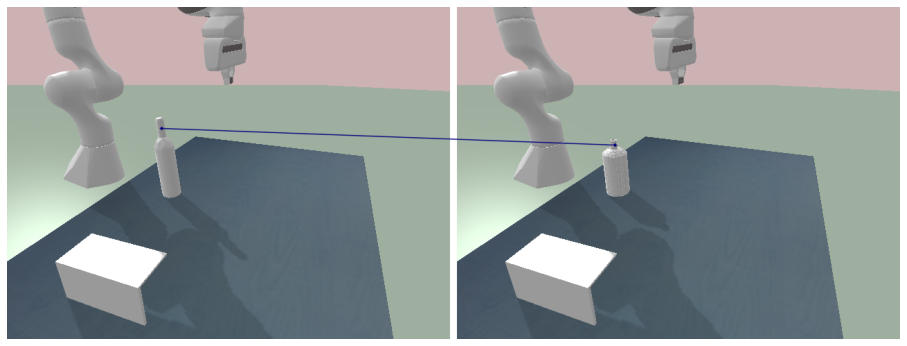

Saved!
Query image:  0015
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[229.31538 174.01306]]


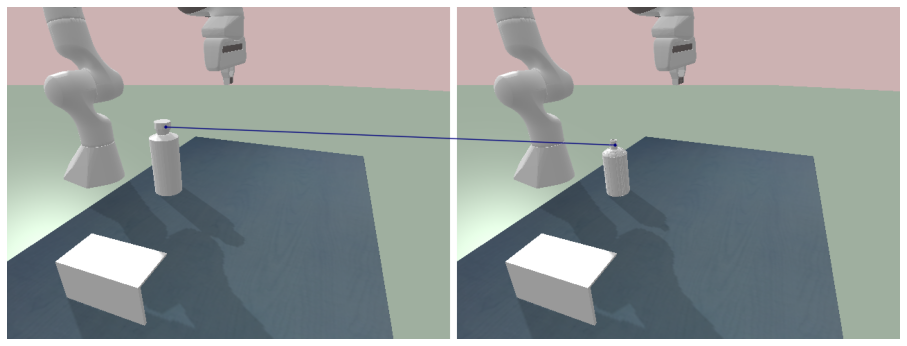

Saved!
Query image:  0025
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[240.8   178.425]]


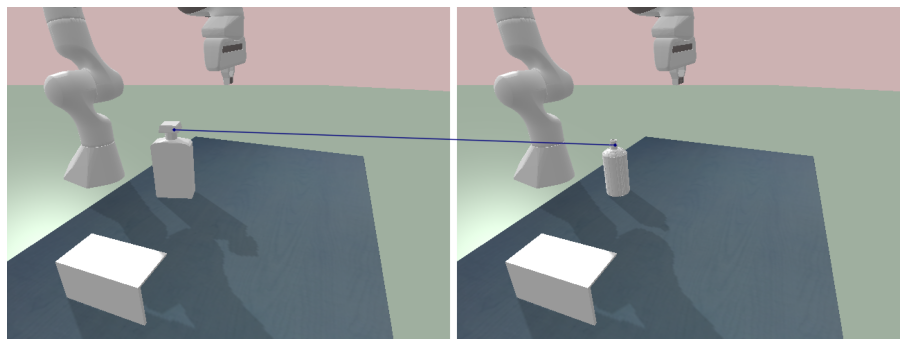

Saved!
Query image:  0021
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[247.1585 195.5247]]


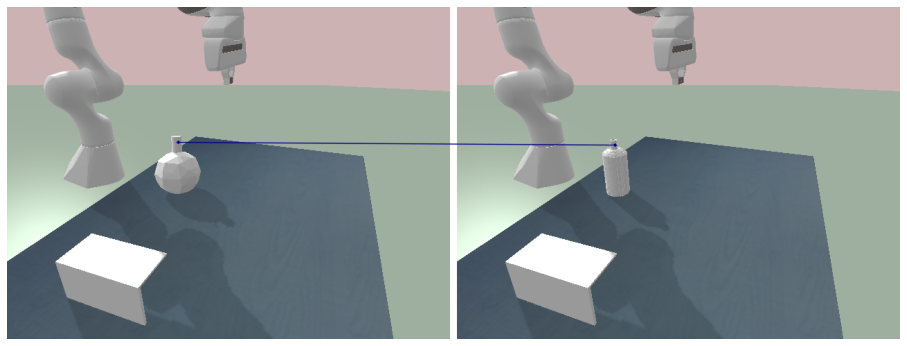

Saved!
Query image:  0000
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[226.2    180.0297]]


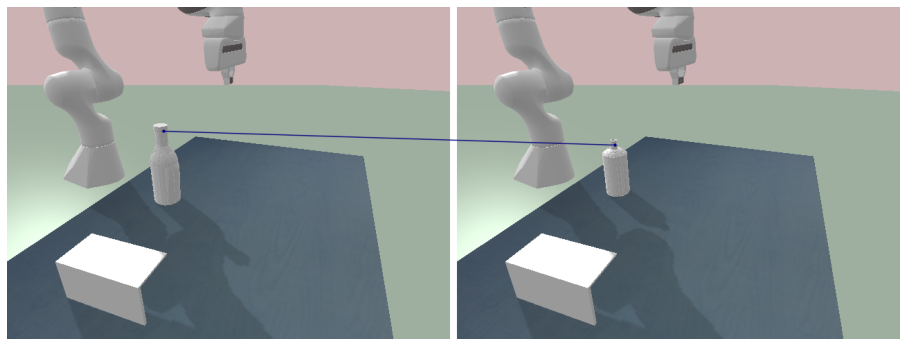

Saved!
Query image:  0018
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[232.1 164. ]]


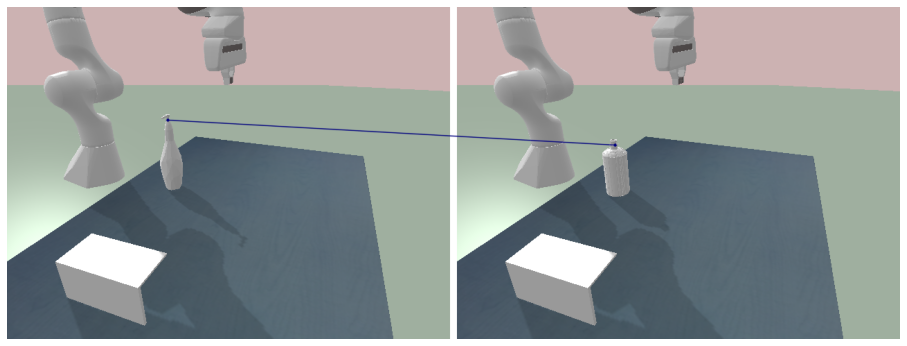

Saved!
Query image:  0010
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[272.05 171.9 ]]


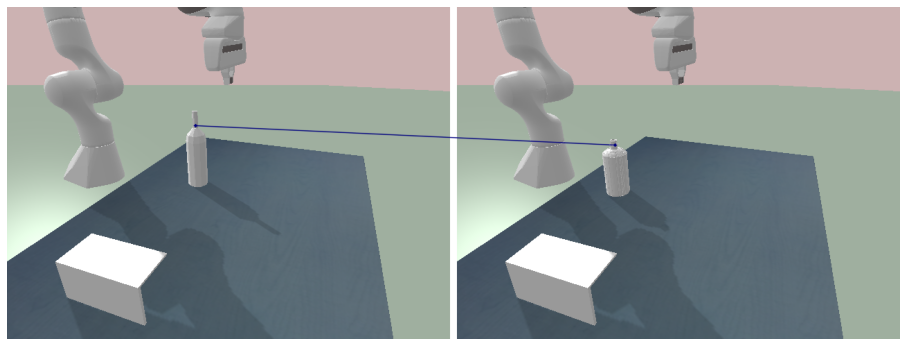

Saved!
Query image:  0009
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[225.  169.5]]


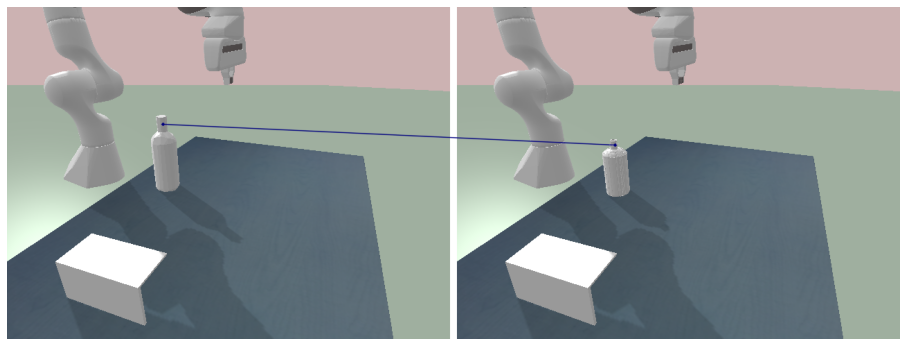

Saved!
Query image:  0003
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[240.57857 179.     ]]


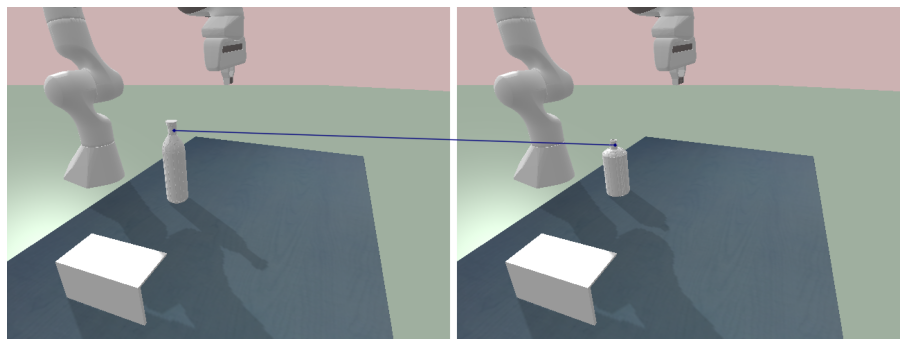

Saved!
Query image:  0024
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[211.11533 176.5    ]]


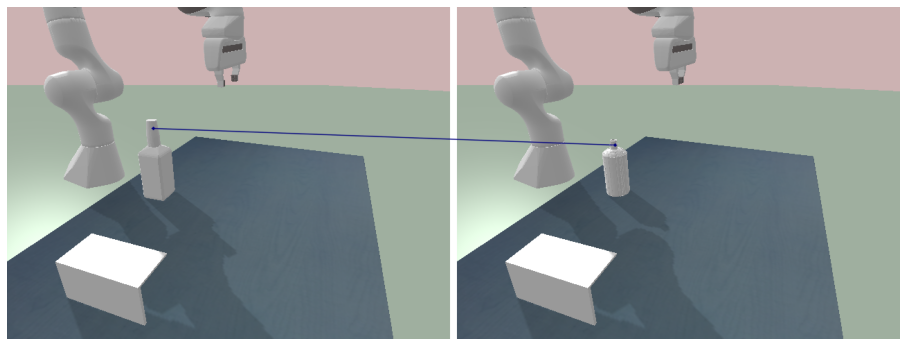

Saved!
Query image:  0013
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[238.1  177.65]]


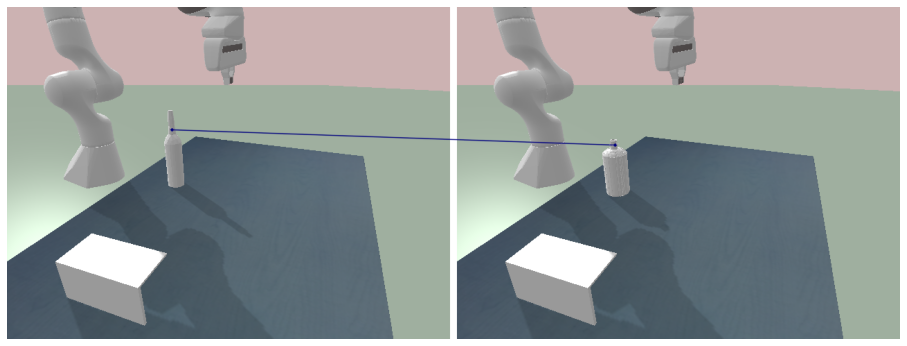

Saved!
Query image:  0005
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[199.7934  173.19238]]


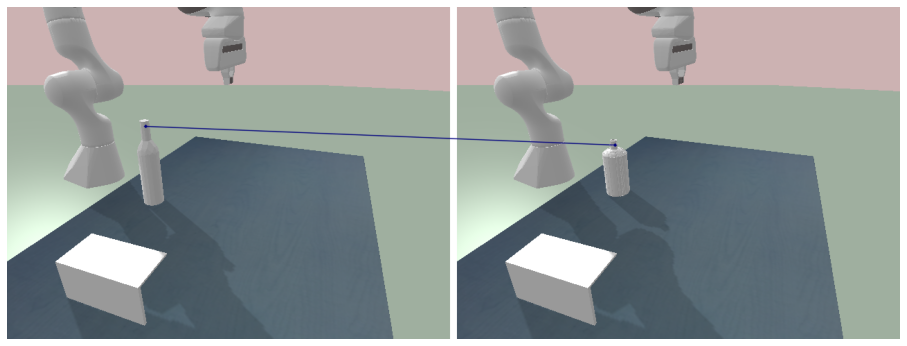

Saved!
Query image:  0012
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[251.575   173.25636]]


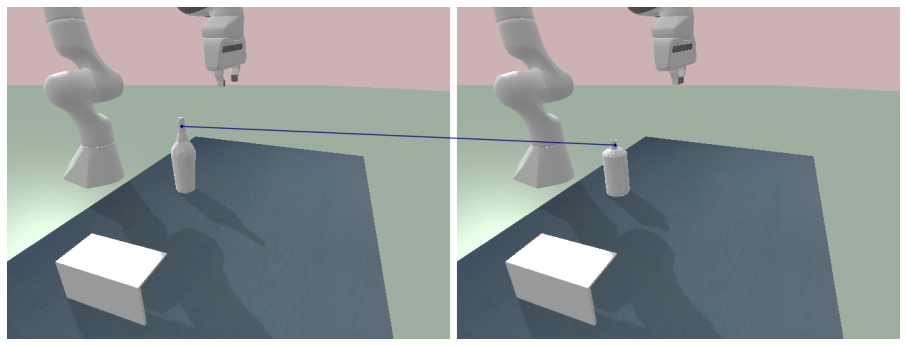

Saved!
Query image:  0019
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[221.35 171.  ]]


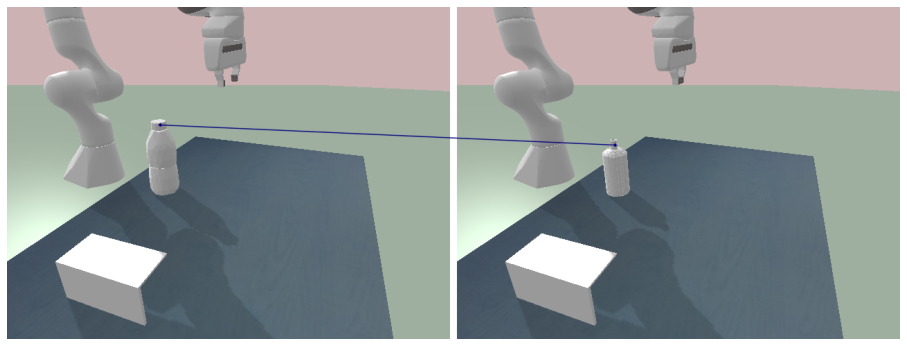

Saved!
Query image:  0016
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[241.27142 178.17798]]


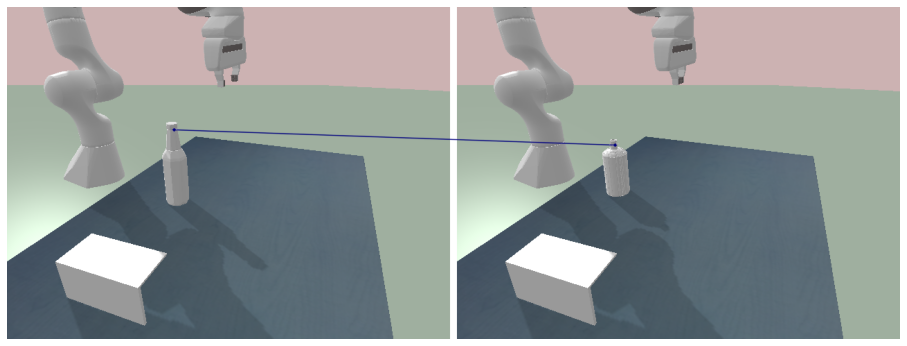

Saved!
Query image:  0011
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[225. 175.]]


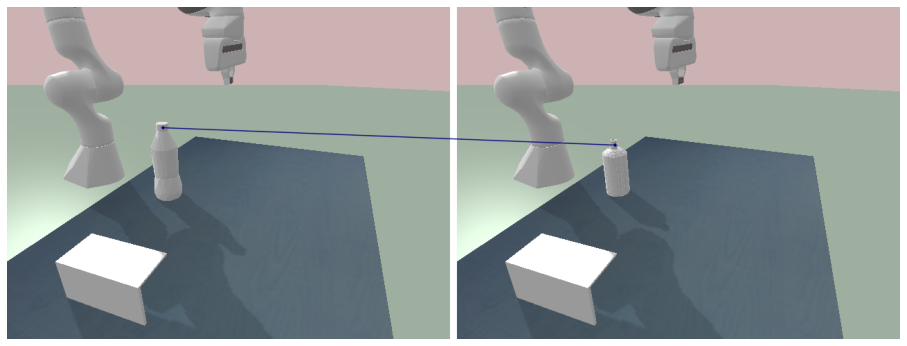

Saved!
Query image:  0007
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[248.25    170.07692]]


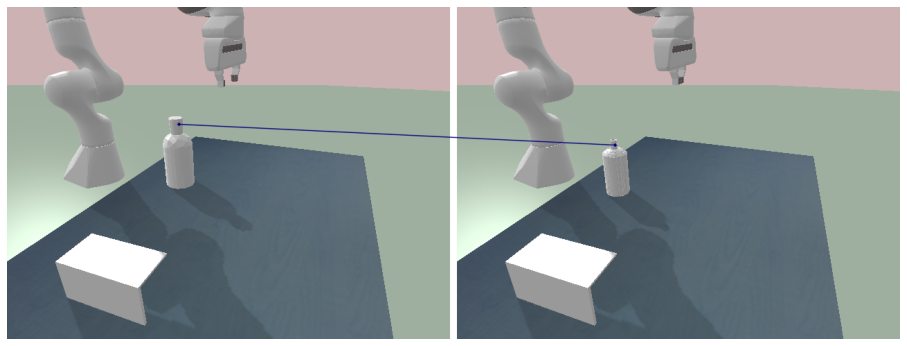

Saved!
Query image:  0020
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[244.42143 182.82204]]


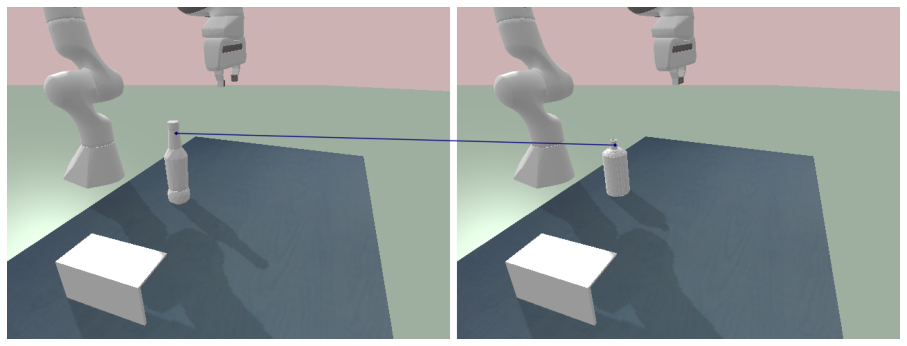

Saved!
Query image:  0022
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[230. 178.]]


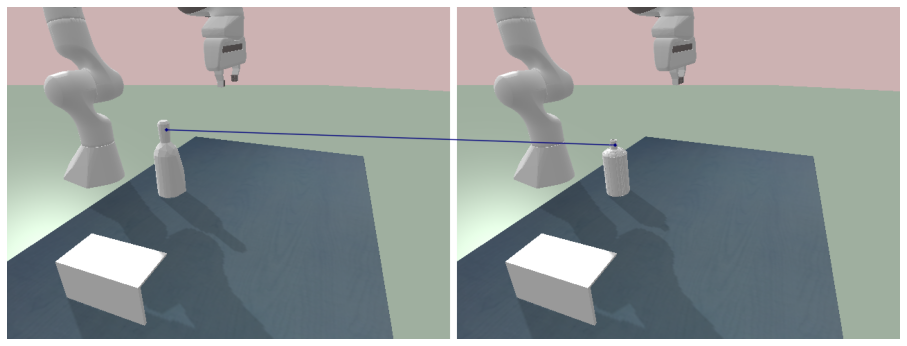

Saved!
Query image:  0017
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[225.10545 173.25339]]


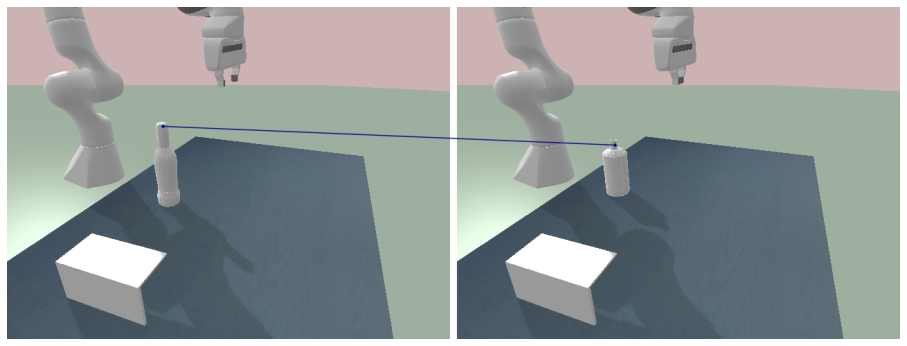

Saved!
Query image:  0014
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[229.1     235.83978]]


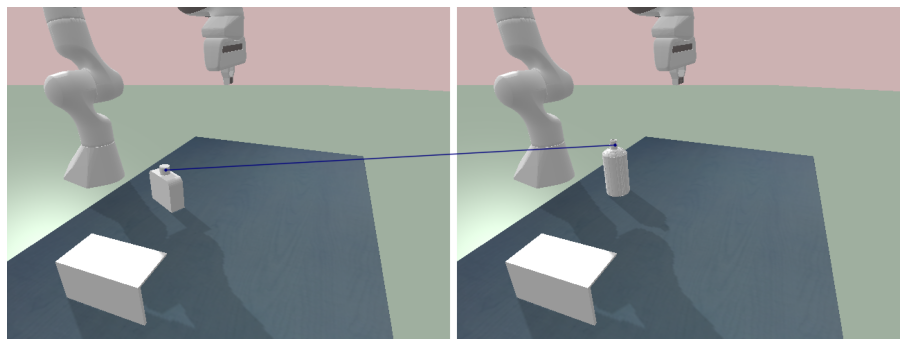

Saved!
Query image:  0023
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[234.275 175.   ]]


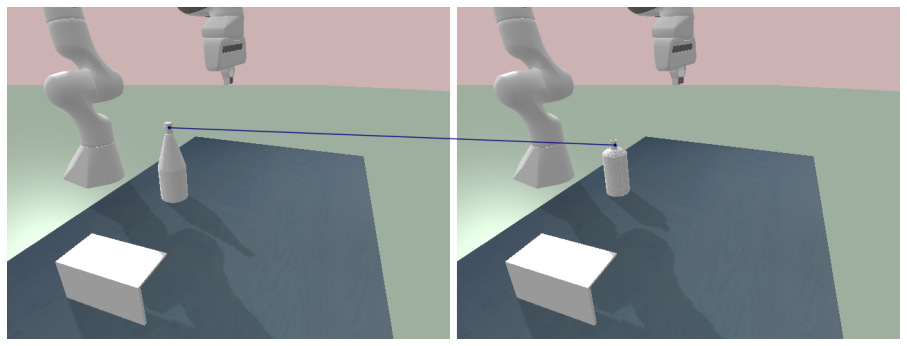

Saved!
Query image:  0004
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[243.833 178.   ]]


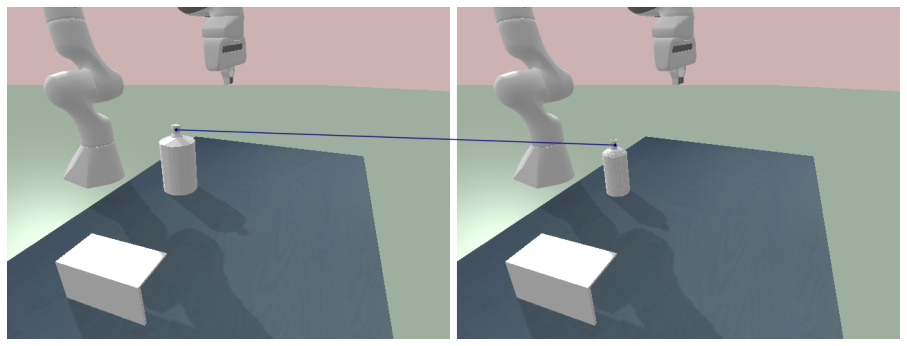

Saved!
Query image:  0026
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[211. 178.]]


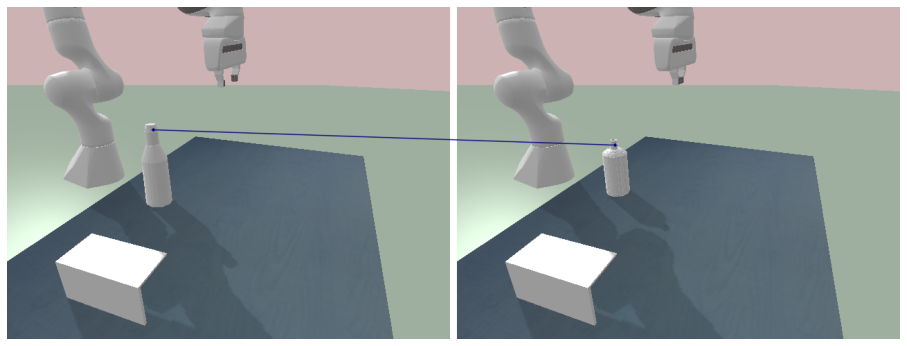

Saved!
Query image:  0008
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[248.69962 172.88432]]


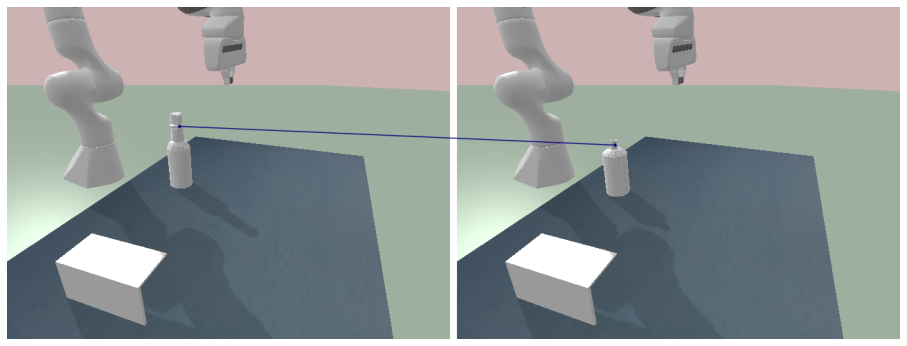

Saved!
Query image:  0027
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_cropped
Query contact points [[224.45 194.  ]]


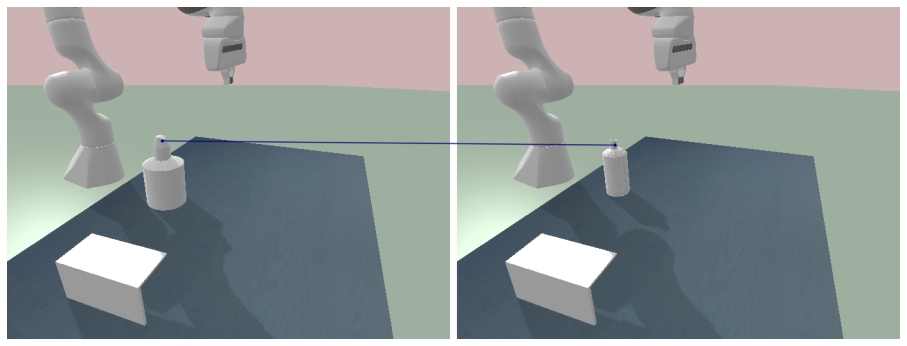

Saved!
Query image:  0006
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[220.63596 177.875  ]]


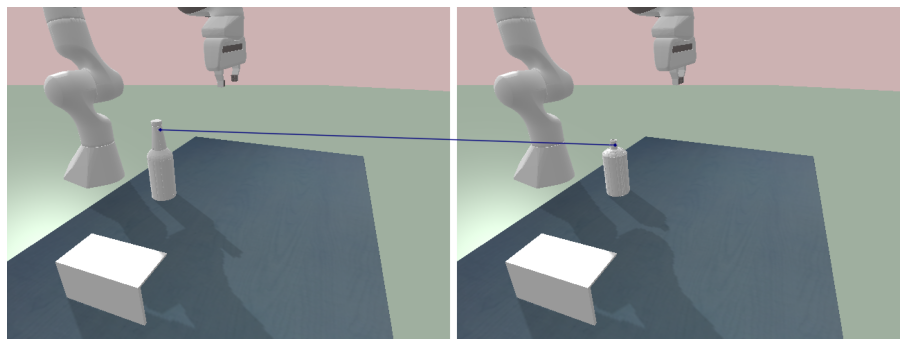

Saved!
Query image:  0002
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[224.75    170.35417]]


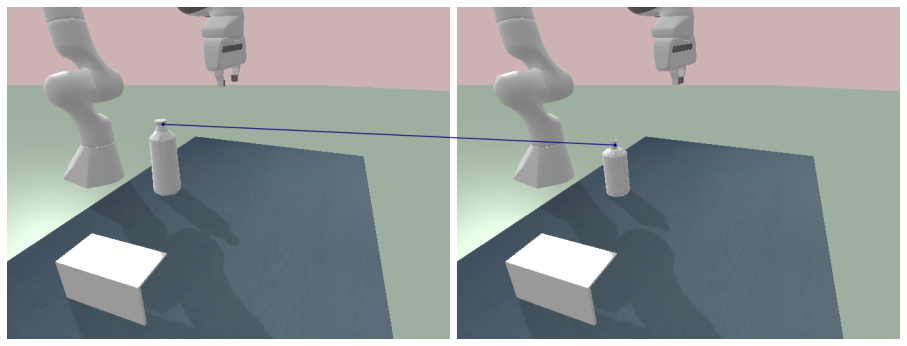

Saved!
Query image:  0001
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[221.74486 171.94322]]


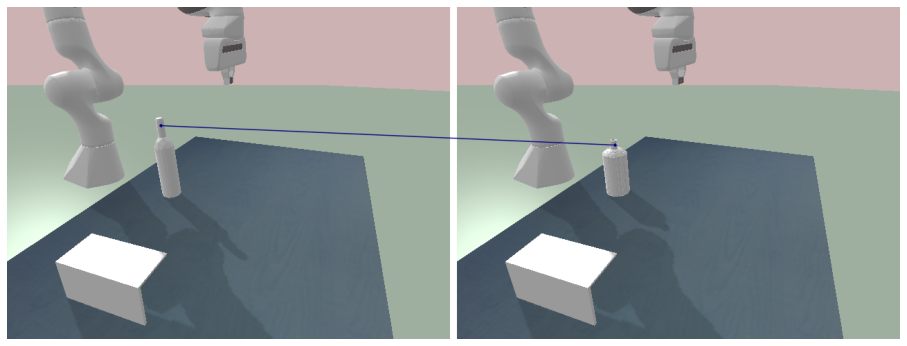

Saved!
Query image:  0015
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[233.025  179.3918]]


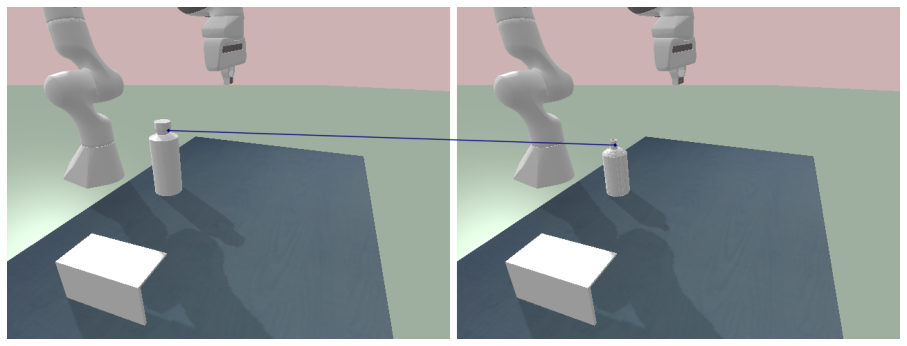

Saved!
Query image:  0025
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[228.9458 187.1   ]]


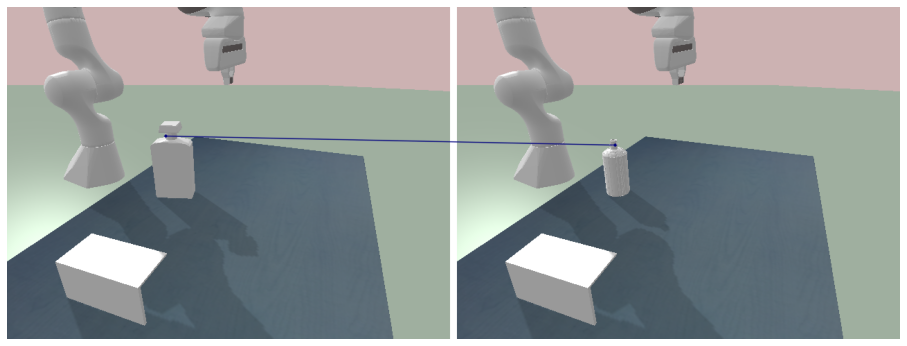

Saved!
Query image:  0021
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[242.9     196.92848]]


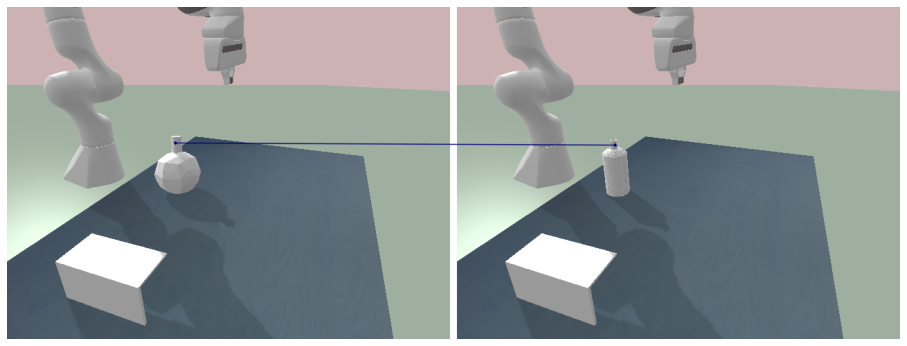

Saved!
Query image:  0000
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[226.72536 180.75   ]]


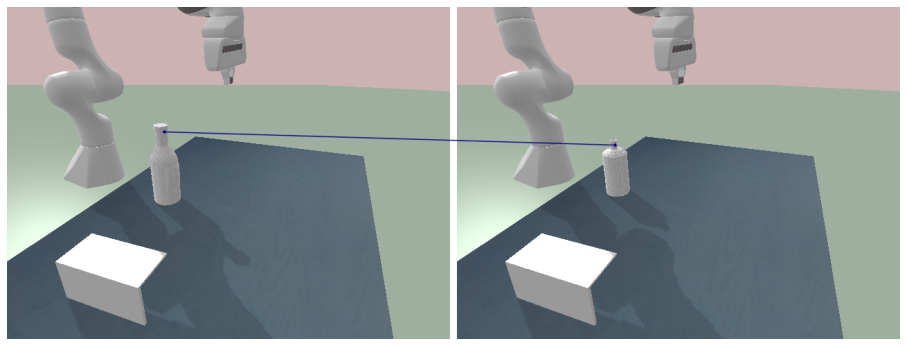

Saved!
Query image:  0018
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[232.29332 164.     ]]


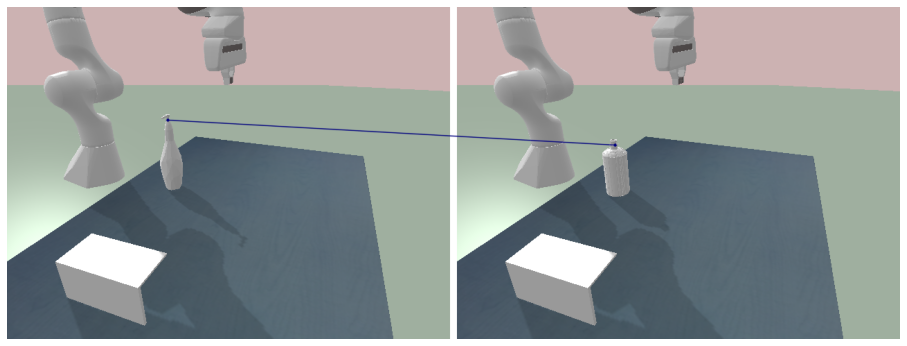

Saved!
Query image:  0010
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[272.05  167.825]]


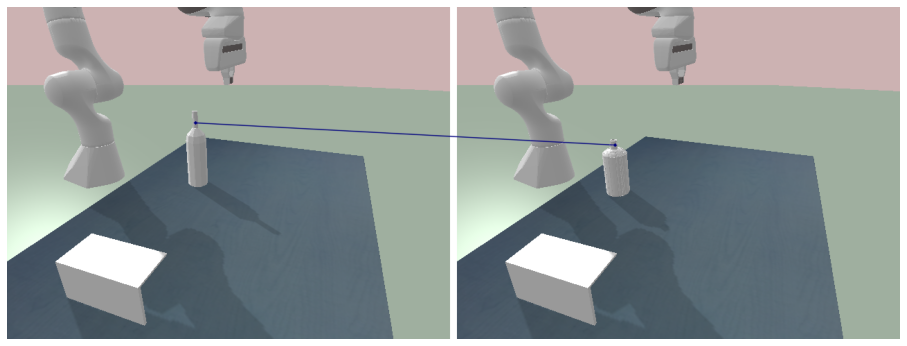

Saved!
Query image:  0009
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[224.48943 169.5    ]]


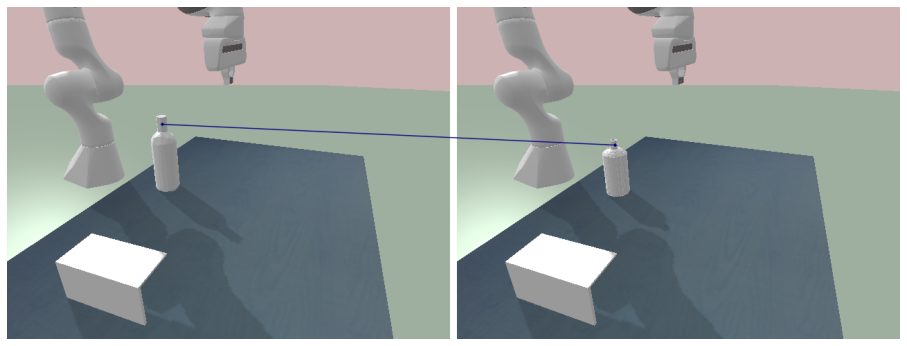

Saved!
Query image:  0003
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[237.62857 175.0678 ]]


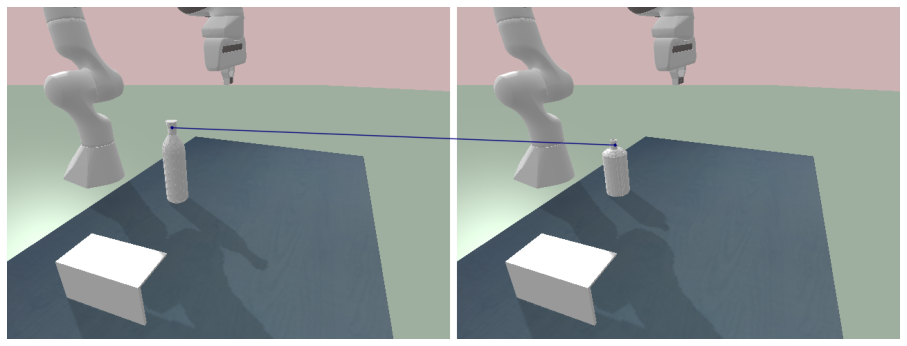

Saved!
Query image:  0024
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[220.5749 203.6875]]


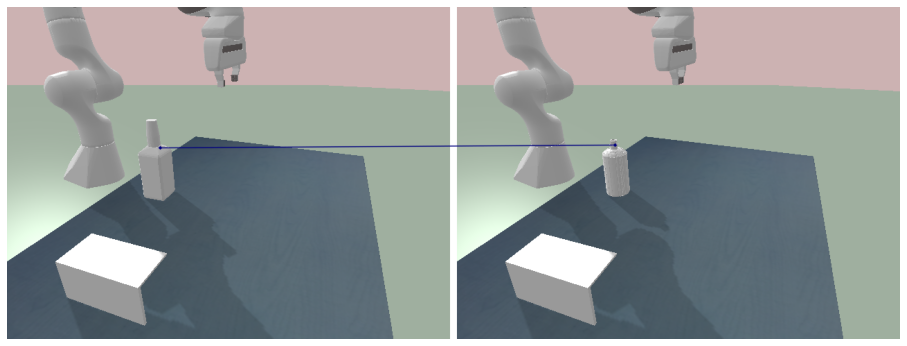

Saved!
Query image:  0013
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[237.31326 177.65   ]]


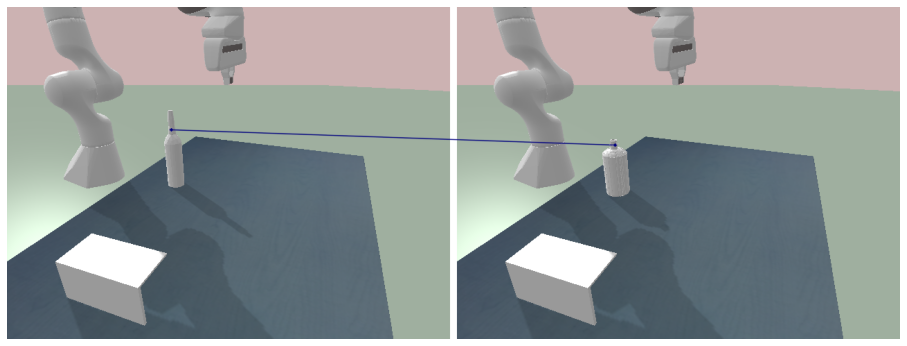

Saved!
Query image:  0005
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[199.50972 172.     ]]


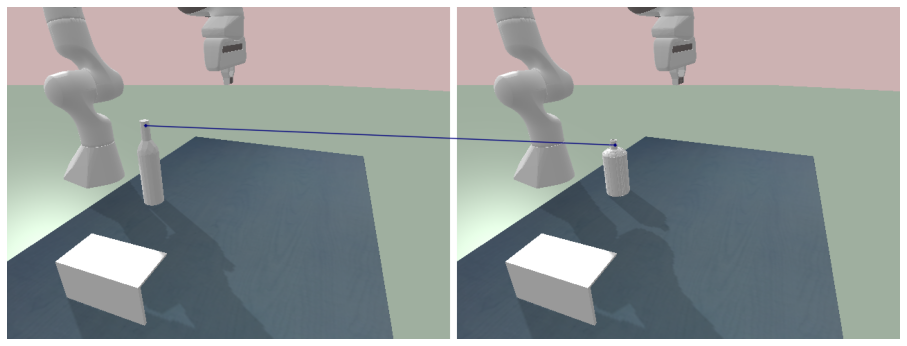

Saved!
Query image:  0012
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[252.72885 174.34958]]


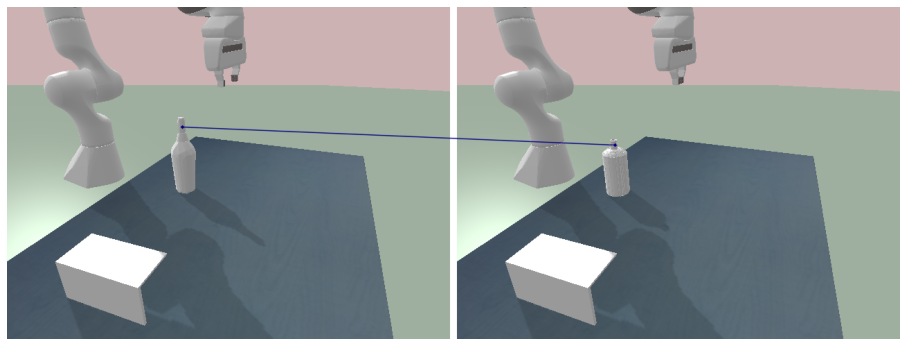

Saved!
Query image:  0019
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[221.70901 171.     ]]


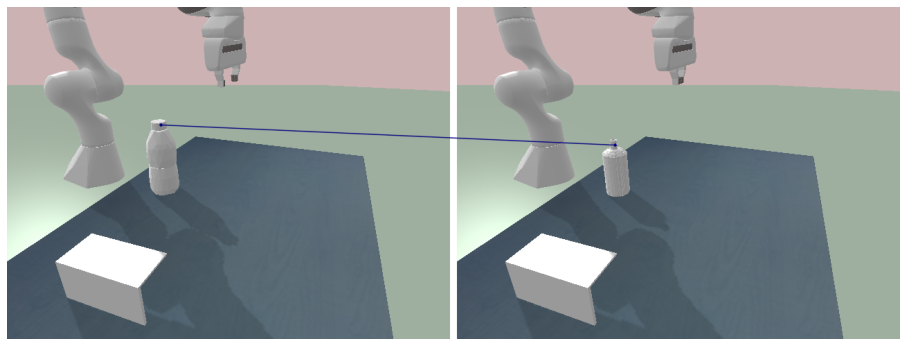

Saved!
Query image:  0016
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[247.05 203.  ]]


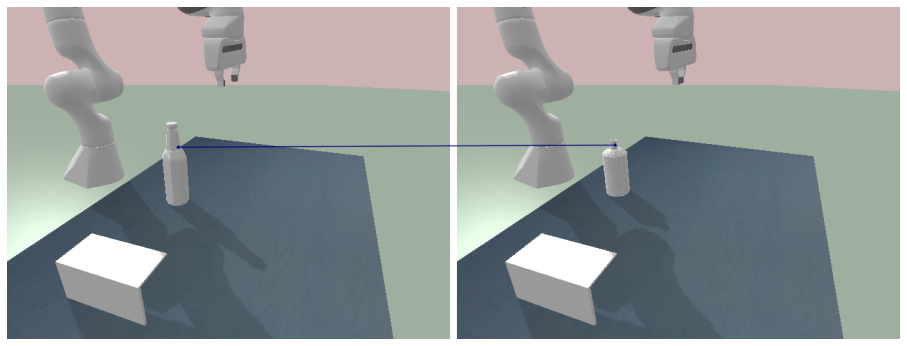

Saved!
Query image:  0011
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[228.2 175. ]]


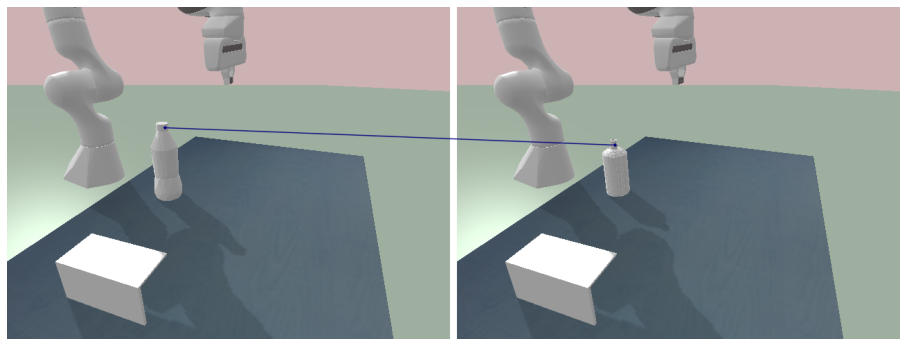

Saved!
Query image:  0007
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[251.25    179.15384]]


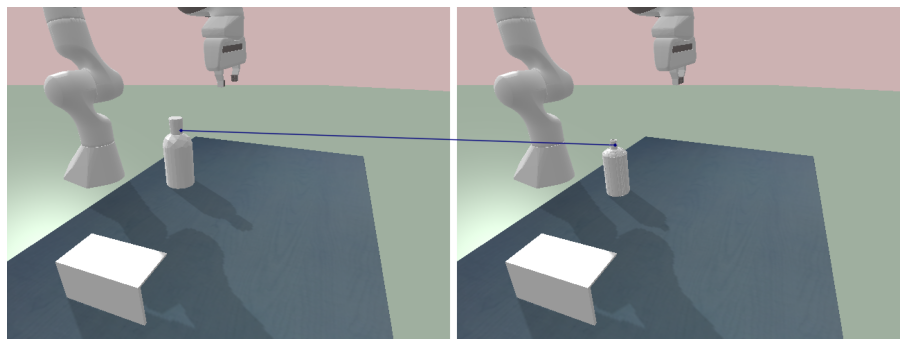

Saved!
Query image:  0020
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[248.175   196.72882]]


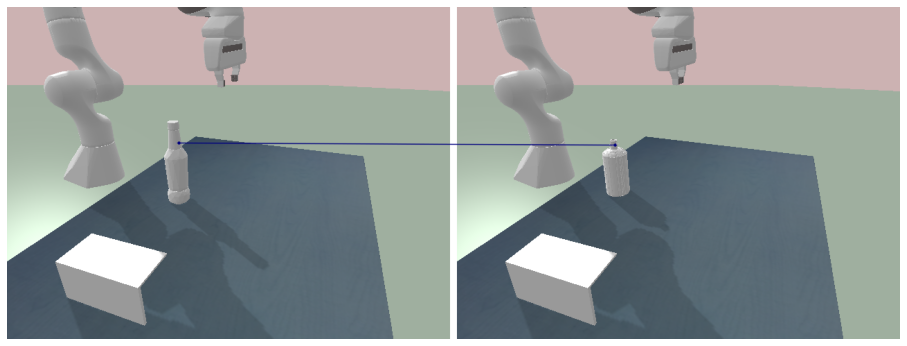

Saved!
Query image:  0022
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[229.28334 178.     ]]


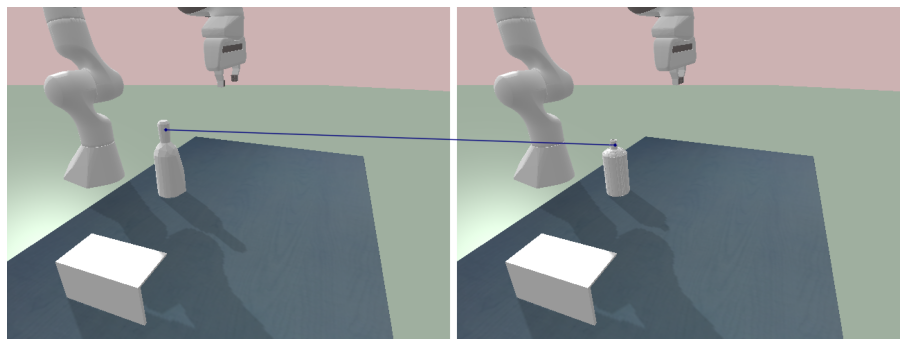

Saved!
Query image:  0017
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[225.09279 171.49619]]


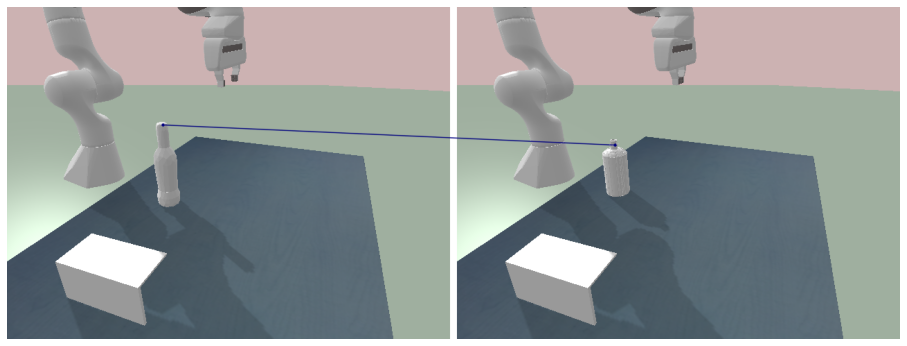

Saved!
Query image:  0014
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[231.5456  231.06021]]


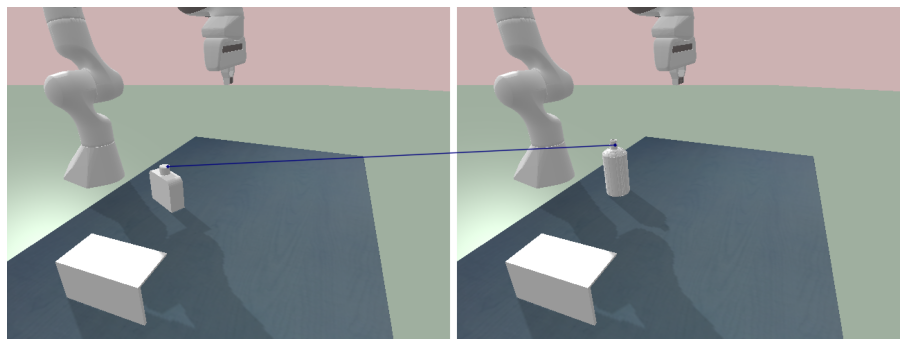

Saved!
Query image:  0023
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[233.74007 176.15475]]


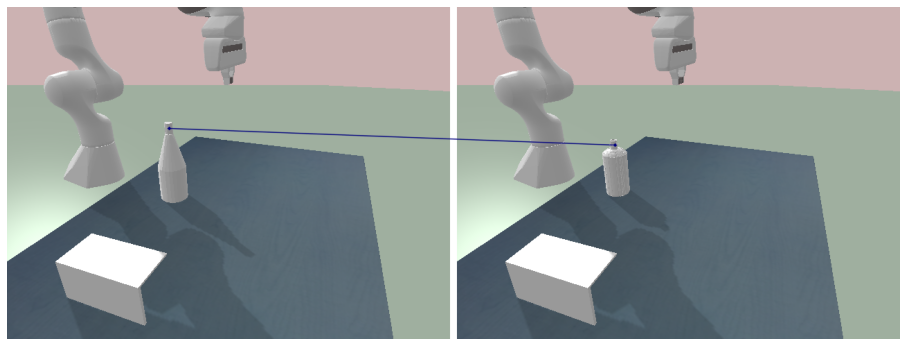

Saved!
Query image:  0004
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[243.5 178. ]]


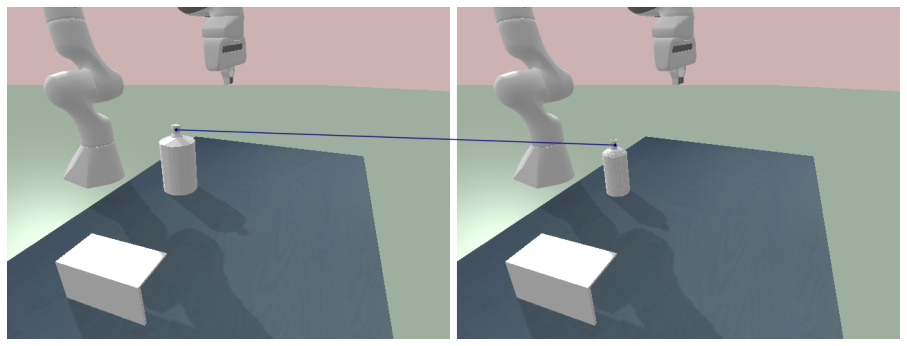

Saved!
Query image:  0026
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[208.97144 173.5625 ]]


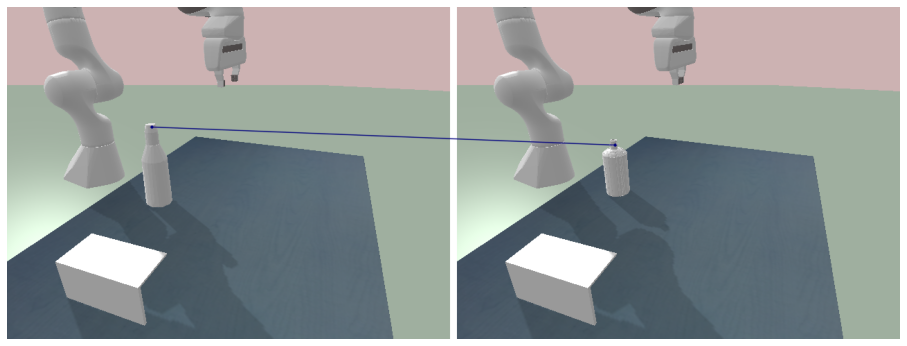

Saved!
Query image:  0008
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[243.63208 161.     ]]


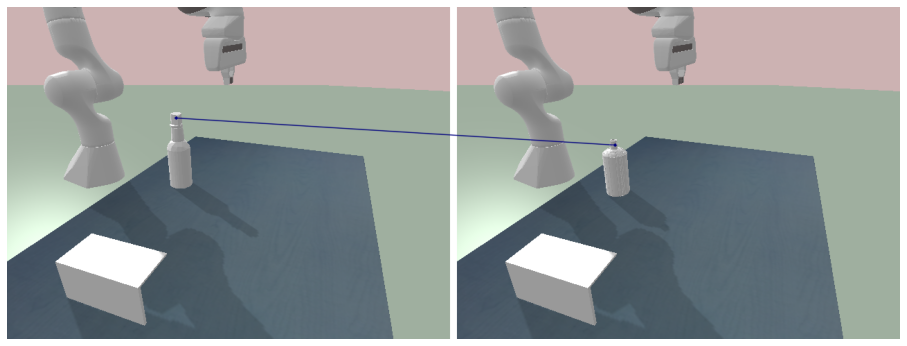

Saved!
Query image:  0027
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_cropped
Query contact points [[224.24492 191.5    ]]


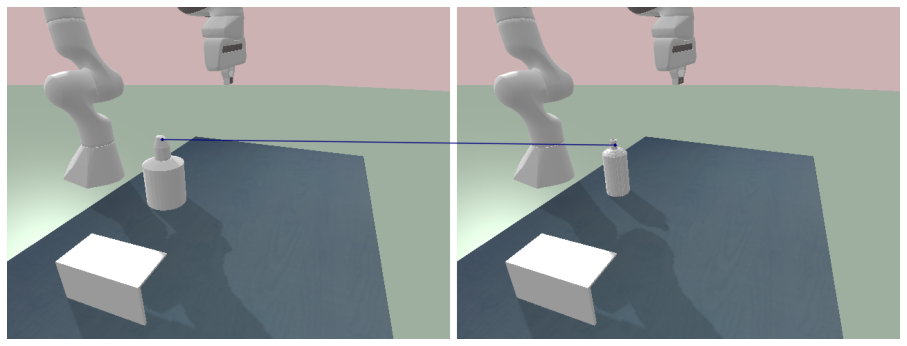

Saved!
Query image:  0006
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[219. 171.]]


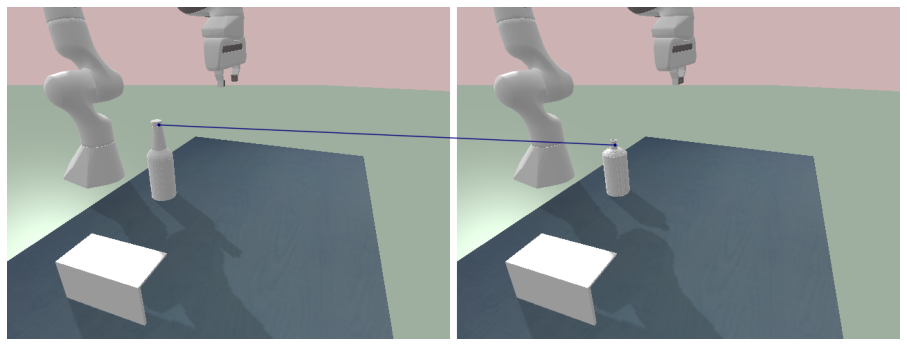

Saved!
Query image:  0002
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[224.75 170.  ]]


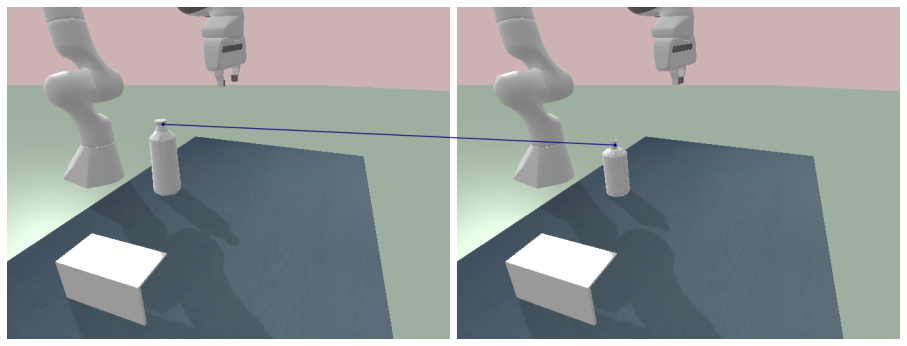

Saved!
Query image:  0001
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[223.2158 171.    ]]


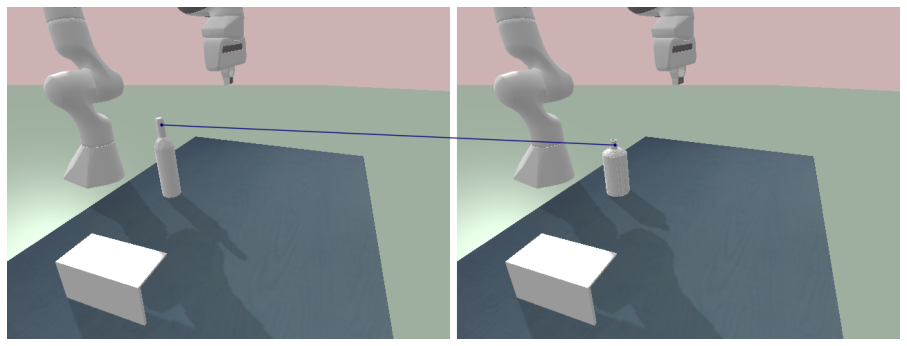

Saved!
Query image:  0015
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[232.05 171.  ]]


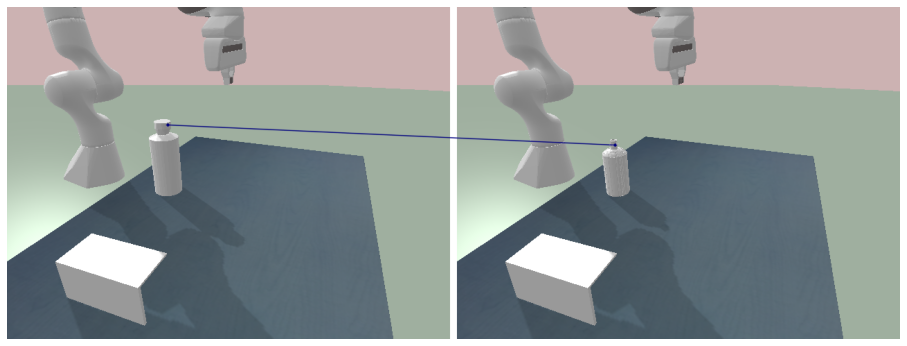

Saved!
Query image:  0025
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[242.20459 178.25   ]]


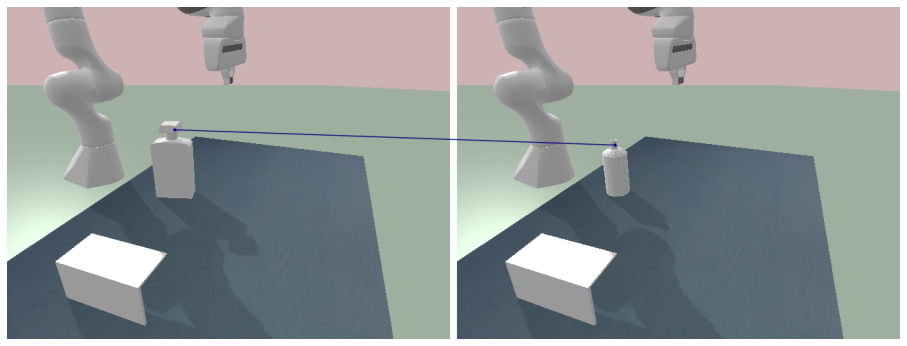

Saved!
Query image:  0021
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[246.75    196.92848]]


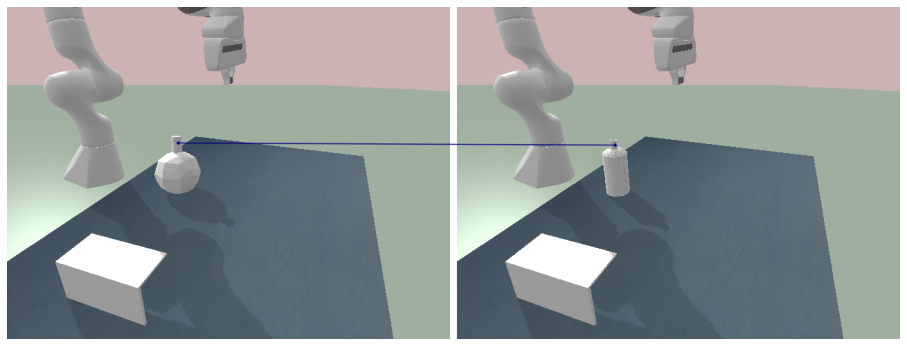

Saved!
Query image:  0000
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[226.72536 180.75   ]]


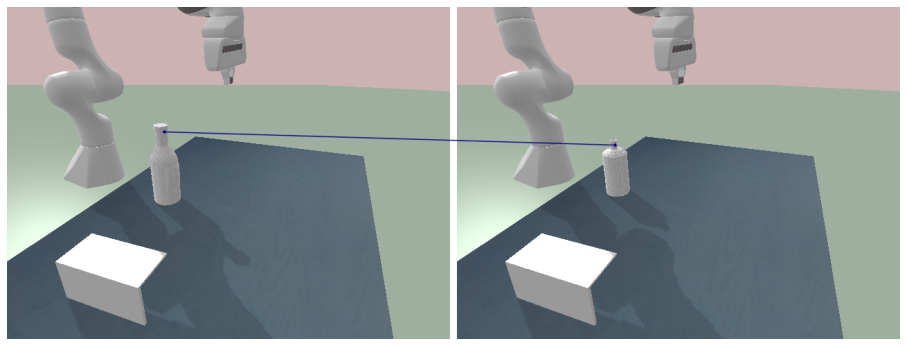

Saved!
Query image:  0018
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[232.1 164. ]]


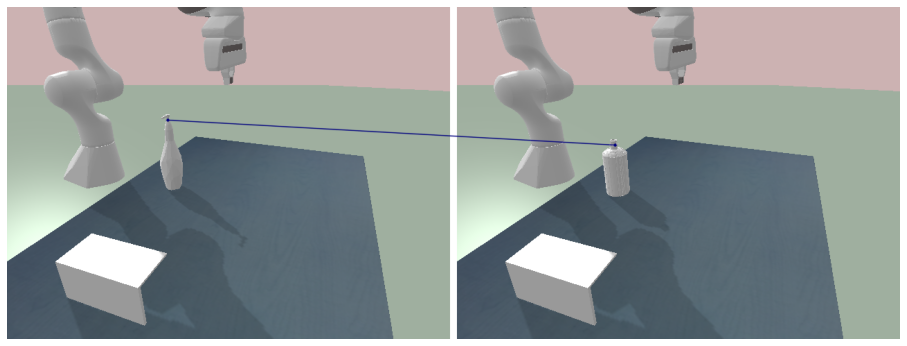

Saved!
Query image:  0010
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[272.05 163.75]]


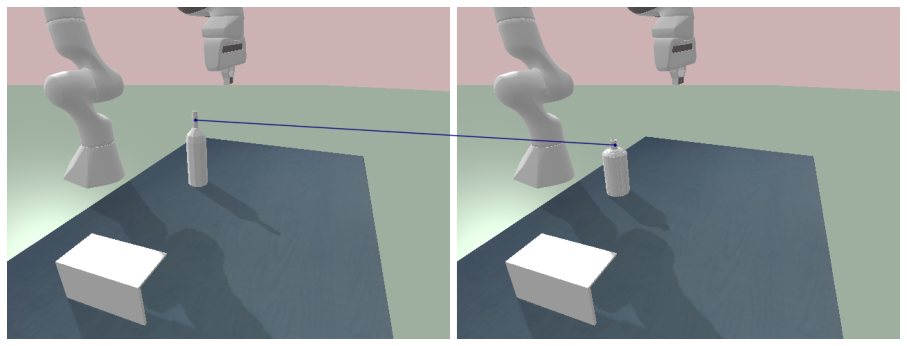

Saved!
Query image:  0009
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[225.   167.25]]


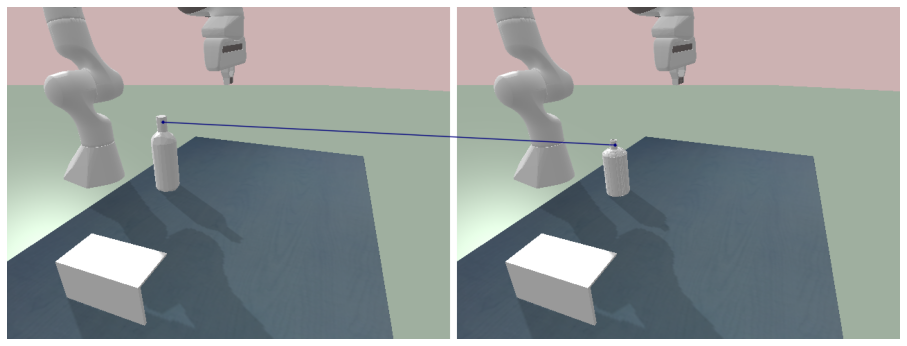

Saved!
Query image:  0003
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[240.57857 173.     ]]


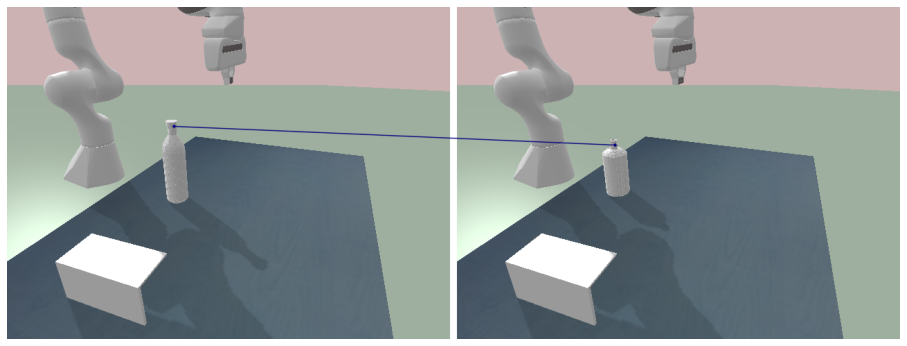

Saved!
Query image:  0024
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[213.3     174.98373]]


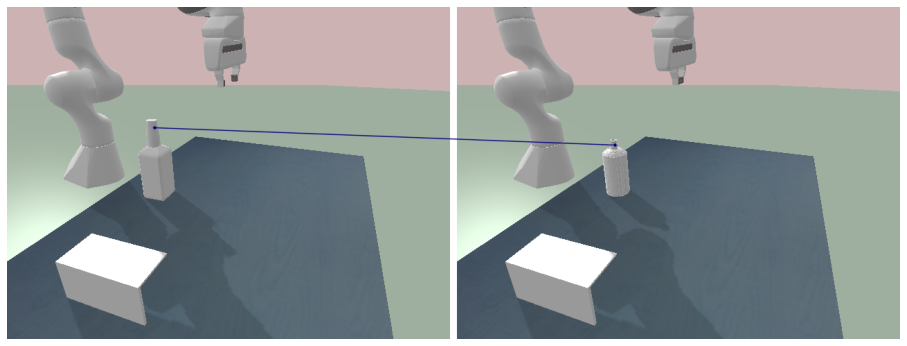

Saved!
Query image:  0013
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[238.1   164.375]]


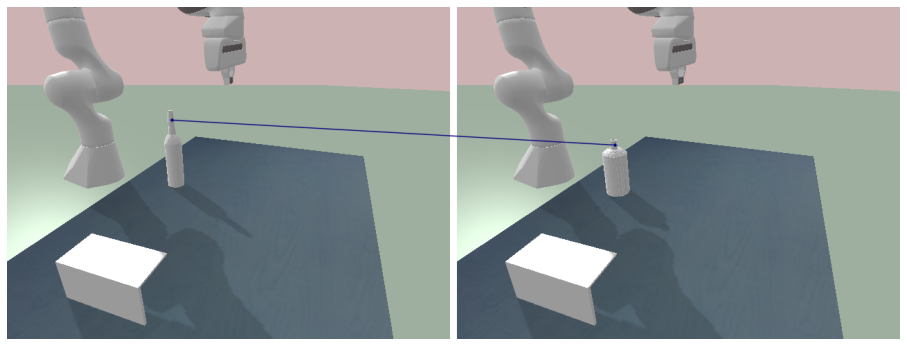

Saved!
Query image:  0005
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[202.05 172.  ]]


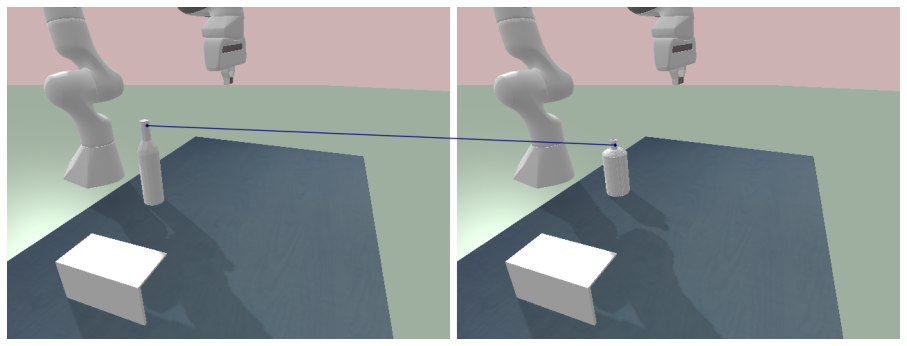

Saved!
Query image:  0012
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[254.      171.69916]]


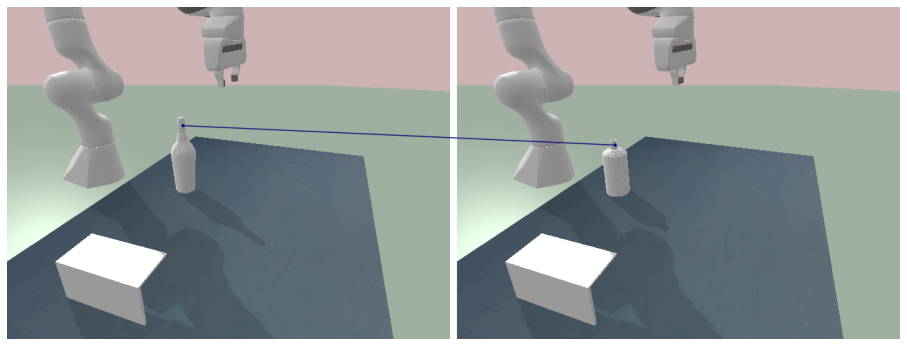

Saved!
Query image:  0019
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[223.725 171.   ]]


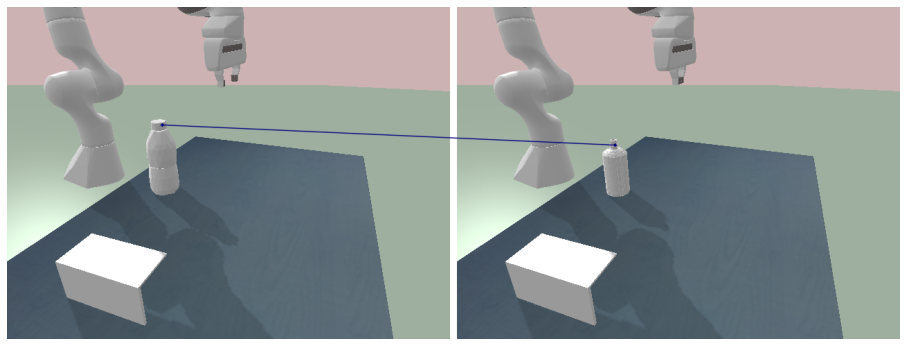

Saved!
Query image:  0016
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[241. 175.]]


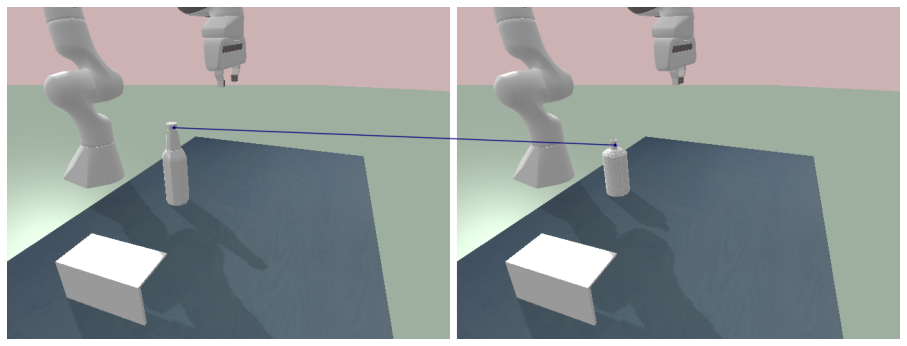

Saved!
Query image:  0011
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[228.2 175. ]]


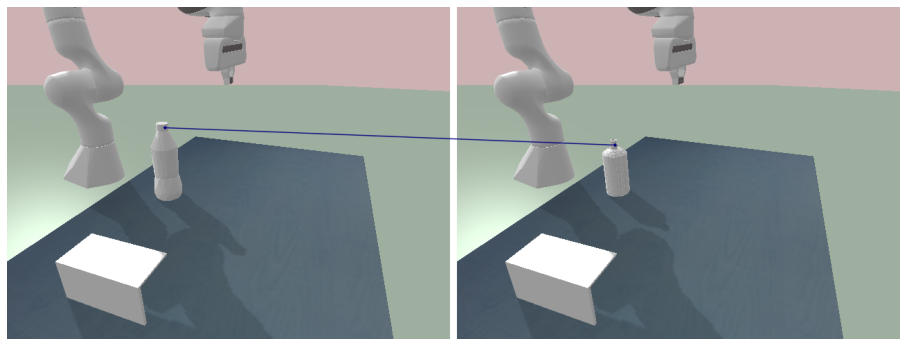

Saved!
Query image:  0007
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[248.31451 172.88461]]


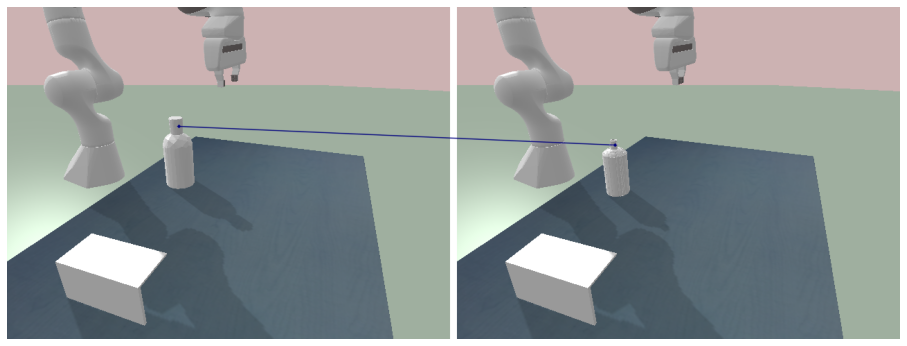

Saved!
Query image:  0020
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[244. 173.]]


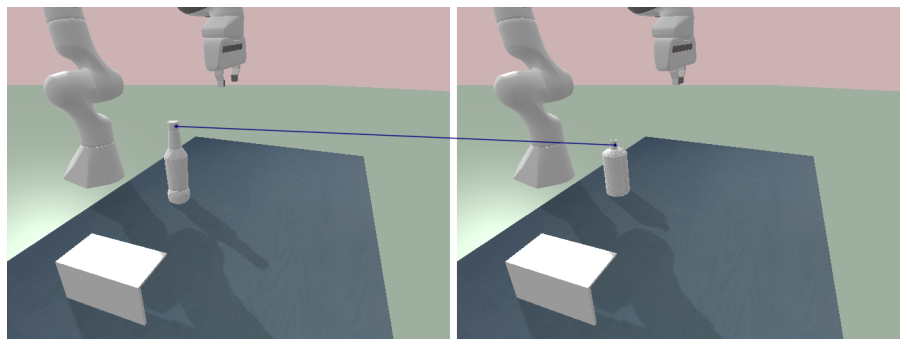

Saved!
Query image:  0022
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[229.16667 178.     ]]


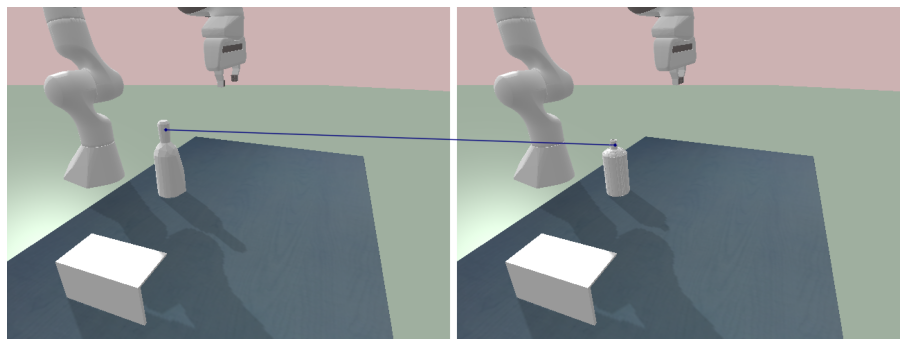

Saved!
Query image:  0017
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[225.83116 177.25   ]]


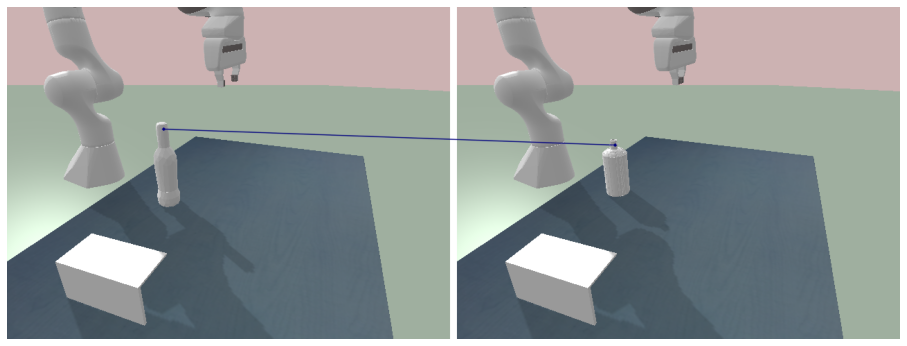

Saved!
Query image:  0014
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[232.65 236.  ]]


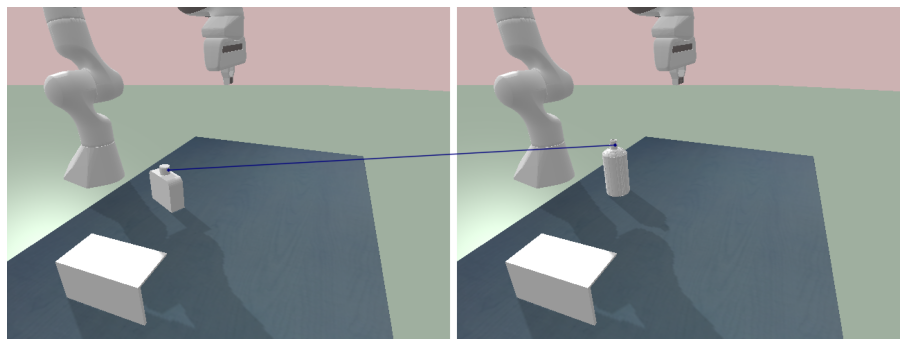

Saved!
Query image:  0023
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[235.  176.5]]


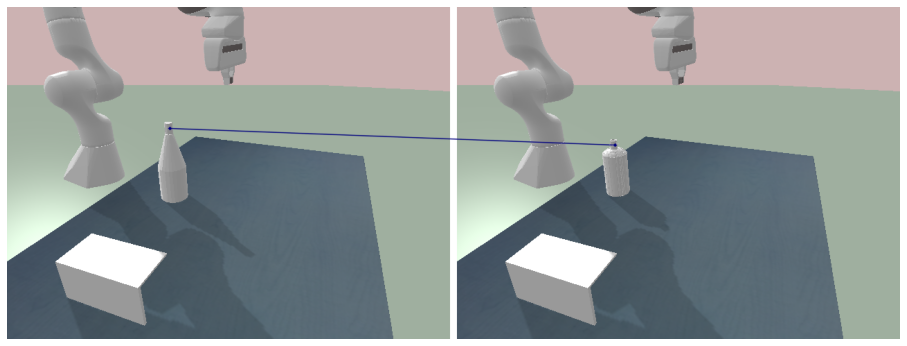

Saved!
Query image:  0004
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[246.625 178.   ]]


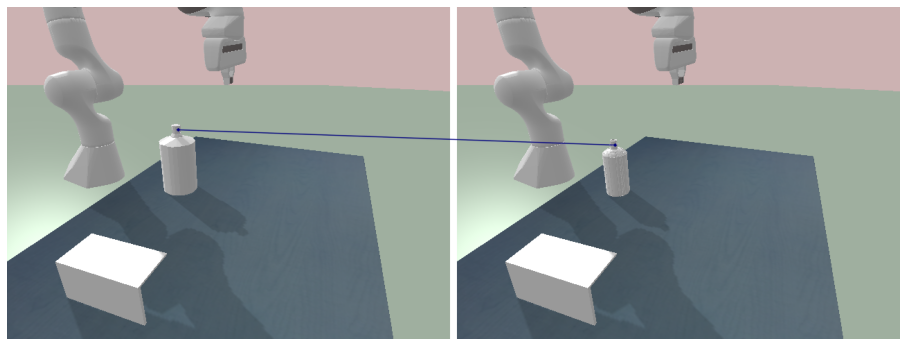

Saved!
Query image:  0026
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[211.45714 179.09375]]


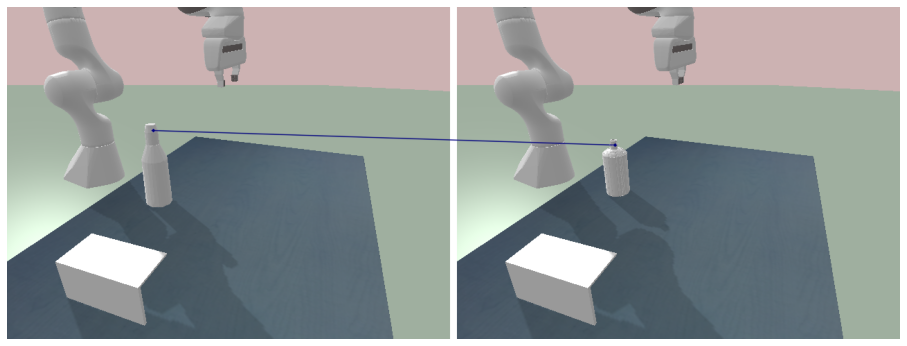

Saved!
Query image:  0008
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[248.19331 170.5    ]]


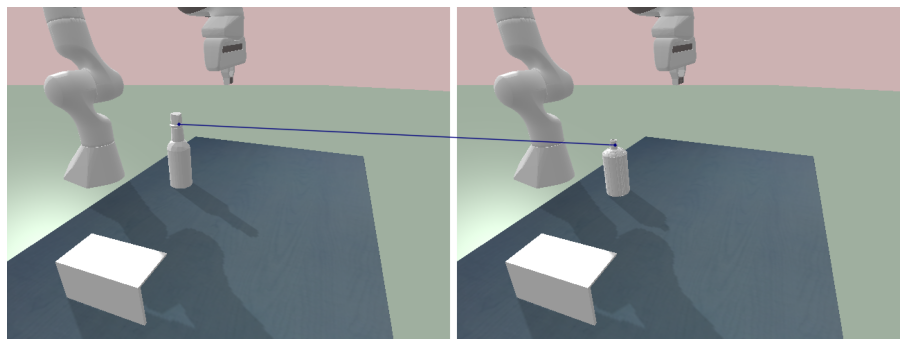

Saved!
Query image:  0027
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_SS_pfpascal_precrop
Query contact points [[226.07109 201.5    ]]


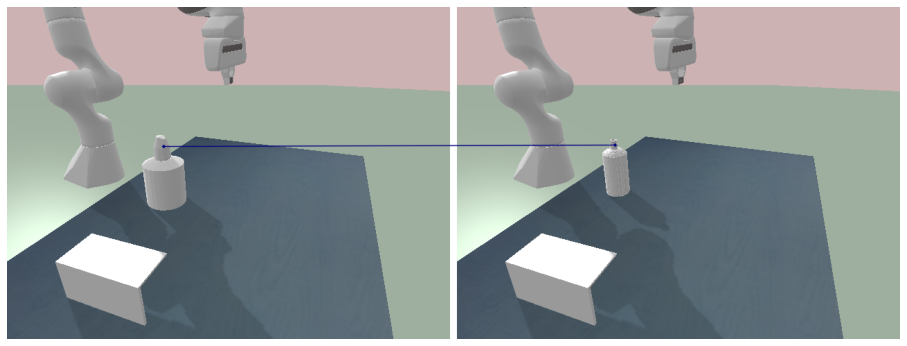

Saved!
Query image:  0006
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[219.     171.8492]]


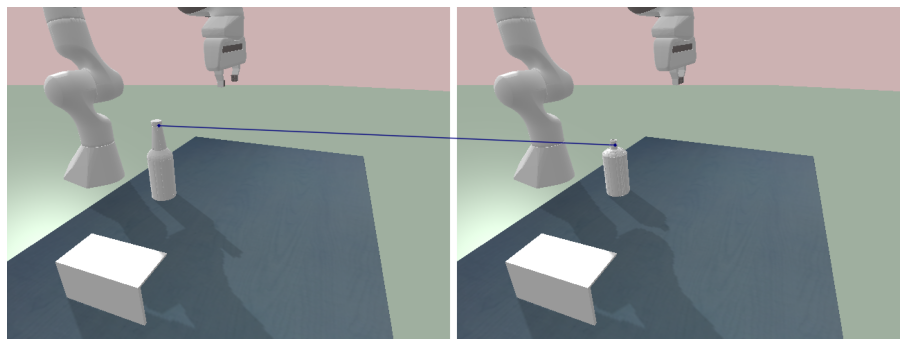

Saved!
Query image:  0002
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[224.75   172.8625]]


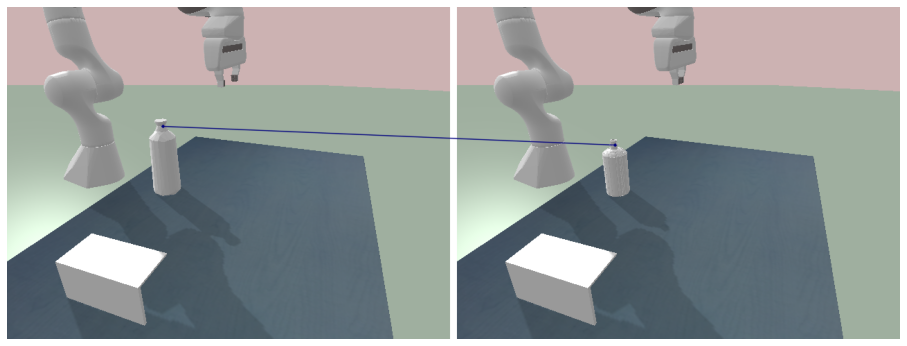

Saved!
Query image:  0001
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[223.2158 176.3   ]]


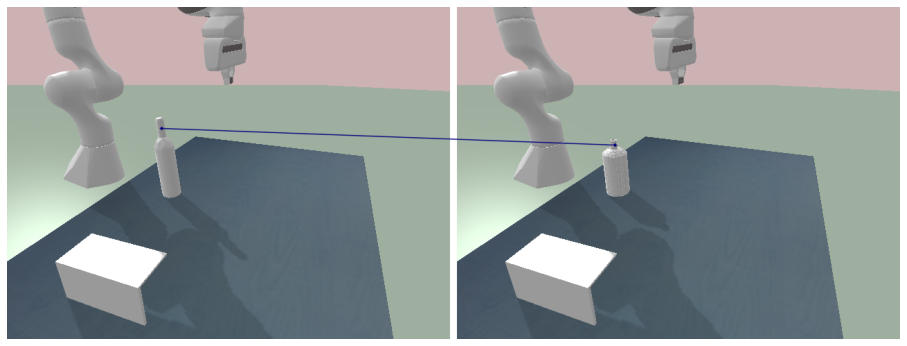

Saved!
Query image:  0015
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[218.9875 177.5   ]]


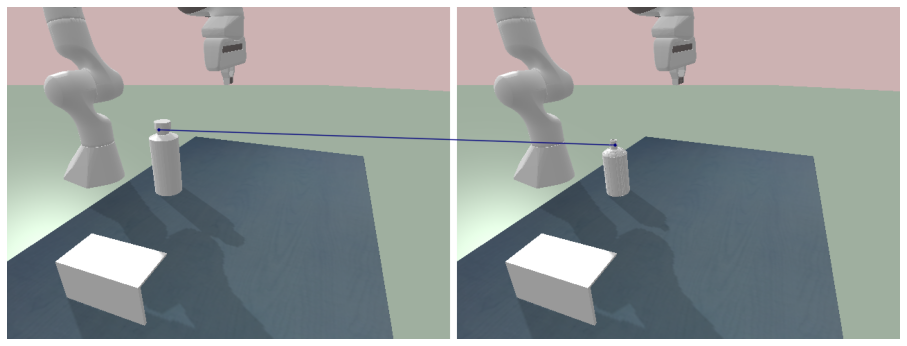

Saved!
Query image:  0025
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[236.93512 186.88928]]


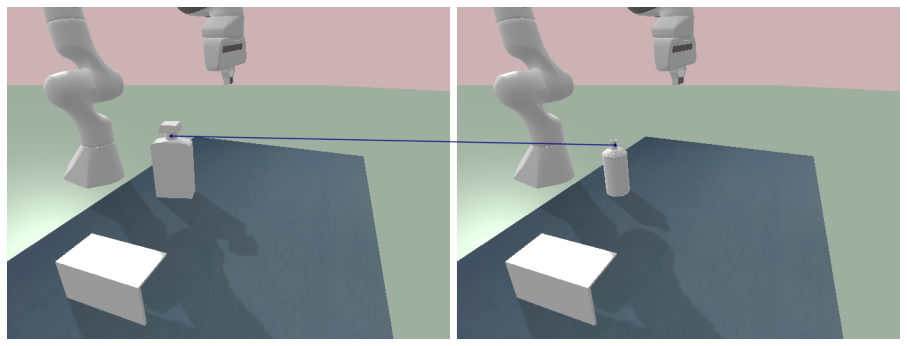

Saved!
Query image:  0021
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[246.75 200.15]]


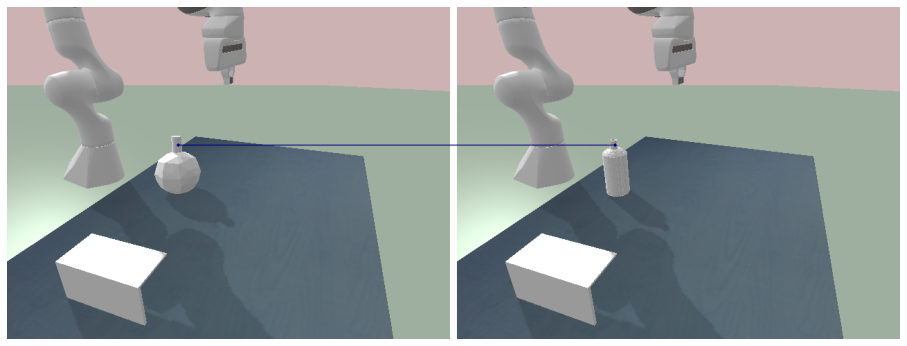

Saved!
Query image:  0000
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[226.25435 185.26718]]


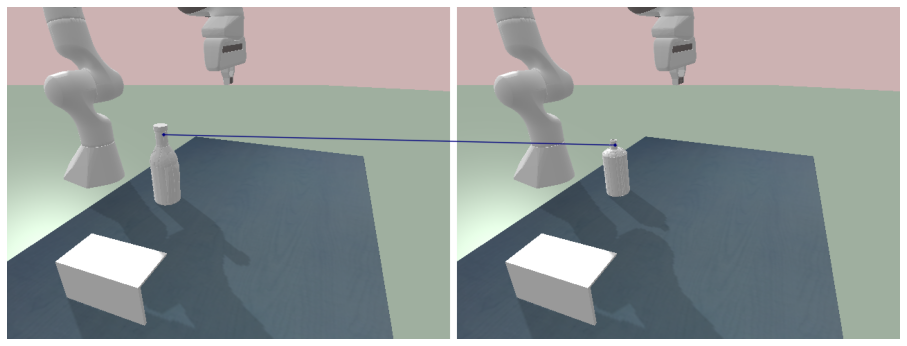

Saved!
Query image:  0018
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[233.18625 171.125  ]]


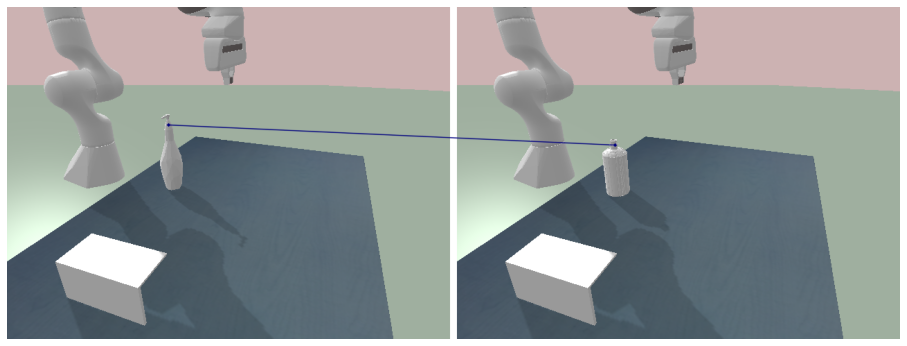

Saved!
Query image:  0010
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[272.05 165.45]]


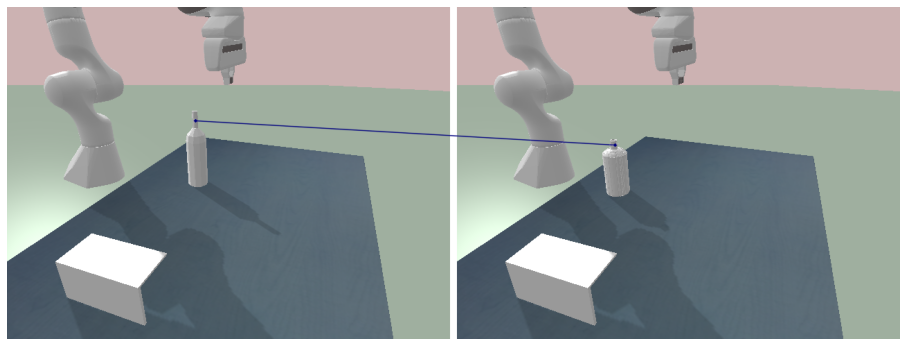

Saved!
Query image:  0009
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[225.  171.5]]


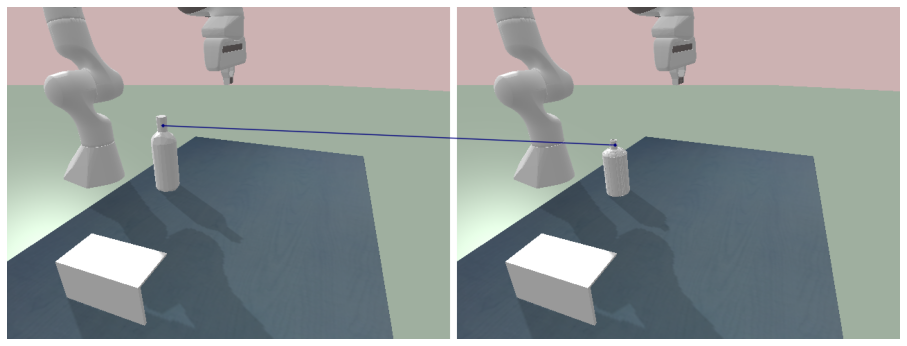

Saved!
Query image:  0003
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[238.05 179.  ]]


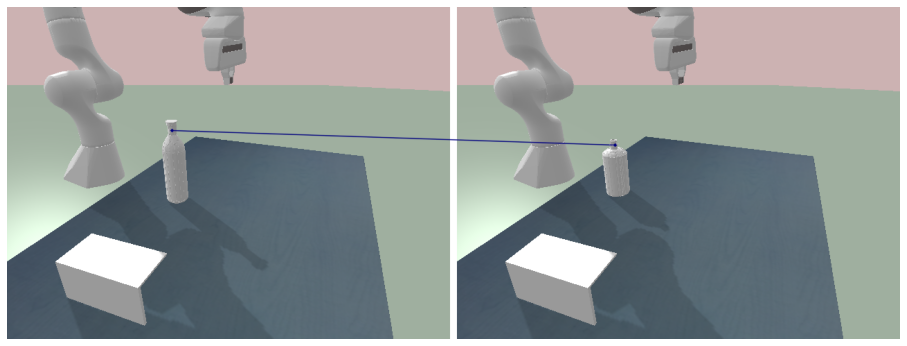

Saved!
Query image:  0024
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[209.9     157.14503]]


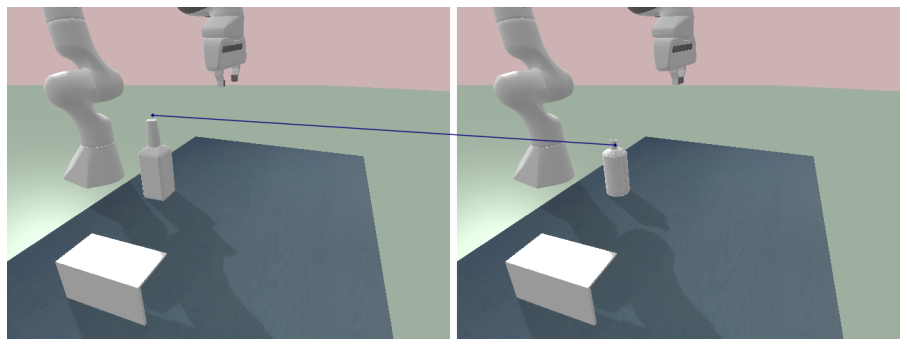

Saved!
Query image:  0013
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[238.1   166.675]]


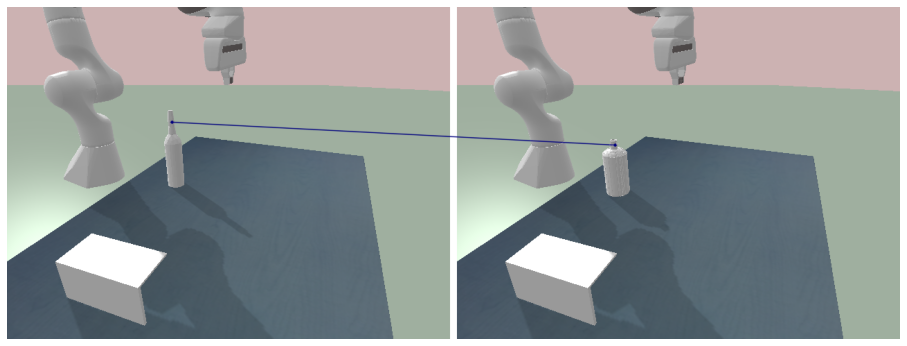

Saved!
Query image:  0005
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[201.56146 178.7    ]]


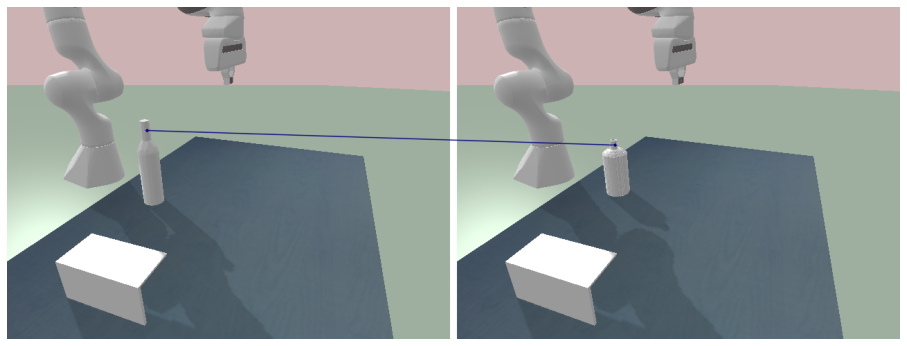

Saved!
Query image:  0012
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[253.16058 174.90042]]


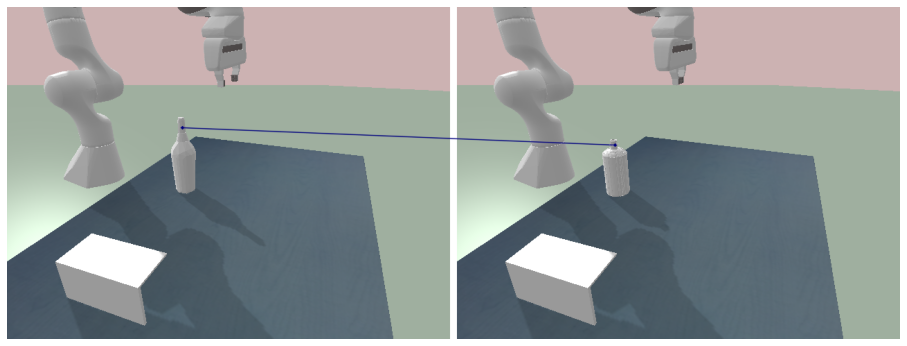

Saved!
Query image:  0019
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[221.60852 172.186  ]]


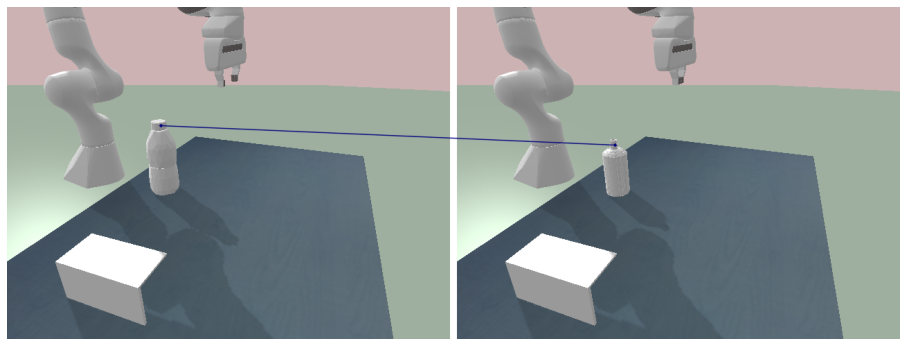

Saved!
Query image:  0016
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[241.84286 178.     ]]


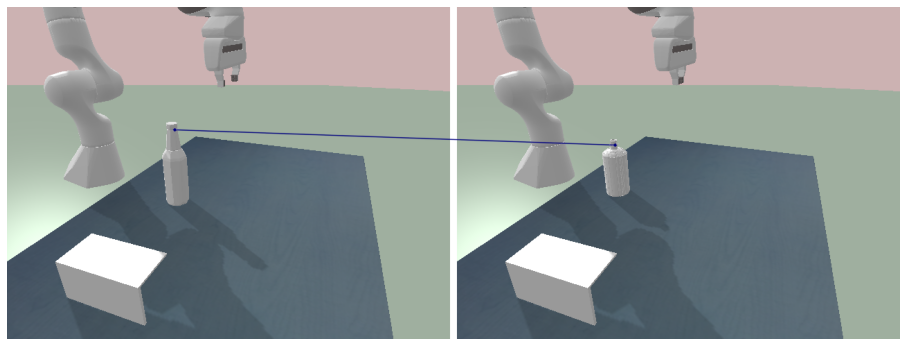

Saved!
Query image:  0011
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[228.2 175. ]]


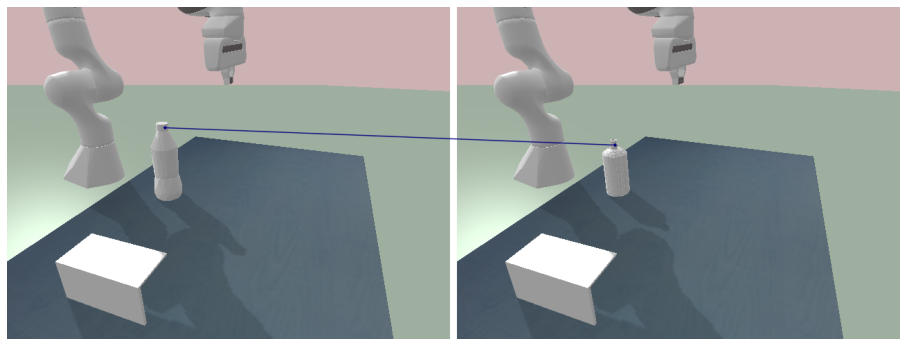

Saved!
Query image:  0007
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[248.25 173.2 ]]


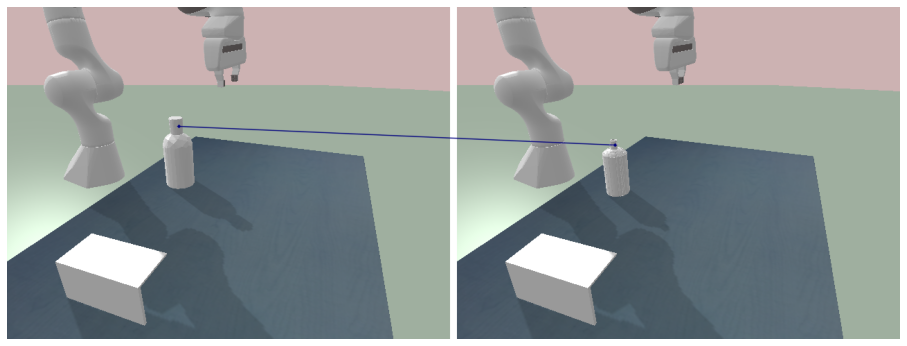

Saved!
Query image:  0020
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[244.34644 181.82204]]


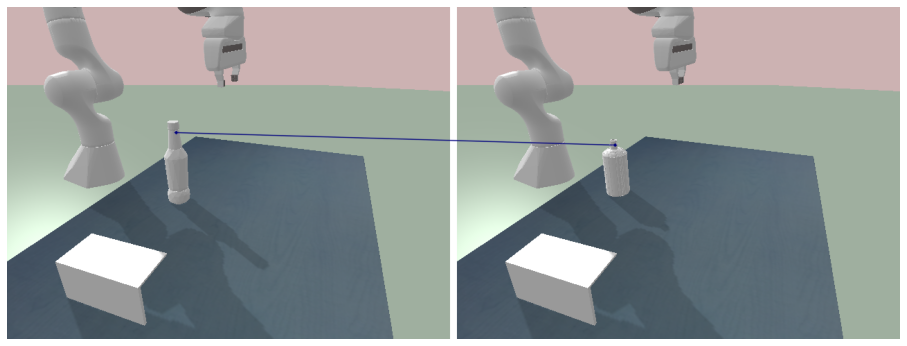

Saved!
Query image:  0022
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[229.  185.2]]


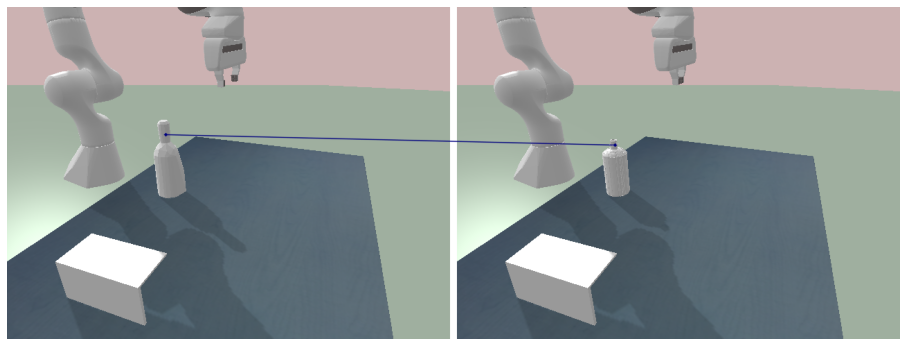

Saved!
Query image:  0017
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[227.53046 189.2    ]]


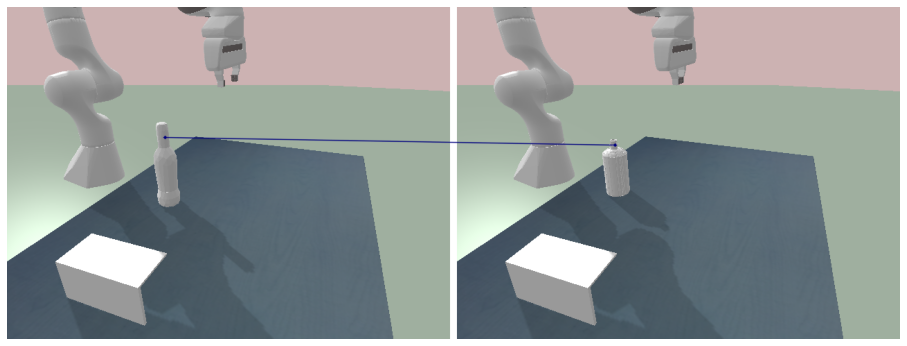

Saved!
Query image:  0014
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[229.74559 225.94049]]


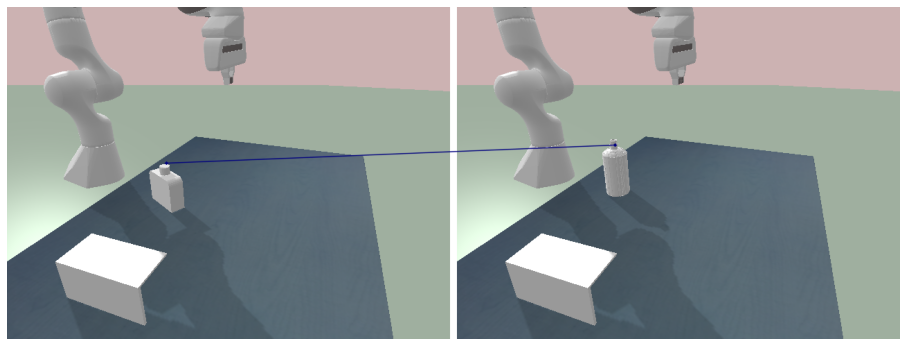

Saved!
Query image:  0023
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[235.      180.58015]]


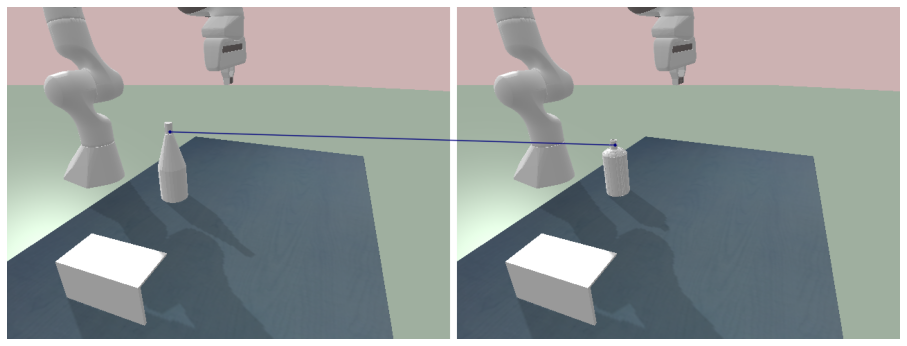

Saved!
Query image:  0004
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[244.96004 178.     ]]


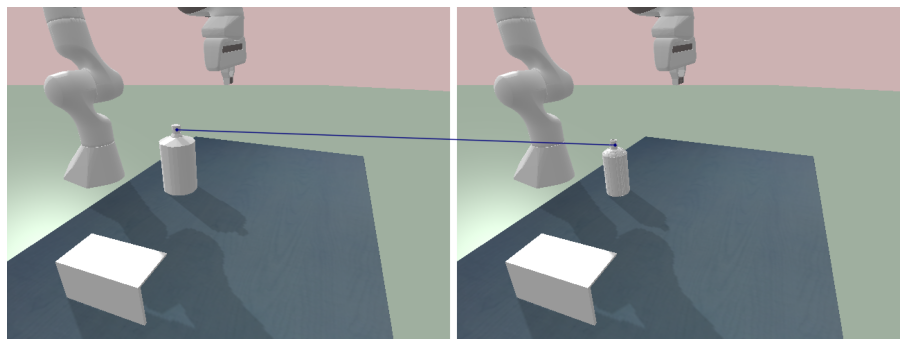

Saved!
Query image:  0026
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[208.14285 184.53125]]


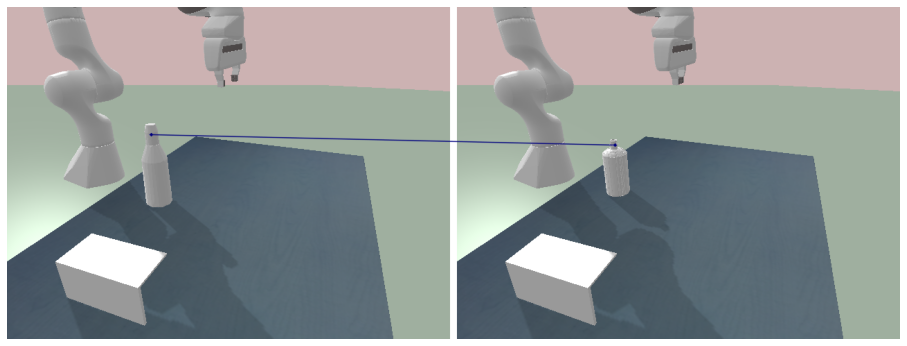

Saved!
Query image:  0008
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[247.475   167.02733]]


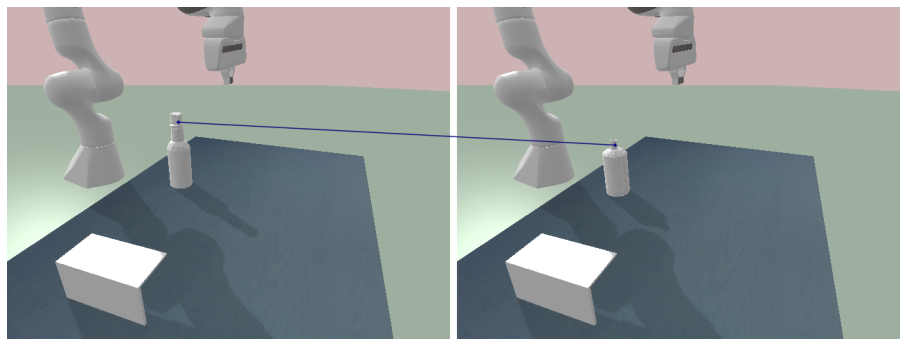

Saved!
Query image:  0027
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_WS_pfpascal_precrop
Query contact points [[226.29297 212.70663]]


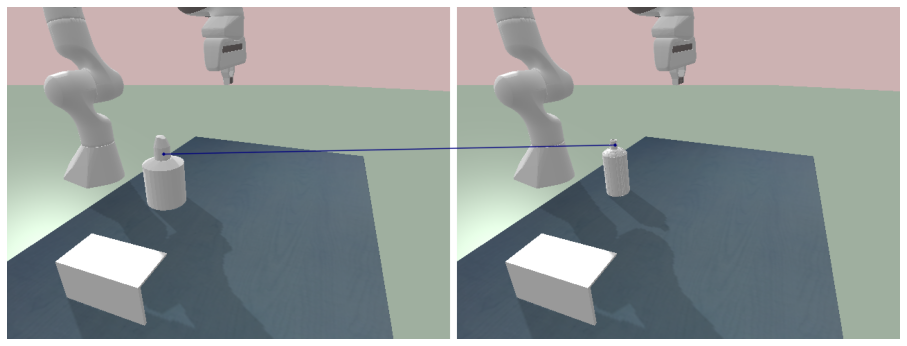

Saved!
Query image:  0006
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[217.83286 164.11209]]


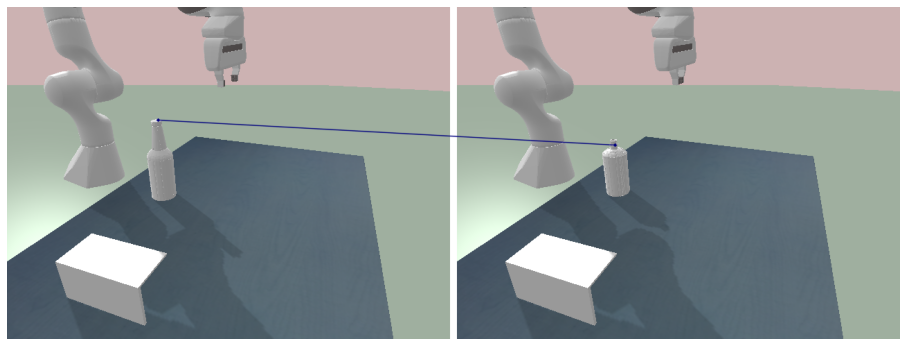

Saved!
Query image:  0002
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[224.75 170.  ]]


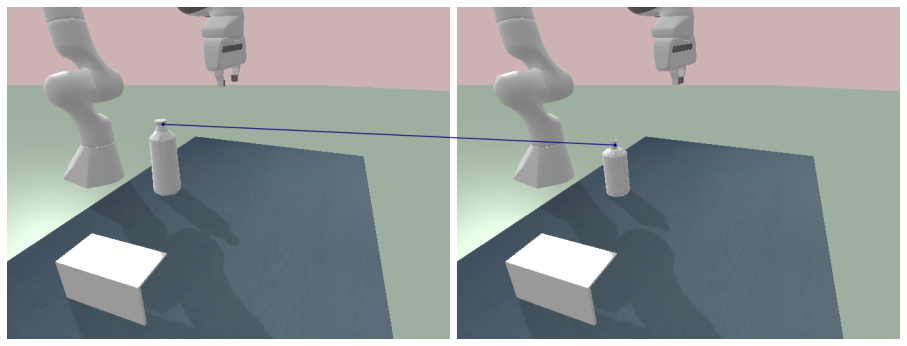

Saved!
Query image:  0001
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[223.50919 171.94322]]


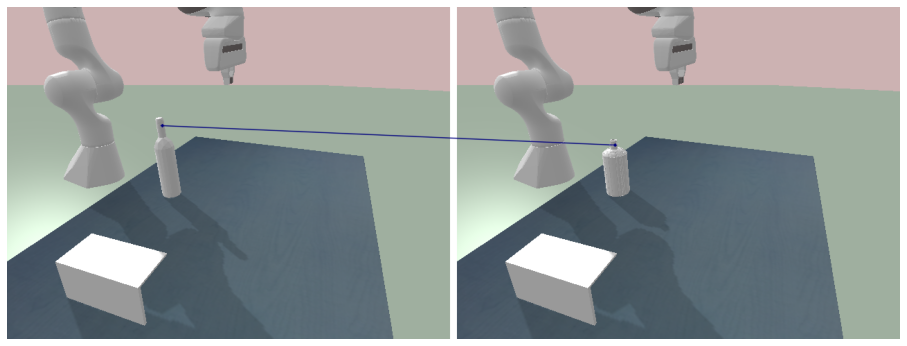

Saved!
Query image:  0015
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[229.06537 177.5    ]]


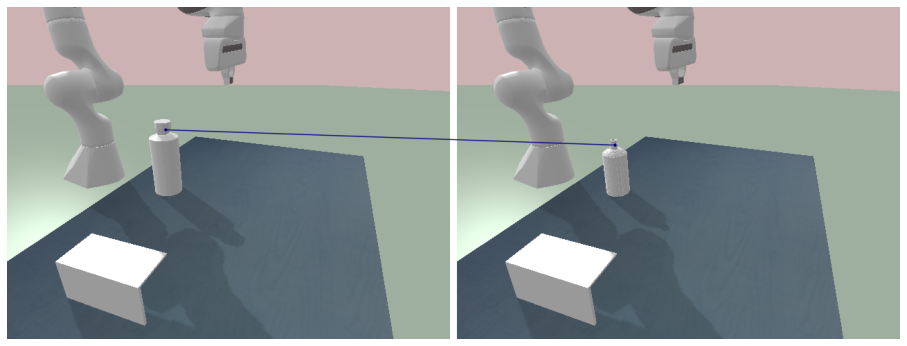

Saved!
Query image:  0025
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[226.69771 187.1    ]]


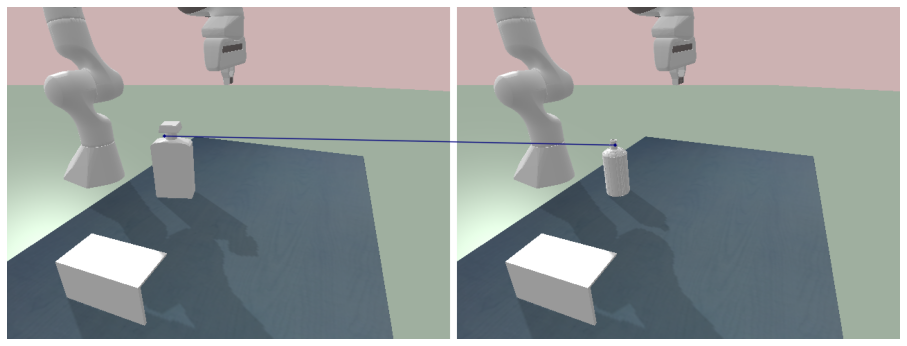

Saved!
Query image:  0021
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[246.3949 195.475 ]]


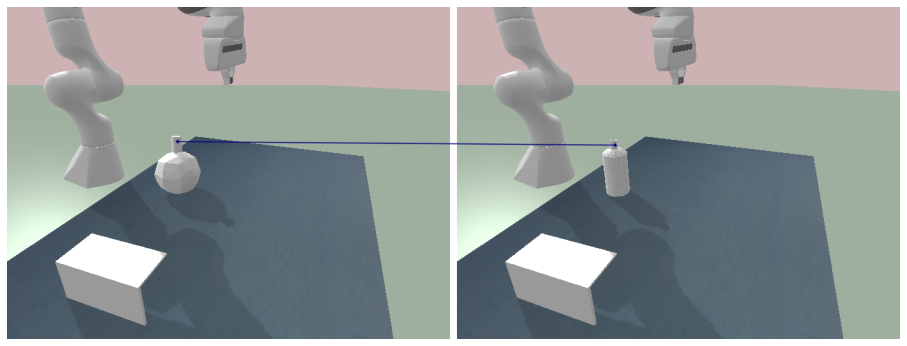

Saved!
Query image:  0000
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[224.15942 169.97968]]


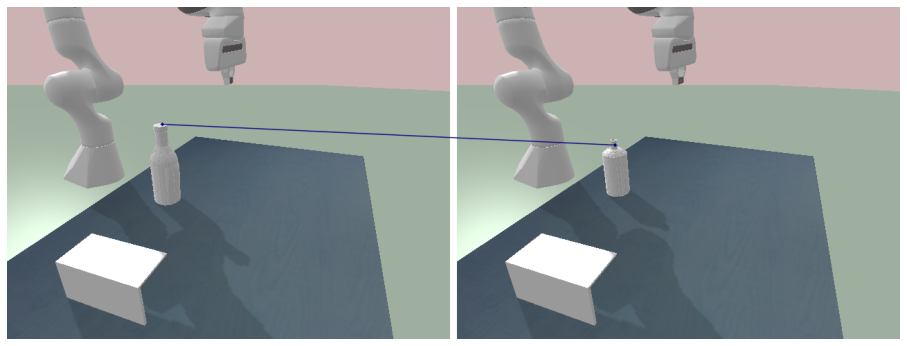

Saved!
Query image:  0018
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[230.56793 164.     ]]


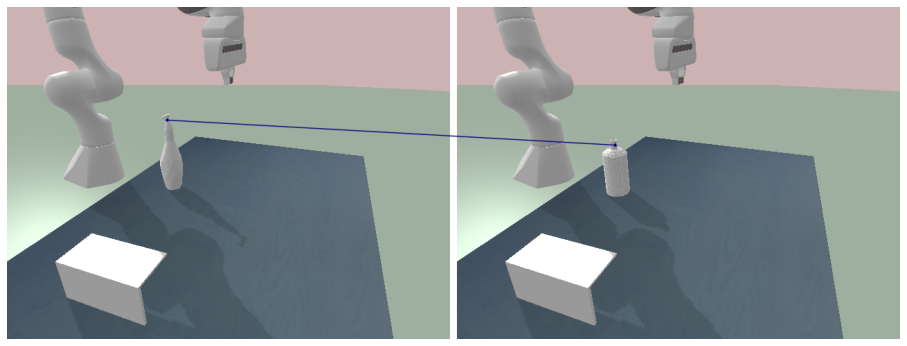

Saved!
Query image:  0010
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[272.05    159.42267]]


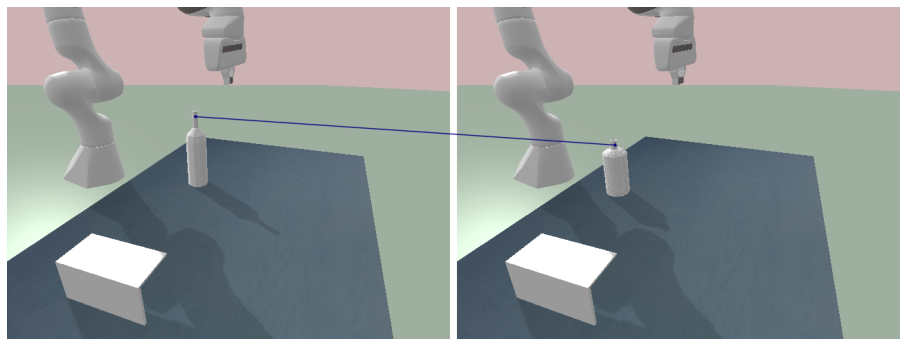

Saved!
Query image:  0009
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[225.1 171.5]]


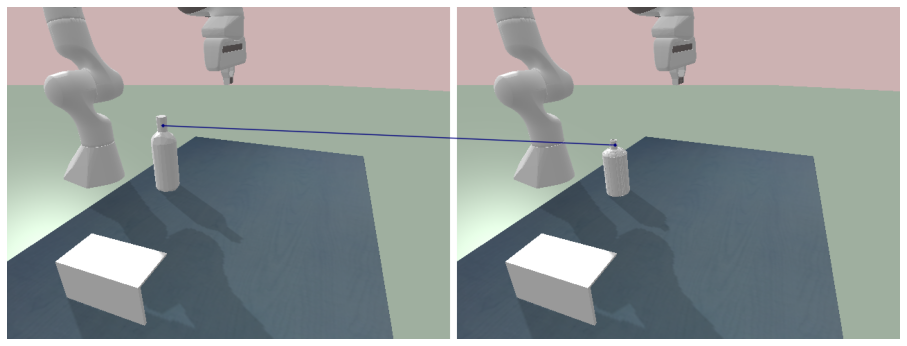

Saved!
Query image:  0003
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[240.12857 173.24576]]


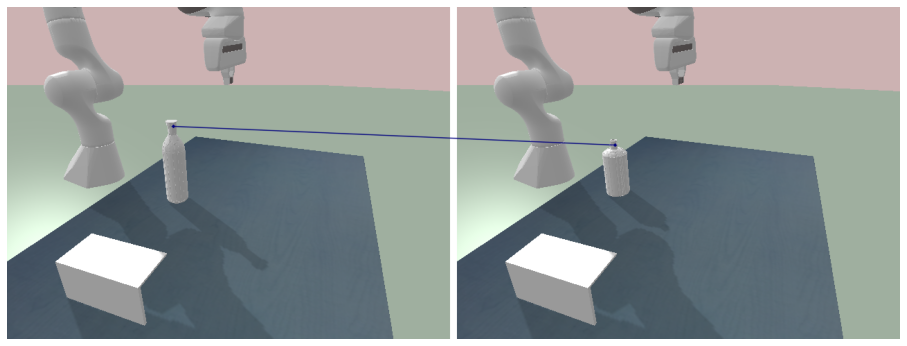

Saved!
Query image:  0024
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[209.1427  165.92499]]


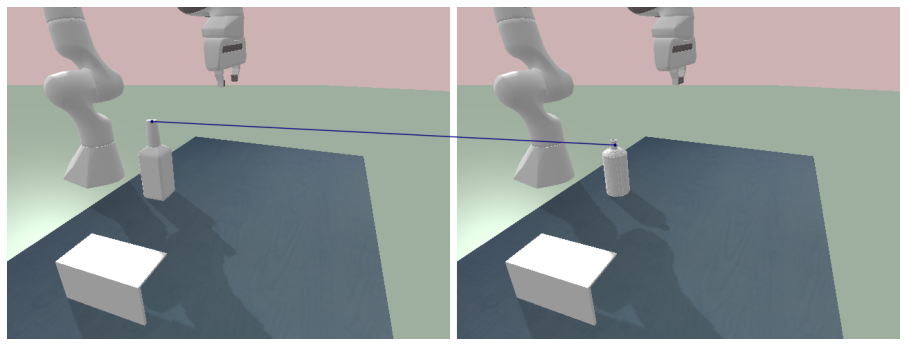

Saved!
Query image:  0013
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[238.1    168.0125]]


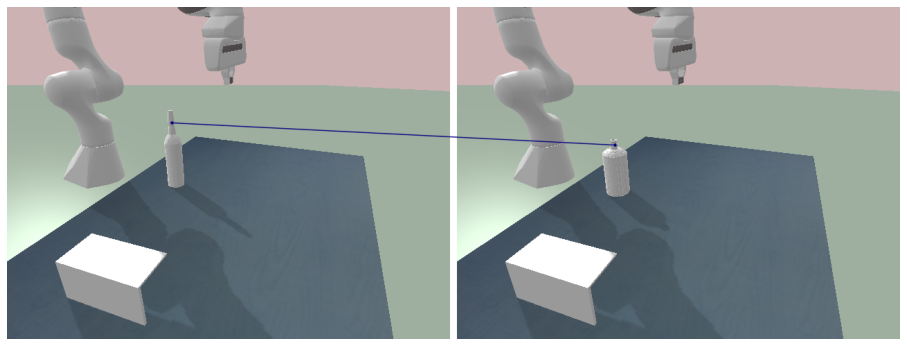

Saved!
Query image:  0005
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[199.75694 171.17796]]


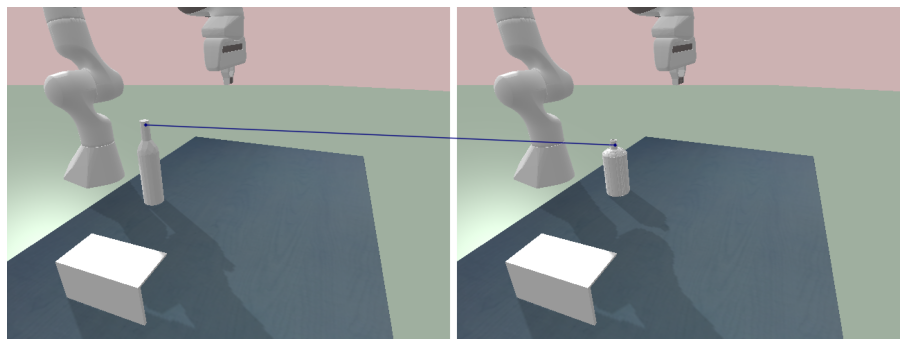

Saved!
Query image:  0012
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[253.81827 168.80084]]


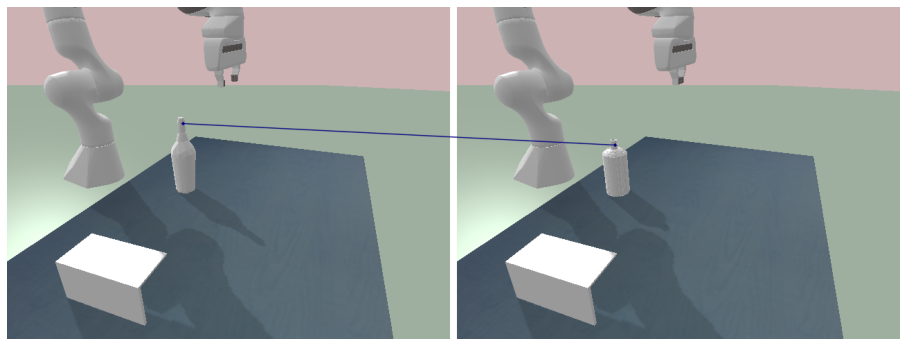

Saved!
Query image:  0019
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[224.7 171. ]]


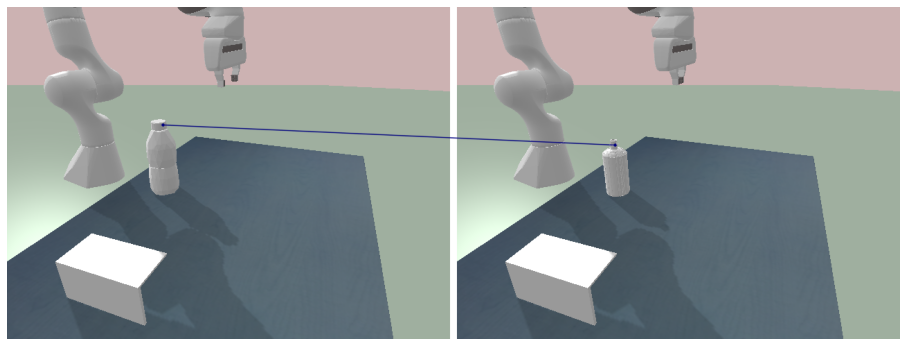

Saved!
Query image:  0016
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[241.91786 178.17798]]


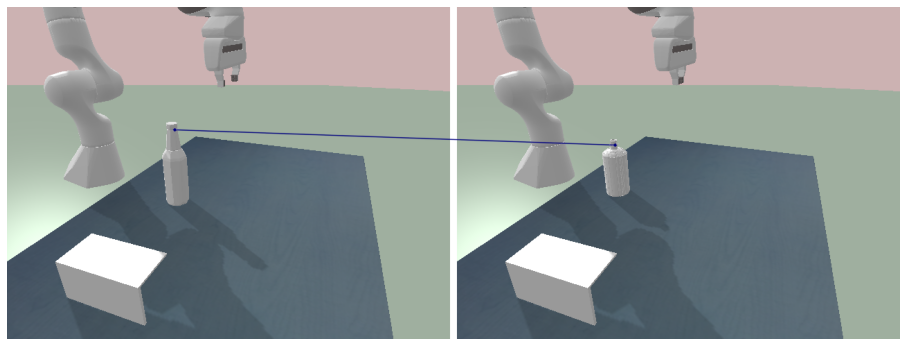

Saved!
Query image:  0011
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[228.2 175. ]]


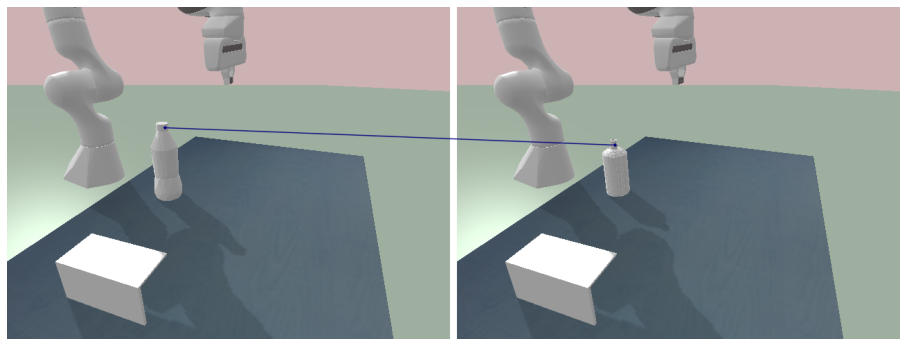

Saved!
Query image:  0007
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[242.03629 166.96922]]


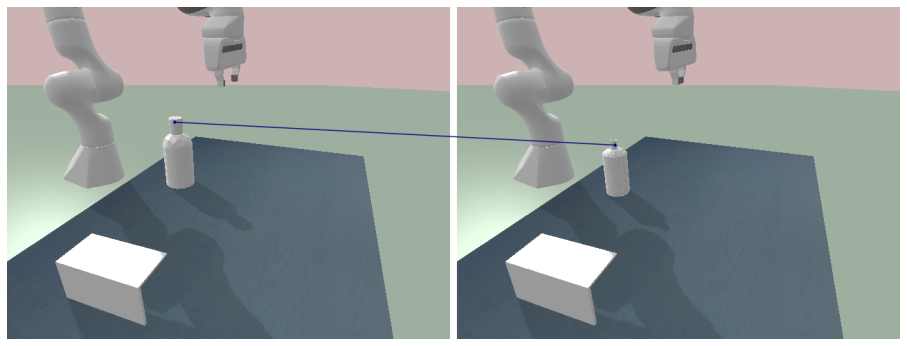

Saved!
Query image:  0020
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[244.525 173.   ]]


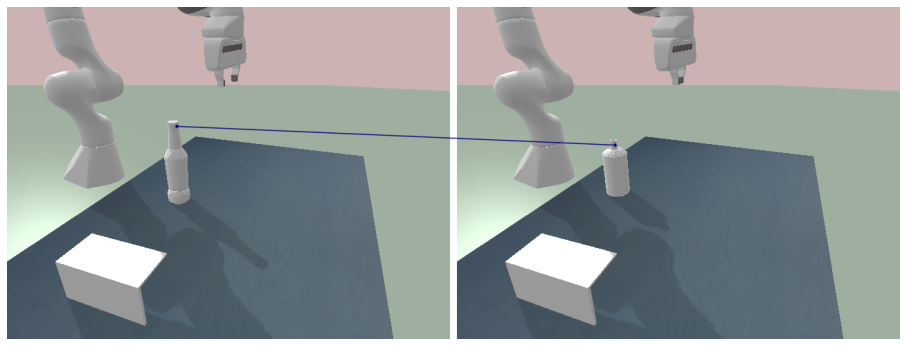

Saved!
Query image:  0022
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[227.36667 174.16667]]


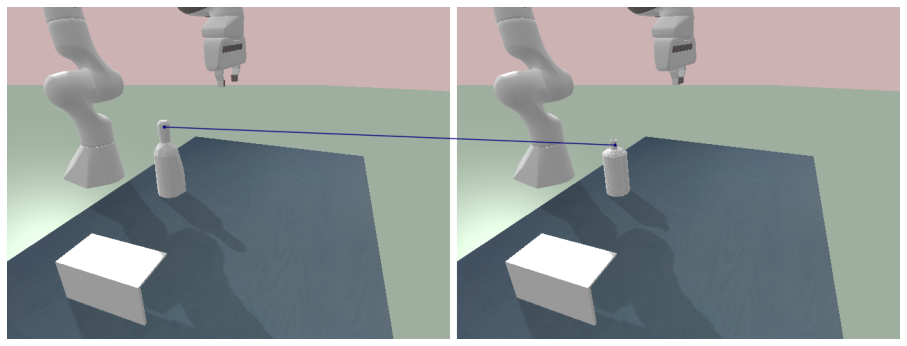

Saved!
Query image:  0017
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[224.26883 176.5    ]]


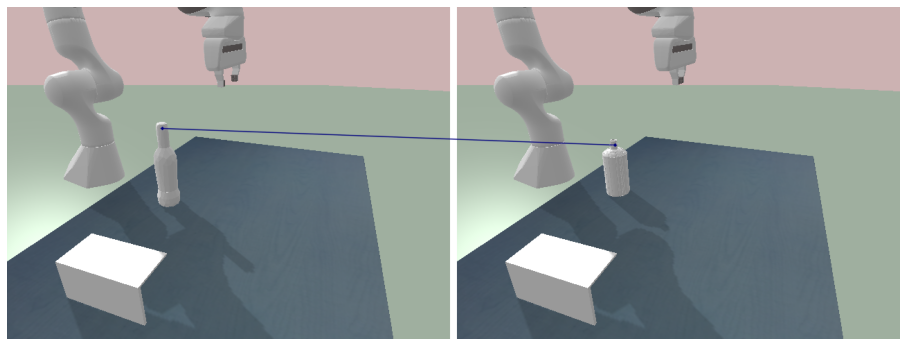

Saved!
Query image:  0014
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[231.6272 236.    ]]


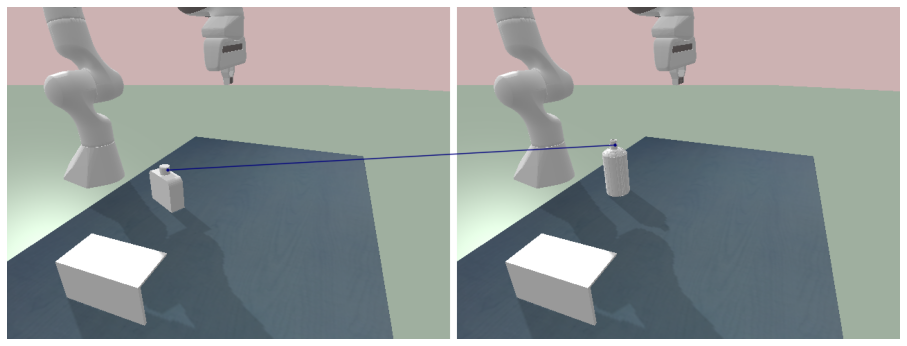

Saved!
Query image:  0023
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[235. 175.]]


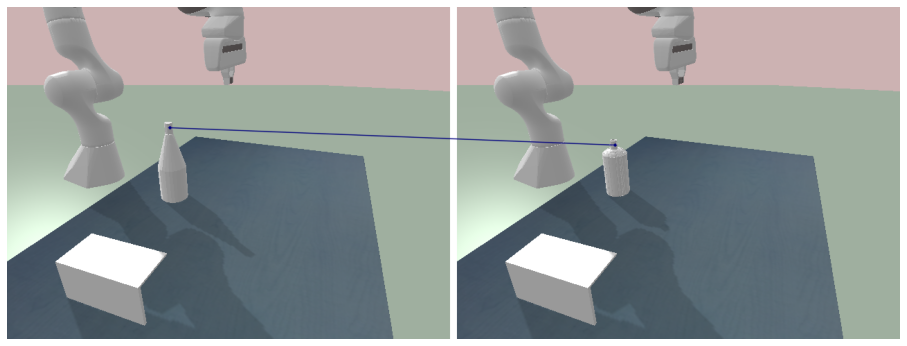

Saved!
Query image:  0004
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[246.917 178.   ]]


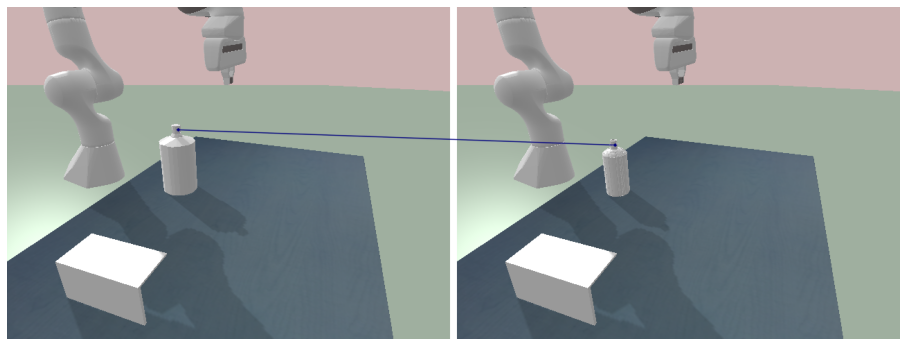

Saved!
Query image:  0026
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[211.41429 177.     ]]


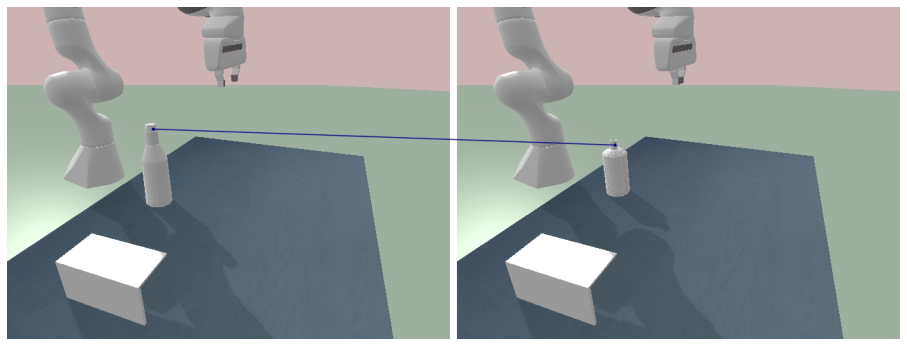

Saved!
Query image:  0008
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[246.61832 161.     ]]


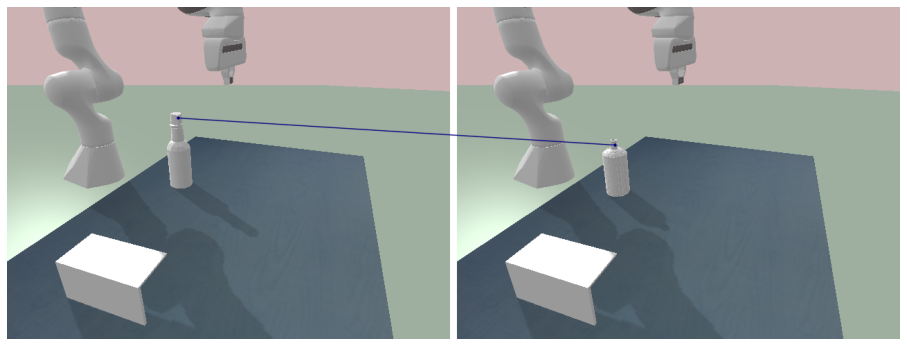

Saved!
Query image:  0027
Model: PWarpCSFNet_WS
Pre-trained-model: ndf_from_imagenet_pretrained_precrop
Query contact points [[236.69492 213.2    ]]


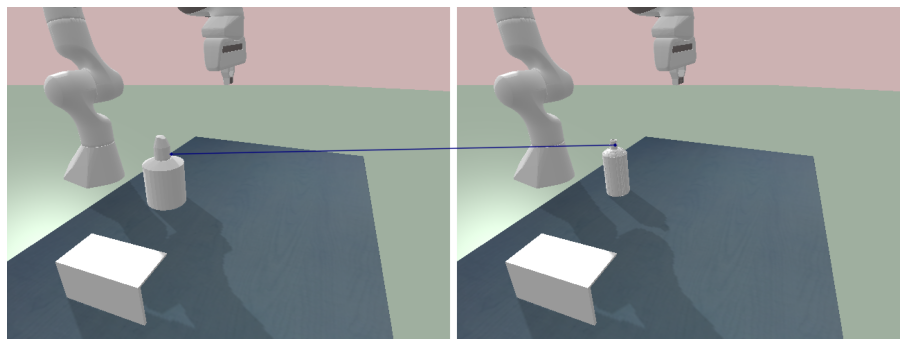

Saved!


In [6]:
pretrained = ['pfpascal']
pretrained += ['ndf_from_SS_pfpascal_cropped','ndf_from_WS_pfpascal_cropped','ndf_from_imagenet_pretrained_cropped']
# pretrained += ['ndf_from_SS_pfpascal','ndf_from_WS_pfpascal','ndf_from_imagenet_pretrained']
pretrained += ['ndf_from_SS_pfpascal_precrop','ndf_from_WS_pfpascal_precrop','ndf_from_imagenet_pretrained_precrop']


split = 'eval'
query_img_list = glob.glob(os.path.join(root_path,split,cls,f'????.png'))

for p in pretrained:
    args.pre_trained_model = p
    
    save_dir_new = os.path.join(save_dir,p)
    if not os.path.isdir(save_dir_new):
        os.mkdir(save_dir_new)

    for query_img_path in query_img_list:
        query_img_name = os.path.basename(query_img_path).split('.')[0]
        query_mask_path = query_img_path.replace('.png','_mask.png')
        print('Query image: ',query_img_name)

        query_img_mask = cv2.imread(query_mask_path,cv2.IMREAD_GRAYSCALE)
        query_img = cv2.imread(query_img_path, 1)[:, :, ::- 1]
        query_img_cropped, query_cropbox = crop_image_from_mask(query_img,query_img_mask)

        _,query_pts_cropped = test_model_on_image_pair(args, query_img_cropped, ref_img_cropped,
                                                       contact_pixels = ref_pts_cropped,visualize = False)
        query_contact_pts = np.copy(query_pts_cropped)
        query_contact_pts[:, 0] += query_cropbox[2]
        query_contact_pts[:, 1] += query_cropbox[0]

        print('Query contact points',query_contact_pts)

    #     fig = plt.figure(figsize=(16, 8))
    #     plt.imshow(query_img)
    #     plt.scatter(query_contact_pts[:,0],query_contact_pts[:,1],s = 10)
    #     plt.axis('off')
    #     plt.title('Query image and contact points')
    #     plt.show()

        confidence_values = np.ones(query_pts_cropped.shape[0])
        import matplotlib.cm as cm
        color = cm.jet(confidence_values)

        matching = make_sparse_matching_plot(
            query_img, ref_img, query_contact_pts, ref_contact_pts, color, margin=10)

        plt.figure(figsize=(16, 8))
        plt.imshow(matching)
        plt.axis('off')

        plt.savefig(os.path.join(save_dir_new,query_img_name + '_matching.png'))
        plt.show()

        query_info = dict()
        query_info['contact_pts'] = query_contact_pts
        save_path = os.path.join(save_dir_new,f'{query_img_name}_contact_pts.mat')
        sio.savemat(save_path, query_info)

        print('Saved!')
    
    